# This script will show the histograms of AUC for each TF in different states

In [54]:
%matplotlib inline

import pickle
import matplotlib.pyplot as plt
from matplotlib import colors
from mpl_toolkits.mplot3d import Axes3D
from functools import reduce
import numpy as np
import pandas as pd
import ipdb
import copy
plt.rcParams['figure.dpi'] = 150

In [2]:
p2AUC_dict = '/data/cima/AUC'

with open(p2AUC_dict, 'rb') as f:
    AUC_dict = pickle.load(f)
print(AUC_dict.keys())
AUC_dict[1]

dict_keys([0, 1, 2])


,ARID1A,SFPQ,YBX1,JUN,MIER1,PHTF1,POGZ,CREB3L4,PBX1,KDM5B,...,ZNF431,ZNF302,NFKBID,FOSB,ZNF581,ZNF814,XBP1,ATF4,PHF5A,RUNX1
young_AAACGGGAGGACTGGT_193,0.353732,0.343286,0.354316,0.355147,0.354635,0.349761,0.353842,0.349779,0.352858,0.355092,...,0.352238,0.351271,0.351664,0.355042,0.342496,0.348902,0.357952,0.343391,0.342883,0.344253
young_AAAGCAATCTCCAACC_193,0.352015,0.341904,0.352767,0.354166,0.352115,0.349067,0.352795,0.348676,0.351012,0.352338,...,0.350716,0.349043,0.350601,0.353913,0.341467,0.348474,0.357425,0.341555,0.340833,0.342988
young_AACACGTAGGTGACCA_193,0.356102,0.345867,0.355775,0.357208,0.356303,0.352920,0.356946,0.352070,0.354996,0.356727,...,0.355014,0.352711,0.354609,0.358234,0.344965,0.352866,0.361019,0.344992,0.345079,0.346932
young_AACTCAGAGGGCTTGA_193,0.354902,0.344513,0.354446,0.356004,0.354852,0.351369,0.355505,0.350785,0.353870,0.355226,...,0.353618,0.351637,0.353008,0.356668,0.343459,0.351327,0.359561,0.343801,0.343691,0.345477
young_AACTCTTTCCAGGGCT_193,0.356020,0.346254,0.356140,0.357700,0.356451,0.353877,0.357336,0.352640,0.355300,0.356886,...,0.355459,0.353221,0.355034,0.358729,0.345623,0.353502,0.361778,0.345589,0.345464,0.347181
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
mds1_TTTGCGCGTGCAACTT_mds,0.368368,0.361523,0.371731,0.372161,0.367435,0.367830,0.369101,0.365150,0.365302,0.370279,...,0.367793,0.365402,0.368349,0.371650,0.361149,0.363351,0.375791,0.359188,0.354594,0.362829
mds1_TTTGCGCGTTCTGGTA_mds,0.368298,0.361353,0.371926,0.372217,0.367474,0.367755,0.369110,0.365030,0.365340,0.370068,...,0.367669,0.365310,0.368598,0.371506,0.361186,0.363352,0.375731,0.359137,0.354484,0.362830
mds1_TTTGTCAAGTGCCATT_mds,0.367469,0.360293,0.371187,0.371502,0.366727,0.366843,0.368331,0.364145,0.364611,0.369068,...,0.366780,0.364482,0.367987,0.370540,0.360350,0.362611,0.374875,0.358239,0.353579,0.362004
mds1_TTTGTCAAGTTGAGTA_mds,0.367519,0.359962,0.371454,0.371671,0.366897,0.366672,0.368318,0.364045,0.364818,0.368787,...,0.366736,0.364513,0.368413,0.370452,0.360420,0.362713,0.374792,0.358308,0.353590,0.362234


In [3]:
print(AUC_dict[0].shape)
print(AUC_dict[1].shape)

(9663, 100)
(9663, 100)


In [4]:
p2assignment = '/data/cima/hsc_assignment'
assign_list = []
with open(p2assignment, 'r') as f:
    for line in f:
        assign_list.append(int(line))
print(len(assign_list))
print(set(assign_list))

9663
{0, 1, 2}


In [5]:
assign_list[:3]

[0, 0, 0]

In [6]:
for state in AUC_dict.keys():
    tmp_AUC = AUC_dict[state]
    tmp_AUC = tmp_AUC.iloc[[idx for idx, label in enumerate(assign_list) if label == state]]
    AUC_dict[state] = tmp_AUC

In [7]:
AUC_dict[0]

,ARID1A,SFPQ,YBX1,JUN,MIER1,PHTF1,POGZ,CREB3L4,PBX1,KDM5B,...,ZNF431,ZNF302,NFKBID,FOSB,ZNF581,ZNF814,XBP1,ATF4,PHF5A,RUNX1
young_AAACGGGAGGACTGGT_193,0.346480,0.340475,0.357071,0.355660,0.345553,0.347052,0.351987,0.346916,0.349910,0.348465,...,0.354435,0.343305,0.349828,0.349924,0.357561,0.346258,0.351649,0.353682,0.346334,0.353883
young_AAAGCAATCTCCAACC_193,0.345751,0.339547,0.356163,0.354771,0.344769,0.346378,0.351193,0.345330,0.348996,0.347487,...,0.352015,0.342751,0.347999,0.348235,0.356341,0.345150,0.350530,0.352012,0.345216,0.353526
young_AACACGTAGGTGACCA_193,0.349710,0.344589,0.360370,0.358942,0.347455,0.349895,0.355187,0.349739,0.353074,0.352046,...,0.356049,0.347132,0.351657,0.351749,0.360332,0.349360,0.354529,0.355845,0.349180,0.357236
young_AACTCAGAGGGCTTGA_193,0.348023,0.342601,0.358728,0.357282,0.346404,0.348343,0.353671,0.348298,0.351325,0.350380,...,0.354837,0.345615,0.350353,0.350624,0.358776,0.347856,0.353180,0.354307,0.347657,0.355891
young_AACTCTTTCCAGGGCT_193,0.350728,0.345544,0.361185,0.359518,0.348401,0.350804,0.355925,0.350412,0.353975,0.352876,...,0.356602,0.347964,0.352114,0.352181,0.360940,0.349772,0.355367,0.356269,0.349823,0.357798
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
young_TTTACTGTCTCGATGA_196,0.356706,0.351155,0.366522,0.363770,0.353568,0.355795,0.360528,0.355677,0.359322,0.357909,...,0.360923,0.353353,0.356088,0.356533,0.364915,0.354158,0.360633,0.360230,0.354510,0.362533
young_TTTATGCAGAGCTTCT_196,0.363021,0.358467,0.372470,0.370852,0.358640,0.362996,0.366078,0.360892,0.365761,0.363937,...,0.365852,0.359808,0.362280,0.362051,0.371277,0.360950,0.366000,0.367103,0.360236,0.368118
young_TTTATGCGTTAGATGA_196,0.361173,0.356549,0.370785,0.368506,0.356902,0.360573,0.364611,0.359394,0.363977,0.362287,...,0.364509,0.357966,0.360362,0.360429,0.369407,0.358839,0.364338,0.364899,0.358542,0.366274
young_TTTGCGCGTATATGAG_196,0.361681,0.357139,0.371286,0.369007,0.357302,0.361117,0.365099,0.359848,0.364508,0.362791,...,0.364920,0.358453,0.360865,0.360901,0.369934,0.359360,0.364787,0.365456,0.359061,0.366722


In [8]:
AUC_dict[1]

,ARID1A,SFPQ,YBX1,JUN,MIER1,PHTF1,POGZ,CREB3L4,PBX1,KDM5B,...,ZNF431,ZNF302,NFKBID,FOSB,ZNF581,ZNF814,XBP1,ATF4,PHF5A,RUNX1
senior_AAACCTGGTAGAGGAA_S1,0.354665,0.346791,0.358346,0.359697,0.356639,0.357756,0.358535,0.354884,0.356530,0.357971,...,0.355578,0.356935,0.355054,0.357691,0.347724,0.353513,0.361289,0.348436,0.347353,0.348387
senior_AAACCTGGTAGGACAC_S1,0.356399,0.347213,0.357167,0.359517,0.355490,0.356052,0.358331,0.353941,0.356875,0.355808,...,0.356218,0.355896,0.355274,0.358307,0.347322,0.354219,0.362111,0.347729,0.345490,0.347835
senior_AAACGGGGTAATCGTC_S1,0.357895,0.348903,0.358745,0.361077,0.356967,0.358089,0.360075,0.355672,0.358660,0.357360,...,0.357911,0.357706,0.356978,0.359930,0.349196,0.356055,0.363628,0.349621,0.347112,0.349616
senior_AAAGATGGTGTCCTCT_S1,0.358441,0.349558,0.359354,0.361530,0.357428,0.358832,0.360715,0.356316,0.359279,0.357873,...,0.358597,0.358310,0.357435,0.360533,0.349878,0.356621,0.364089,0.350449,0.347663,0.350237
senior_AAAGCAAAGCTTTGGT_S1,0.356903,0.348592,0.358805,0.361047,0.357149,0.358452,0.360081,0.355795,0.358220,0.357933,...,0.357521,0.358022,0.356521,0.359528,0.349239,0.355803,0.363394,0.349550,0.347578,0.349488
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
senior_GACAGAGTCTTGAGGT_S2,0.360527,0.351094,0.362994,0.363128,0.363425,0.357452,0.360286,0.358483,0.359263,0.363037,...,0.359908,0.359182,0.357753,0.361115,0.350790,0.354358,0.363544,0.352033,0.351082,0.352130
senior_ATCCGAATCGTCGTTC_S2,0.358445,0.348945,0.360002,0.360596,0.360354,0.354557,0.357949,0.355439,0.357218,0.360020,...,0.357492,0.356724,0.355371,0.358931,0.348023,0.352176,0.361674,0.349393,0.347828,0.349013
senior_CCTACCAGTACCTACA_S2,0.355465,0.344931,0.356493,0.356799,0.356055,0.351227,0.354990,0.351242,0.353958,0.356165,...,0.353624,0.352876,0.352433,0.355888,0.344410,0.349813,0.359407,0.345155,0.344226,0.345572
senior_CCATTCGCAGGCTCAC_S2,0.358990,0.349638,0.361285,0.360208,0.361349,0.356388,0.359646,0.357066,0.357608,0.360286,...,0.358286,0.357757,0.355522,0.360284,0.348541,0.352748,0.361976,0.350450,0.348883,0.351206


In [9]:
AUC_dict[2]

,ARID1A,SFPQ,YBX1,JUN,MIER1,PHTF1,POGZ,CREB3L4,PBX1,KDM5B,...,ZNF431,ZNF302,NFKBID,FOSB,ZNF581,ZNF814,XBP1,ATF4,PHF5A,RUNX1
mds1_AAACGGGAGGCCCGTT_mds,0.371756,0.365767,0.369090,0.362634,0.365074,0.367313,0.369282,0.369203,0.370356,0.369060,...,0.369145,0.357204,0.364467,0.375281,0.368870,0.366812,0.373419,0.365086,0.375926,0.371829
mds1_AAACGGGGTGAGCGAT_mds,0.370935,0.365050,0.368295,0.361824,0.364228,0.366587,0.368531,0.368439,0.369616,0.368256,...,0.368382,0.356451,0.363497,0.374548,0.368124,0.366071,0.372478,0.364283,0.375138,0.370963
mds1_AAACGGGTCAGCTCGG_mds,0.372429,0.365974,0.369723,0.363320,0.365800,0.367554,0.369734,0.369736,0.370668,0.369427,...,0.369499,0.357767,0.365137,0.375608,0.369327,0.367203,0.374320,0.365568,0.376341,0.372521
mds1_AAACGGGTCAGTTGAC_mds,0.372152,0.365073,0.369222,0.363096,0.365481,0.366511,0.369097,0.369169,0.369832,0.368545,...,0.368601,0.357222,0.364548,0.374819,0.368588,0.366518,0.374108,0.364798,0.375556,0.372123
mds1_AAAGATGAGGAATGGA_mds,0.372500,0.366006,0.369786,0.363420,0.365880,0.367581,0.369794,0.369794,0.370702,0.369473,...,0.369543,0.357830,0.365226,0.375657,0.369376,0.367269,0.374436,0.365634,0.376390,0.372596
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
mds1_TTTGCGCGTGCAACTT_mds,0.372410,0.365972,0.369709,0.363303,0.365765,0.367542,0.369710,0.369721,0.370661,0.369418,...,0.369483,0.357740,0.365110,0.375591,0.369310,0.367188,0.374304,0.365558,0.376329,0.372495
mds1_TTTGCGCGTTCTGGTA_mds,0.372656,0.365741,0.369790,0.363529,0.366022,0.367200,0.369703,0.369723,0.370506,0.369206,...,0.369278,0.357735,0.365223,0.375448,0.369212,0.367157,0.374617,0.365472,0.376203,0.372696
mds1_TTTGTCAAGTGCCATT_mds,0.372089,0.364637,0.368929,0.363084,0.365406,0.365981,0.368830,0.368951,0.369473,0.368088,...,0.368203,0.357074,0.364295,0.374491,0.368286,0.366372,0.374015,0.364467,0.375187,0.372024
mds1_TTTGTCAAGTTGAGTA_mds,0.372489,0.364454,0.369047,0.363528,0.365836,0.365456,0.368812,0.369083,0.369392,0.367727,...,0.367941,0.357359,0.364438,0.374343,0.368161,0.366411,0.374514,0.364293,0.374966,0.372470


------
# Compute histogram of AUC for all TFs

In [10]:
def separate_state(AUC_dict):
    for state in AUC_dict.keys():
        tmp_AUC = AUC_dict[state]
        tmp_AUC = tmp_AUC.iloc[[idx for idx, label in enumerate(assign_list) if label == state]]
        AUC_dict[state] = tmp_AUC
    return AUC_dict

In [11]:
def compute_hist(AUC_dict, num_TF = 200):
    x_min = np.ones(num_TF)
    x_max = -1 * np.ones(num_TF)
    # find min and max of AUC values in all states.
    for label in AUC_dict:
        min_AUC = AUC_dict[label].min(axis = 0)
        max_AUC = AUC_dict[label].max(axis = 0)
        x_min = np.minimum(min_AUC, x_min)
        x_max = np.maximum(max_AUC, x_max)

    i = 5
    TF_hist_dict = {}
    for idx, TF in enumerate(AUC_dict[1].columns):    
    #     i -= 1
        cap_TF = TF.capitalize()
        TF_hist_dict[cap_TF] = {}
        nbins = 50
        bar_width =  (-x_min[idx] + x_max[idx]) / nbins
        bin_list = np.arange(x_min[idx], x_max[idx] + bar_width, bar_width)


        label_order = sorted(list(AUC_dict.keys()))

        for label in label_order:
            AUC_df = AUC_dict[label]      
            y = AUC_df[TF].values.tolist()

            hist, _ = np.histogram(y, bins = bin_list,
                                  weights=np.ones(len(y)) / len(y))

            xs = (bin_list[:-1] + bin_list[1:])/2
            legend_name = 'state {}'.format(label)

            TF_hist_dict[cap_TF][label] = {
                'hist': hist,
                'xs': xs
            }
        if i < 0:
            break
    return TF_hist_dict

def compute_hist_mat(TF_hist_dict):
    TF_hist_mat_dict = {}
    num_of_TF = len(TF_hist_dict)
    for TF in TF_hist_dict:
        num_of_bins = len(TF_hist_dict[TF][1]['hist'])
        num_of_labels = len(TF_hist_dict[TF])
        tmp_hist_mat = np.zeros((num_of_labels, num_of_bins))
        for row_idx, label in enumerate(TF_hist_dict[TF]):
            tmp_row = TF_hist_dict[TF][label]['hist']
            tmp_hist_mat[row_idx, :] = tmp_row
        TF_hist_mat_dict[TF] = tmp_hist_mat
    return TF_hist_mat_dict
        
def get_hist_mat_dict(p2AUC_dict, num_TF = 200):
    with open(p2AUC_dict, 'rb') as f:
        AUC_dict = pickle.load(f)
    AUC_dict = separate_state(AUC_dict)
    TF_hist_dict = compute_hist(AUC_dict, num_TF)
    TF_hist_mat_dict = compute_hist_mat(TF_hist_dict)
    return TF_hist_mat_dict, TF_hist_dict

In [13]:
TF_hist_mat_dict_simic, TF_hist_dict_simic = get_hist_mat_dict(p2AUC_dict, num_TF = 100)
# TF_hist_mat_dict_no_simic, TF_hist_dict_no_simic = get_hist_mat_dict(p2AUC_dict_no_simic)
len(TF_hist_mat_dict_simic)

100

------
# Compute the total variant of histograms

In [14]:
def total_variant(dist1, dist2):
    abs_diff = np.abs(np.array(dist1) - np.array(dist2))
    TV = 1/2 * np.sum(abs_diff)
    return TV

def aver_TV_of_hist(hist_mat):
    '''
    hist_mat: num_labels * len_of_hist
    '''
    num_labels, _ = hist_mat.shape
    count_of_TVs = num_labels * (num_labels - 1)
    sum_of_TVs = 0
    for row_idx in range(num_labels):
        remaining_rows = np.delete(np.arange(num_labels), row_idx)
        row_1 = hist_mat[row_idx, :]
        for row_2_idx in remaining_rows:
            row_2 = hist_mat[row_2_idx, :]
            sum_of_TVs += total_variant(row_1, row_2)
    average_TV = sum_of_TVs / count_of_TVs
    return average_TV
    
def list_of_TV_of_hist(hist_mat):
    '''
    hist_mat: num_labels * len_of_hist
    '''
    num_labels, _ = hist_mat.shape
    count_of_TVs = num_labels * (num_labels - 1)
    list_of_TVs = []
    for row_idx in range(num_labels):
        remaining_rows = range(row_idx + 1, num_labels)
        row_1 = hist_mat[row_idx, :]
        for row_2_idx in remaining_rows:
            row_2 = hist_mat[row_2_idx, :]
            tmp_TV = total_variant(row_1, row_2)
            list_of_TVs.append(tmp_TV)
    return list_of_TVs

def minmax_variant_of_hist(hist_mat):
    max_hist = np.max(hist_mat, axis = 0)
    min_hist = np.min(hist_mat, axis = 0)
    minmax_diff = max_hist - min_hist
    variant = np.sum(np.abs(minmax_diff)) / hist_mat.shape[0]
    
    return variant

In [15]:
def get_divergence_df(TF_hist_mat_dict):
    hist_divergence_df = pd.DataFrame(columns = TF_hist_mat_dict.keys(), 
                                      index = ['average TV', 'median TV', 'max TV', 'minmax variant'])
    for TF in TF_hist_mat_dict.keys():
        tmp_hist_mat = TF_hist_mat_dict[TF]
        tf_aver_TV = aver_TV_of_hist(tmp_hist_mat)
        hist_divergence_df[TF]['average TV'] = tf_aver_TV

        TV_list = list_of_TV_of_hist(tmp_hist_mat)

        tf_median_TV = np.median(TV_list)
        hist_divergence_df[TF]['median TV'] = tf_median_TV

        tf_max_TV = np.max(TV_list)
        hist_divergence_df[TF]['max TV'] = tf_max_TV

        tf_minmax_variant = minmax_variant_of_hist(tmp_hist_mat)
        hist_divergence_df[TF]['minmax variant'] = tf_minmax_variant
    return hist_divergence_df

def get_TF_list_intersection(hist_divergence_df, k):
    sorted_by_ave_hist_divergence_df = hist_divergence_df.sort_values(by = 'average TV', axis = 1, ascending = False)
    sorted_by_med_hist_divergence_df = hist_divergence_df.sort_values(by = 'median TV', axis = 1, ascending = False)
    sorted_by_max_hist_divergence_df = hist_divergence_df.sort_values(by = 'max TV', axis = 1, ascending = False)
    sorted_by_minmax_var_divergence_df = hist_divergence_df.sort_values(by = 'minmax variant', axis = 1, ascending = False)
        
    top_k_minmax_TF = sorted_by_minmax_var_divergence_df.columns.values[:k]
    last_k_minmax_TF = sorted_by_minmax_var_divergence_df.columns.values[-k:]

    top_k_max_TF = sorted_by_max_hist_divergence_df.columns.values[:k]
    last_k_max_TF = sorted_by_max_hist_divergence_df.columns.values[-k:]

    top_k_median_TF = sorted_by_med_hist_divergence_df.columns.values[:k]
    last_k_median_TF = sorted_by_med_hist_divergence_df.columns.values[-k:]

    top_k_average_TF = sorted_by_ave_hist_divergence_df.columns.values[:k]
    last_k_average_TF = sorted_by_ave_hist_divergence_df.columns.values[-k:]

    top_d = (top_k_minmax_TF, top_k_max_TF, top_k_median_TF, top_k_average_TF)
    top_variant_TF = set.intersection(*map(set,top_d))

    last_d = (last_k_minmax_TF, last_k_max_TF, last_k_median_TF, last_k_average_TF)
    last_variant_TF = set.intersection(*map(set, last_d))
    
    return top_variant_TF, last_variant_TF

In [22]:
k = 50

diver_df_simic = get_divergence_df(TF_hist_mat_dict_simic)
top_variant_TF, last_variant_TF = get_TF_list_intersection(diver_df_simic, k)

# diver_df_no_simic = get_divergence_df(TF_hist_mat_dict_no_simic)
# top_TF_no_simic, last_TF_no_simic = get_TF_list_intersection(diver_df_no_simic, k)

# # find the common and difference among sets.
# common_top = top_TF_simic.intersection(top_TF_no_simic)
# common_last = last_TF_simic.intersection(last_TF_no_simic)

# top_only_simic = top_TF_simic.difference(common_top)
# top_only_no_simic = top_TF_no_simic.difference(common_top)

# last_only_simic = last_TF_simic.difference(common_last)
# last_only_no_simic = last_TF_no_simic.difference(common_last)

# top_simic_last_no_simic = top_TF_simic.intersection(last_TF_no_simic)
# last_simic_top_no_simic = last_TF_simic.intersection(top_TF_no_simic)

# print('common top in simic and no-simic: ', len(common_top))
# print(common_top)
# print('- ' * 7)

# print('common last in simic and no-simic: ', len(common_last))
# print(common_last)
# print('- ' * 7)

# print()
# print('>>' * 7, 'simic', '>>' * 7)
# print('top only in simic: ', len(top_only_simic))
# print(top_only_simic)
# print('- ' * 7)

# print('last only in simic: ', len(last_only_simic))
# print(last_only_simic)
# print('- ' * 7)

# print()
# print('>>' * 7, 'no-simic', '>>' * 7)
# print('top only in no-simic: ', len(top_only_no_simic))
# print(top_only_no_simic)
# print('- ' * 7)

# print('last only in no-simic: ', len(last_only_no_simic))
# print(last_only_no_simic)
# print('- ' * 7)

# print()
# print('>>' * 7, 'contradicting cases', '>>' * 7)
# print('top in simic, but last in no-simic: ', len(top_simic_last_no_simic))
# print(top_simic_last_no_simic)
# print('- ' * 7)

# print('last in simic, but top in no-simic: ', len(last_simic_top_no_simic))
# print(last_simic_top_no_simic)
# print('- ' * 7)

In [24]:
print(top_variant_TF)
print(len(top_variant_TF))
print(last_variant_TF)
print(len(last_variant_TF))

{'Phtf1', 'Znf581', 'Kmt2a', 'Bbx', 'Hmg20b', 'Irf1', 'Pbx1', 'Tcf25', 'Atrx', 'Kat6b', 'Elf1', 'Sfpq', 'Arid5b', 'Arid1a', 'Dnmt1', 'Phf5a', 'Rel', 'Klf10', 'Xbp1', 'Fosb', 'Creb3l4', 'Klf2', 'Sox4', 'Rest', 'Cdc5l', 'Dnmt3a', 'Cux1', 'Runx1', 'Zc3h8', 'Irf5', 'Csrnp1', 'Znf33a'}
32
{'Atf1', 'Tcf3', 'Hmga1', 'Tfam', 'Klf6', 'Max', 'Nr4a3', 'Cnot4', 'Jun', 'Zbtb44', 'Mlxip', 'Creb3l2', 'Znf521', 'Etv6', 'Fos', 'Tox4', 'Tfdp2', 'Lrrfip1', 'Lrrfip2', 'Nfkbid', 'Atf3', 'Bcl11a', 'Znf302', 'Rfxank', 'Ybx1', 'Id1', 'Smarce1', 'Sp100', 'Zbed3', 'Tsc22d1', 'Zeb2', 'Znf22', 'Znf562', 'Znf90', 'Klf4'}
35


------
# Most Variant TFs

In [33]:
def plot_histogram(TF_hist_dict, TF_list):
    plt.rcParams['figure.dpi'] = 150
    for idx,TF in enumerate(TF_list):    
        fig = plt.figure()
        TF = TF.capitalize()
        ax = fig.add_subplot(111, projection='3d')
        label_order = sorted(list(TF_hist_dict[TF].keys()))


        for label in label_order:
            xs = TF_hist_dict[TF][label]['xs']
            hist = TF_hist_dict[TF][label]['hist']
            nbins = len(xs)
            bar_width =  (xs[-1] - xs[0]) / nbins

            try:
                ax.bar(xs, hist, zs = label, 
                       zdir = 'y',
                       width = bar_width,
                       alpha = 0.8,
                      )
            except:
                print('error in ax.bar')
                continue

        print(TF)
        ax.set_xlabel('AUC')
        ax.set_ylabel('cell states')
        ax.set_yticks(label_order)
        ax.set_title('Histogram of TF {}'.format(TF))
        plt.show()
    

Phtf1


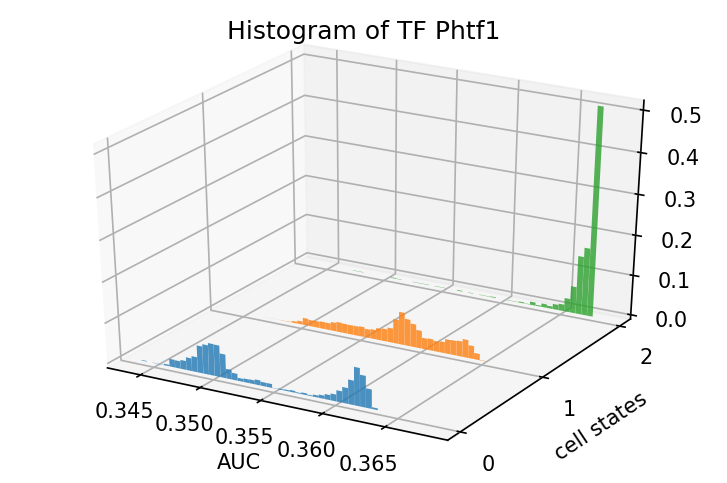

Znf581


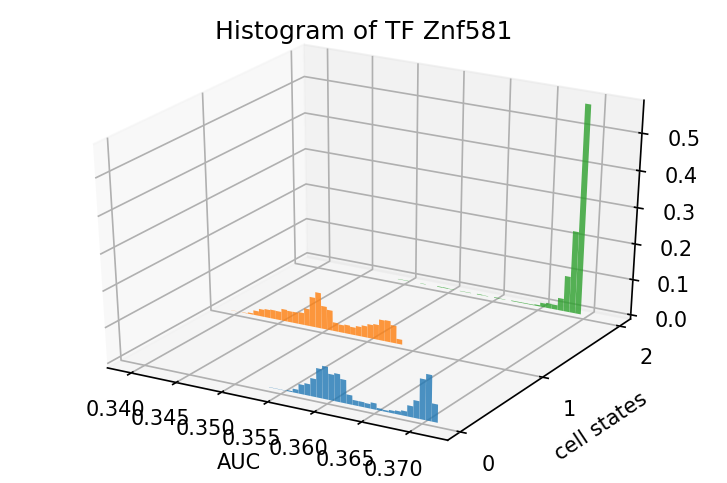

Kmt2a


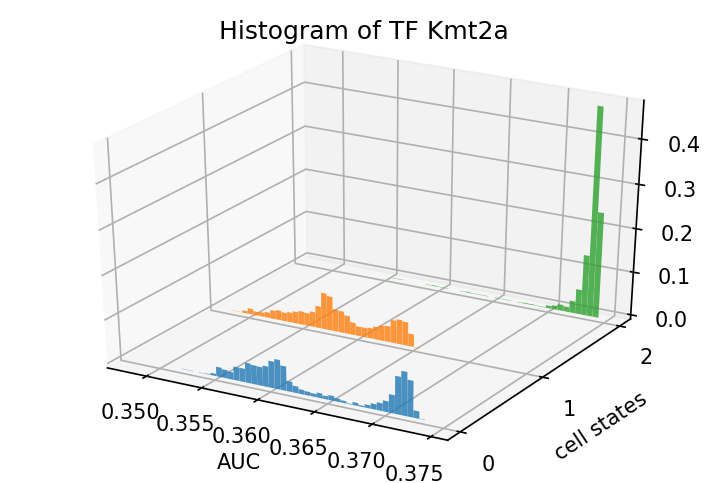

Bbx


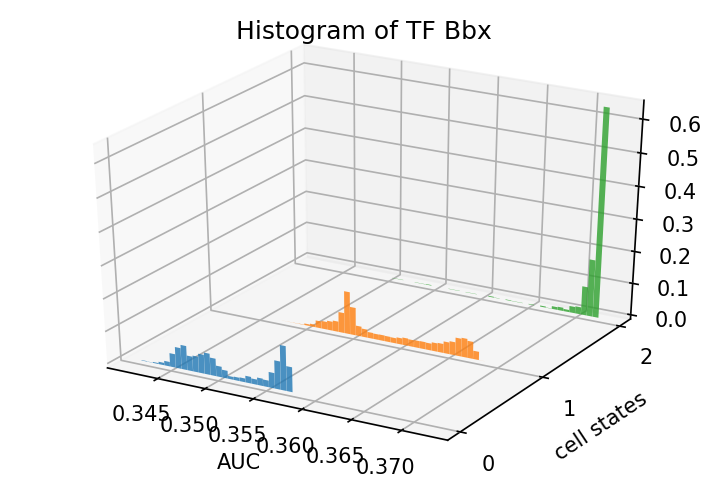

Hmg20b


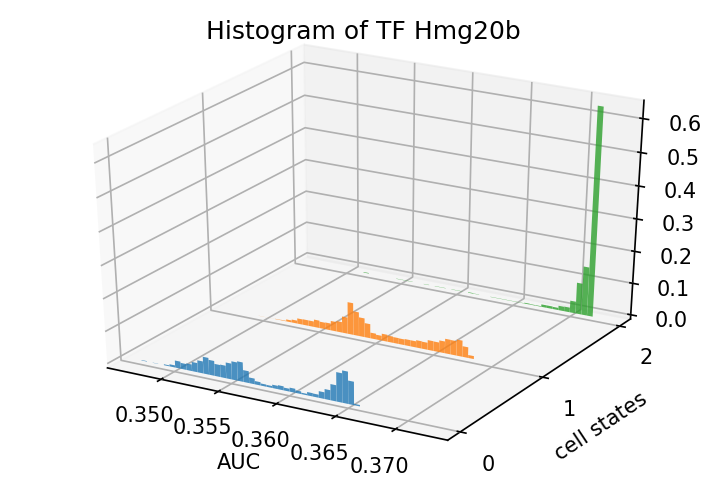

Irf1


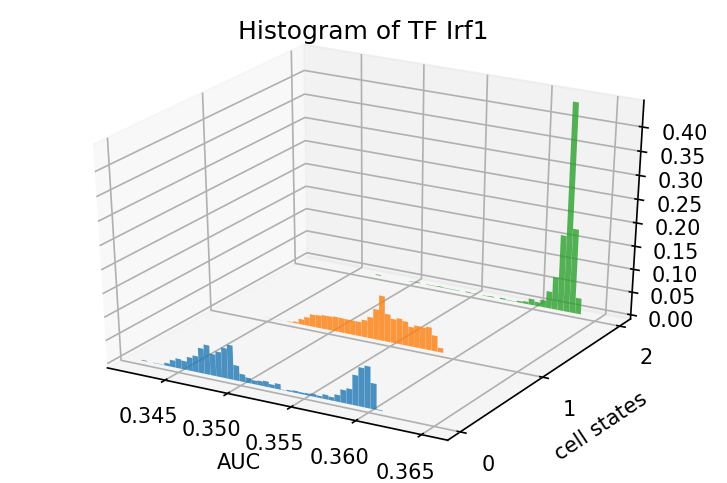

Pbx1


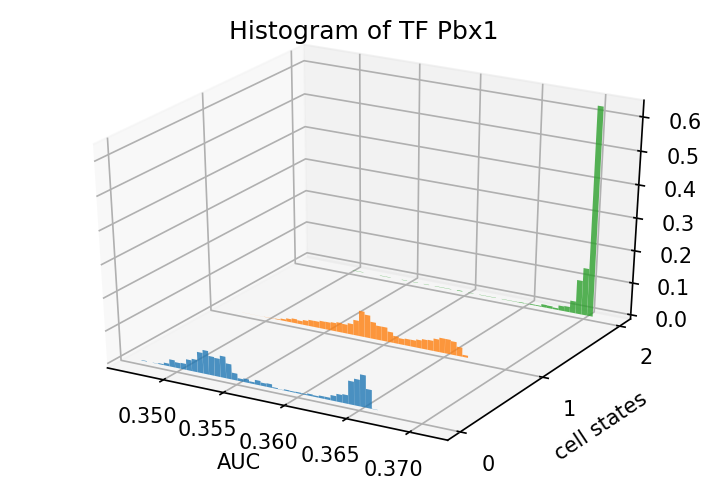

Tcf25


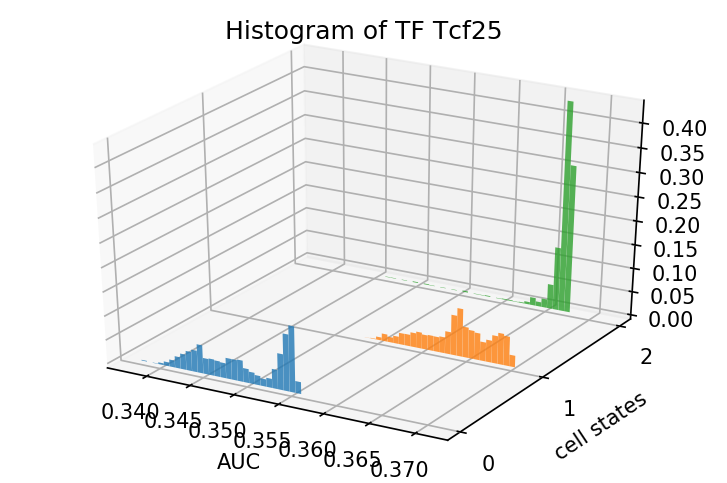

Atrx


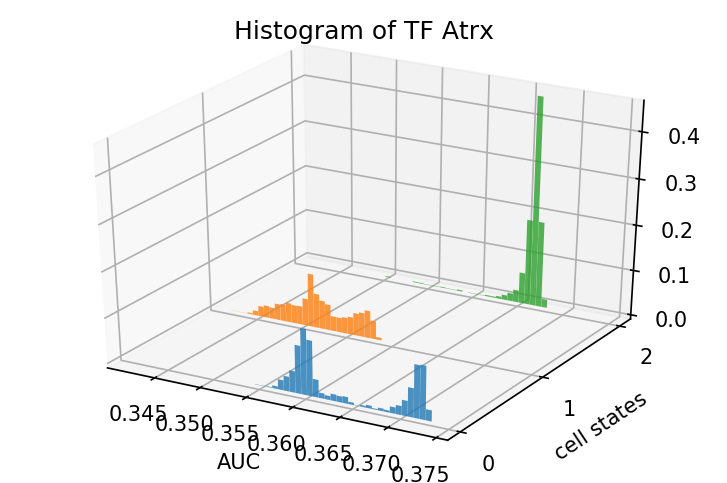

Kat6b


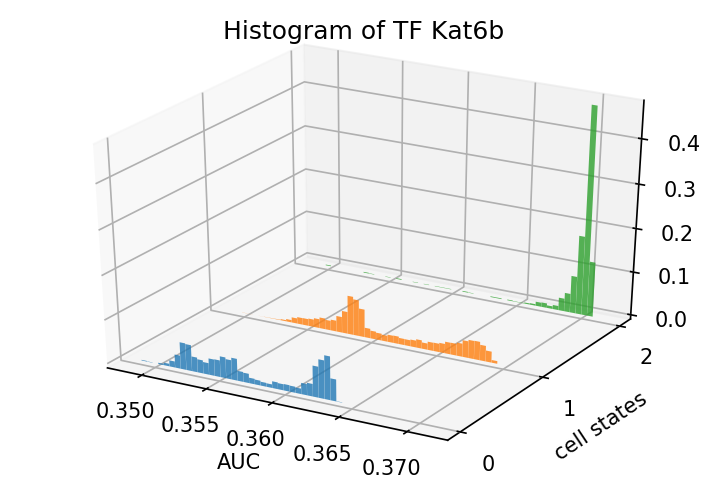

Elf1


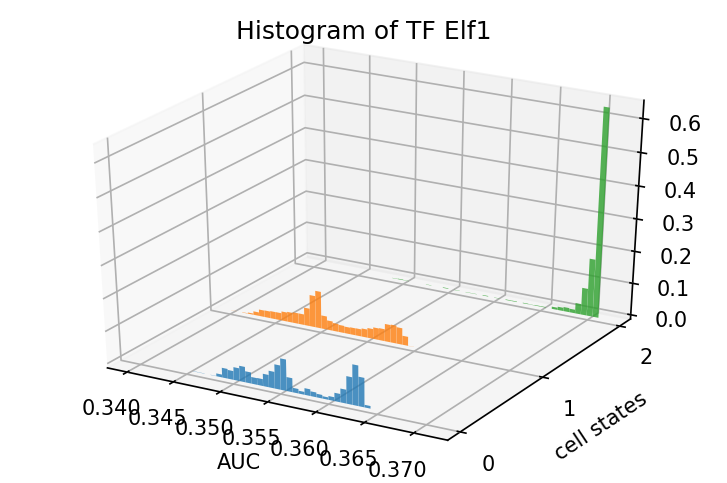

Sfpq


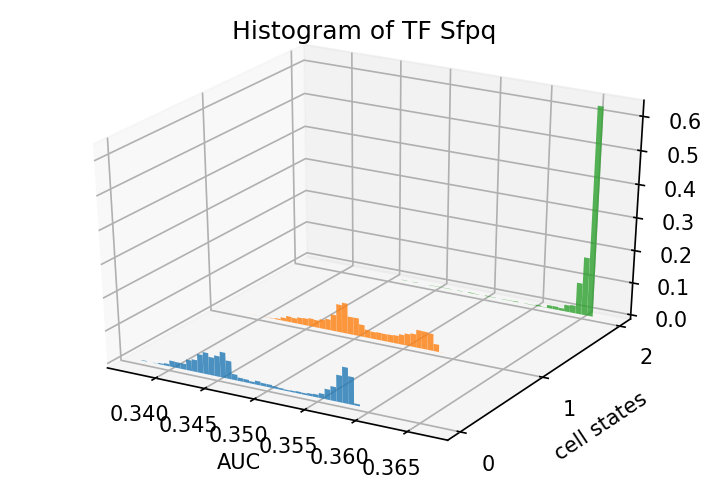

Arid5b


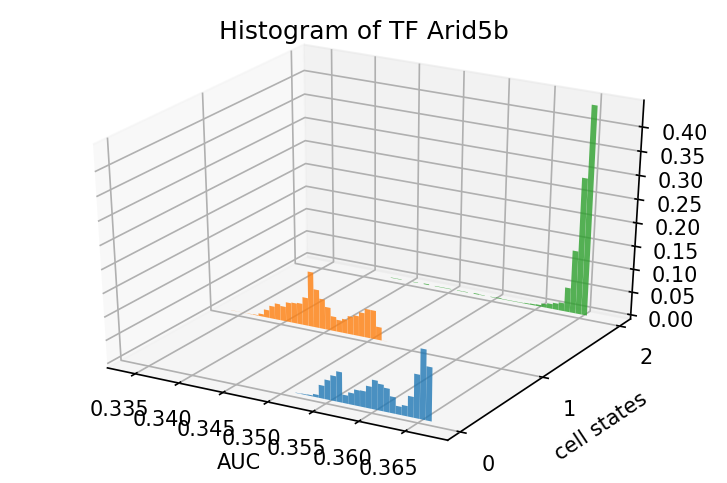

Arid1a


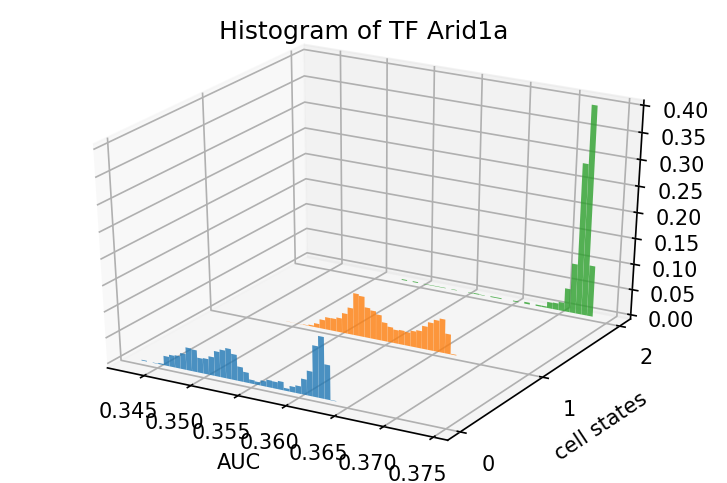

Dnmt1


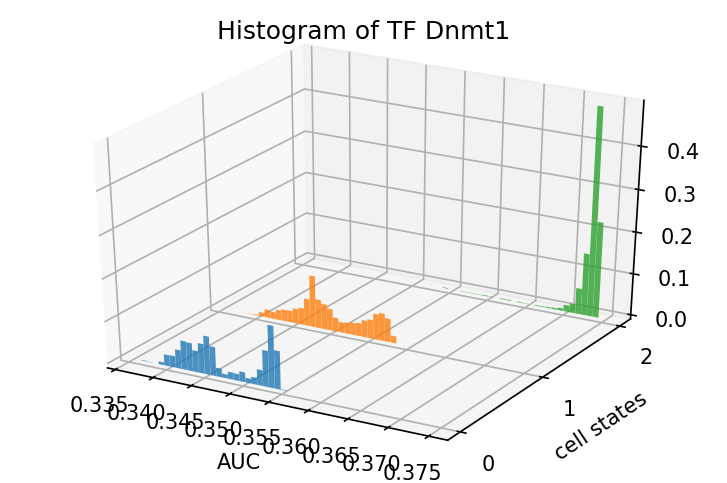

Phf5a


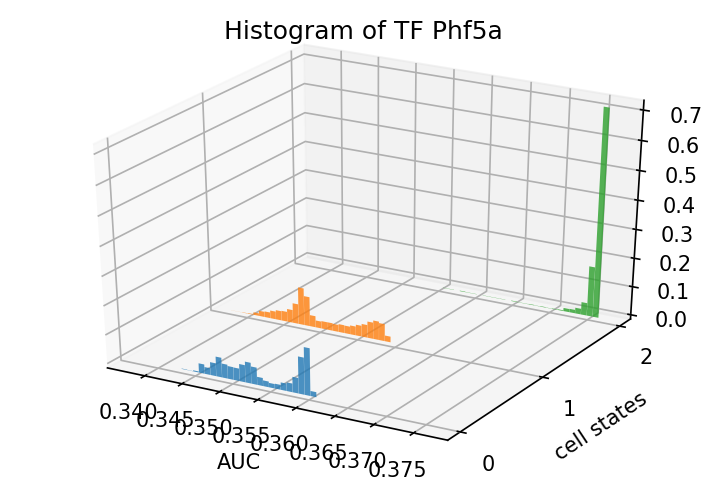

Rel


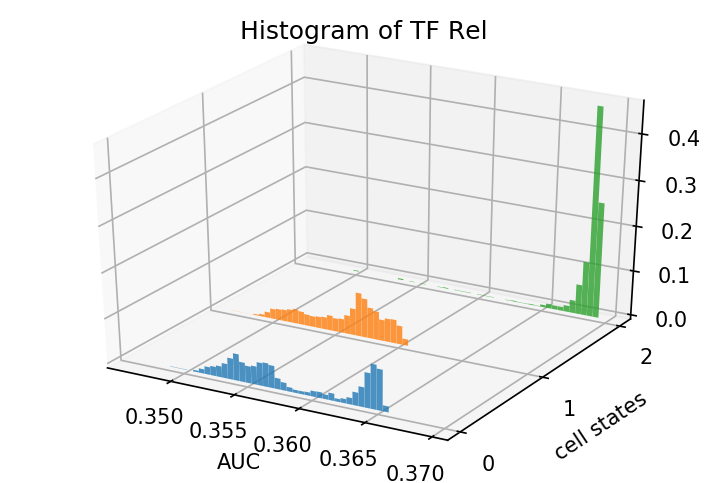

Klf10


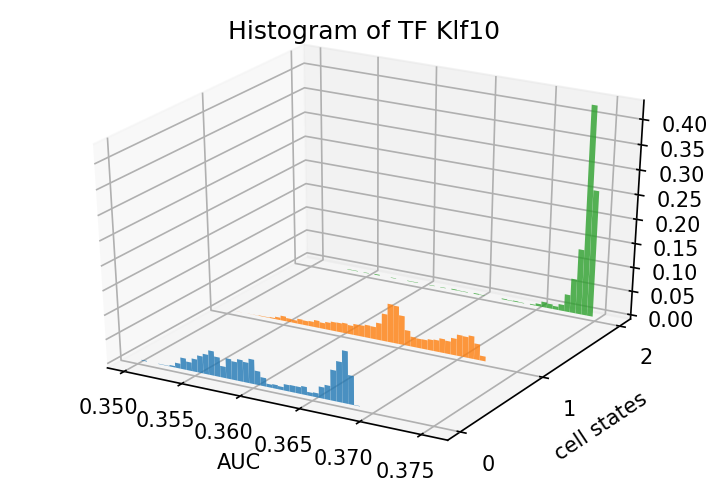

Xbp1


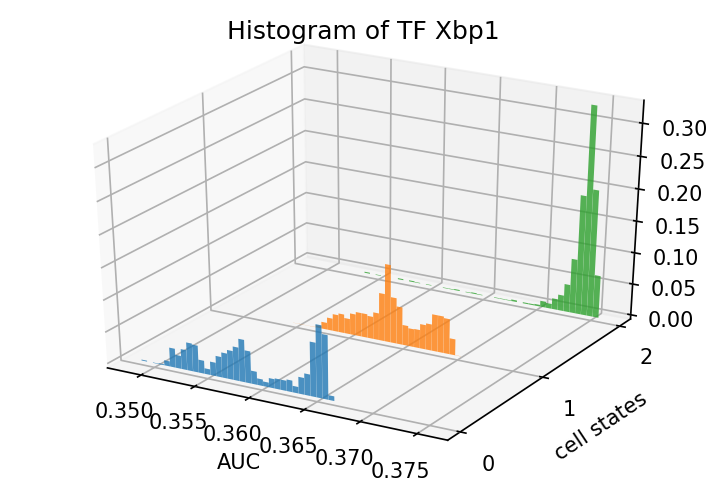

Fosb


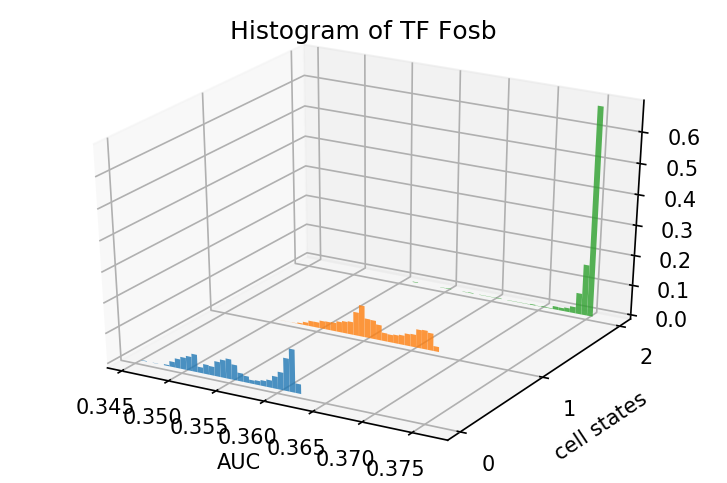

Creb3l4


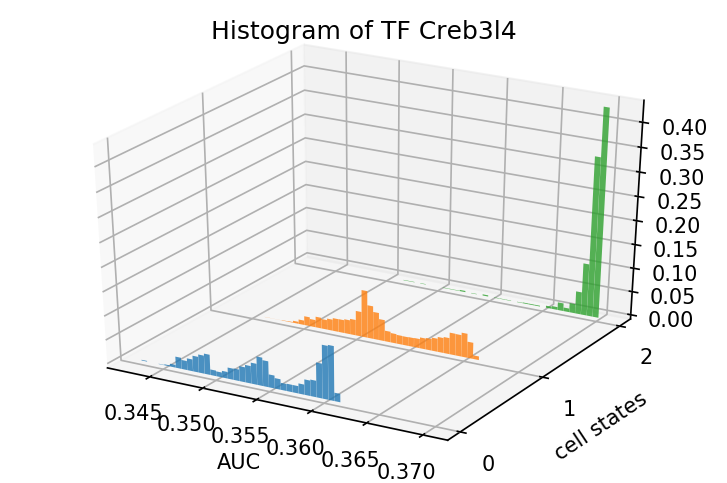

Klf2


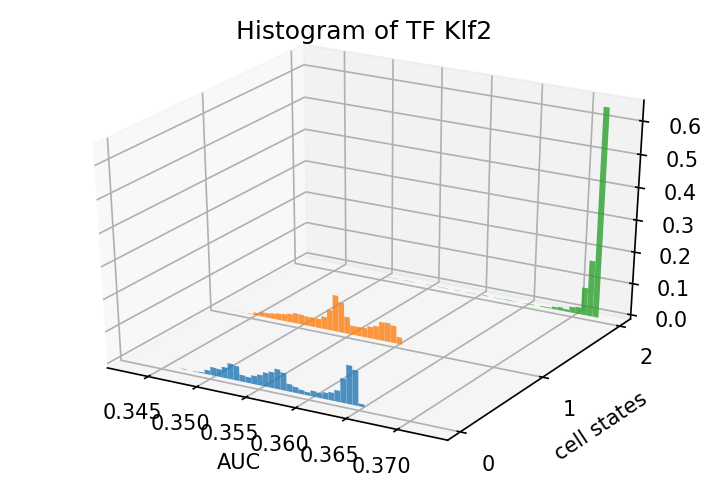

Sox4


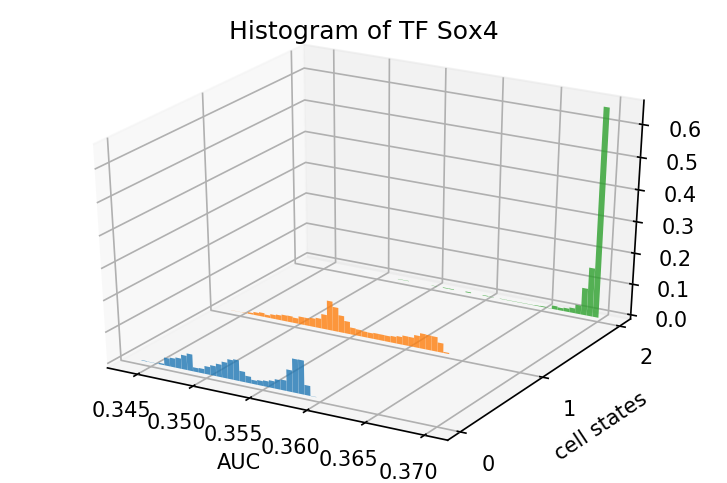

Rest


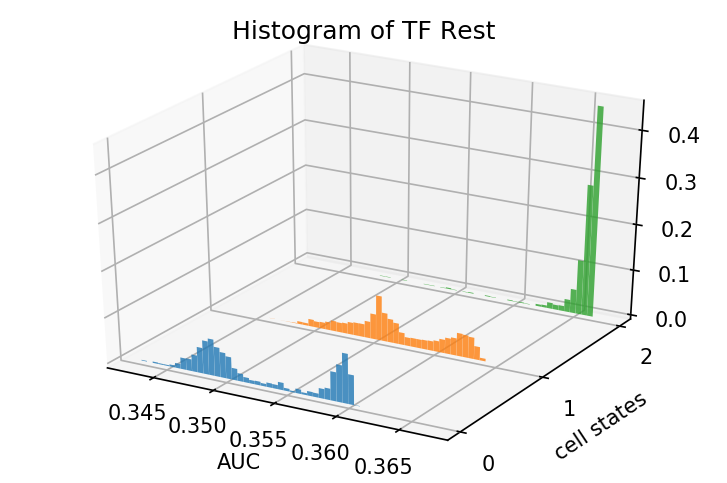

Cdc5l


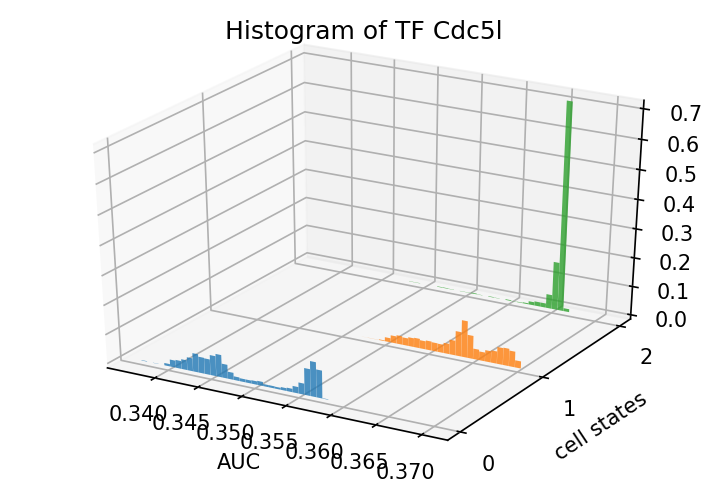

Dnmt3a


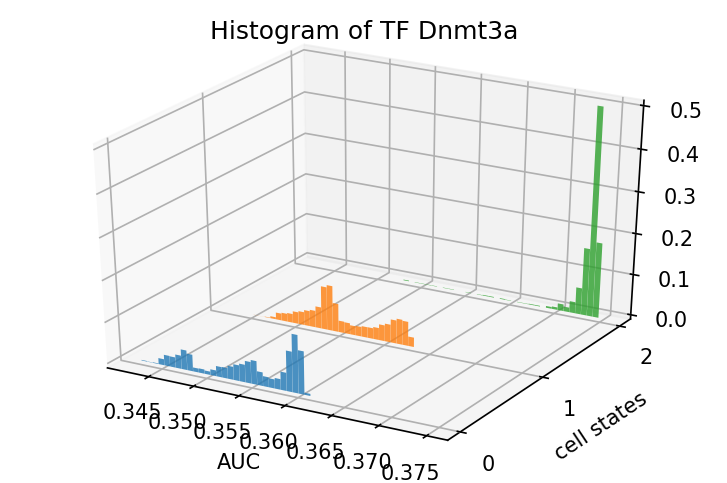

Cux1


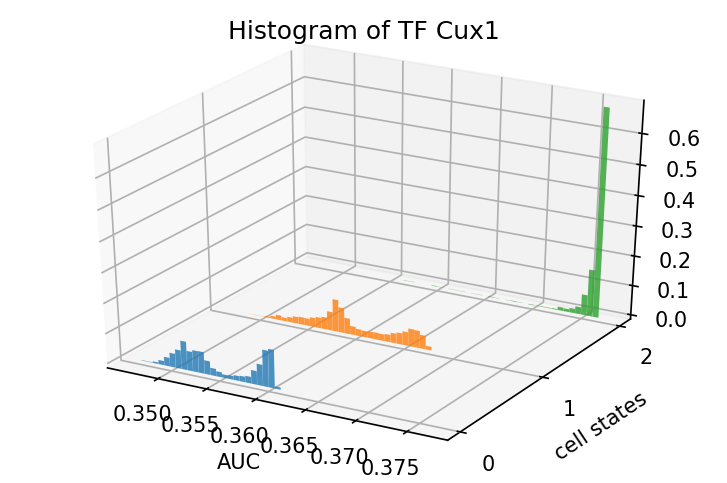

Runx1


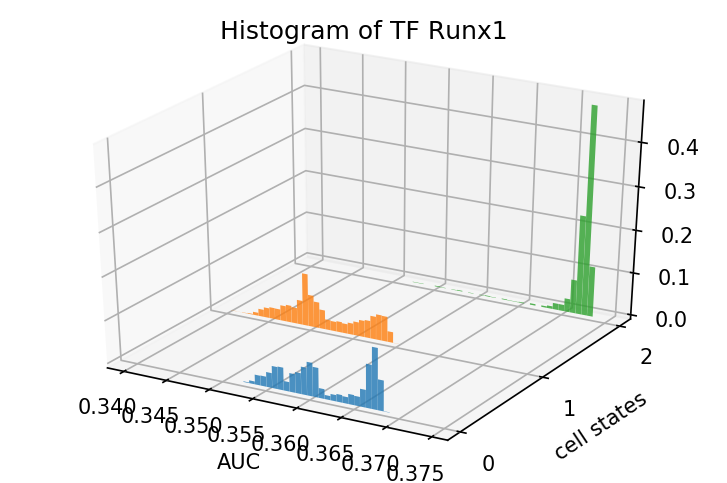

Zc3h8


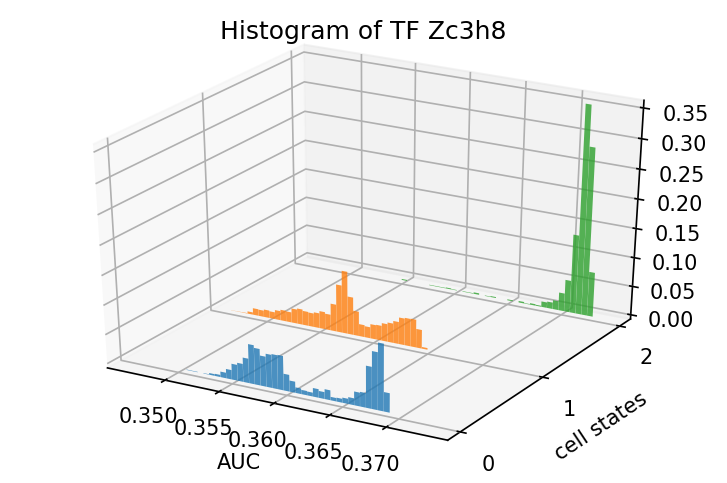

Irf5


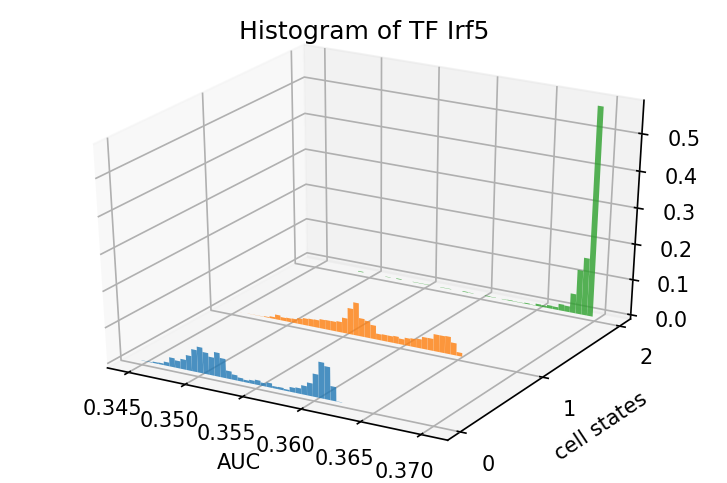

Csrnp1


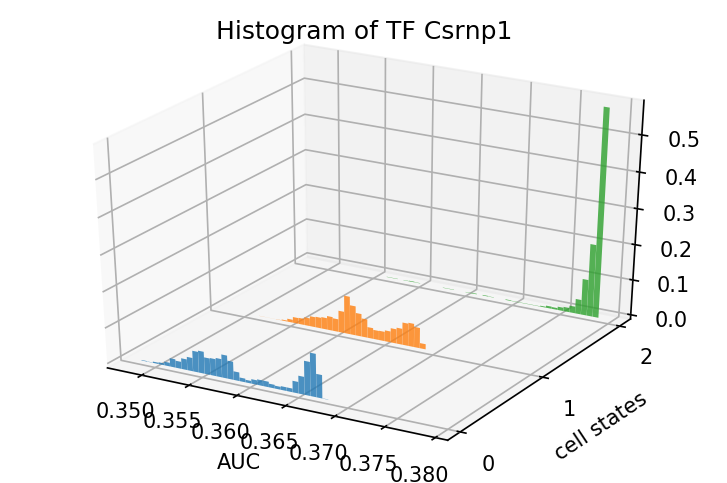

Znf33a


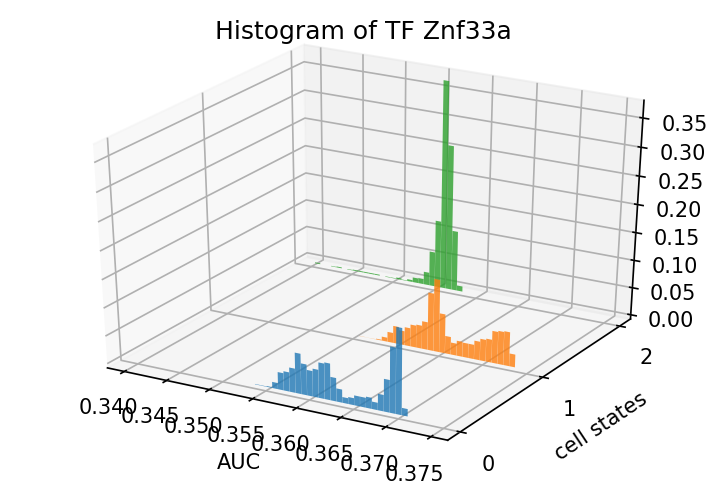

In [34]:
plot_histogram(TF_hist_dict_simic, top_variant_TF)

------
# Most Invariant TFs

Atf1


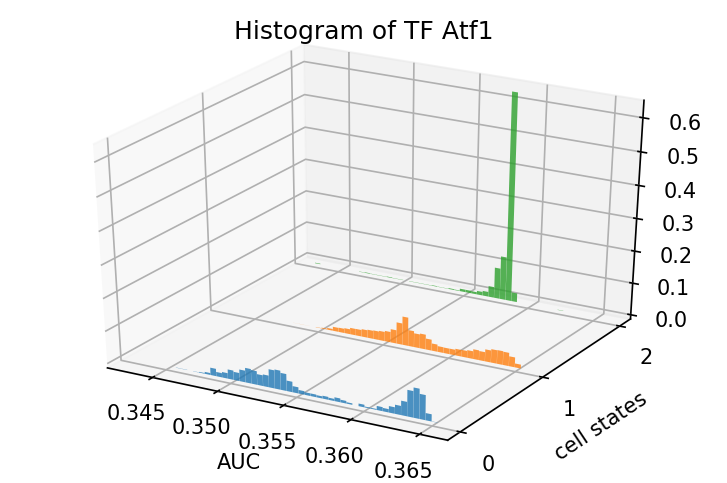

Tcf3


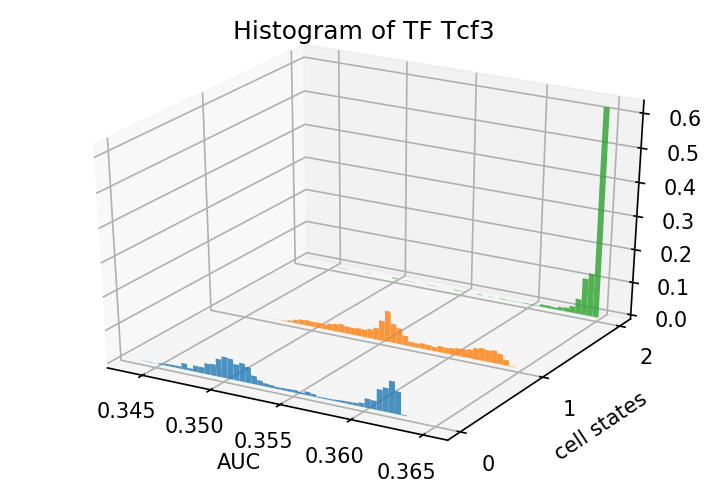

Hmga1


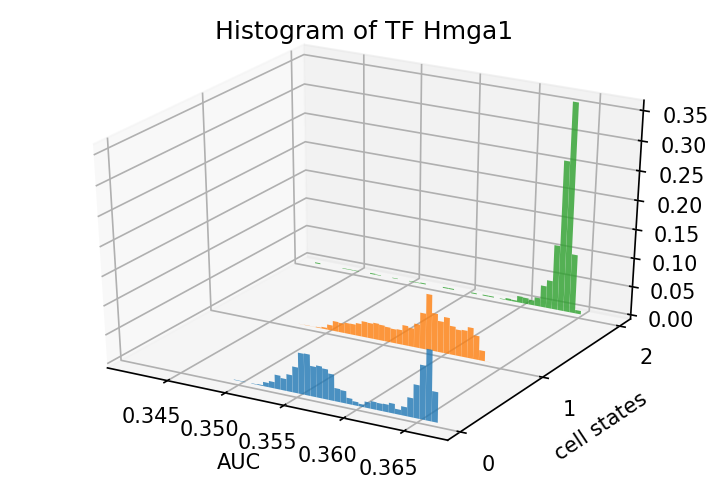

Tfam


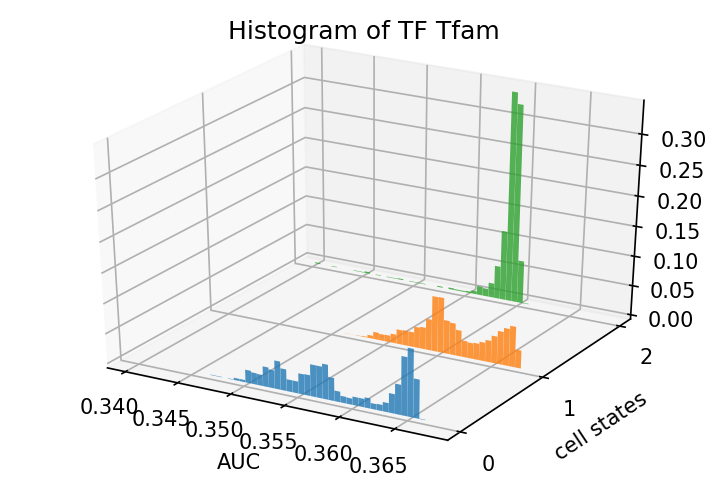

Klf6


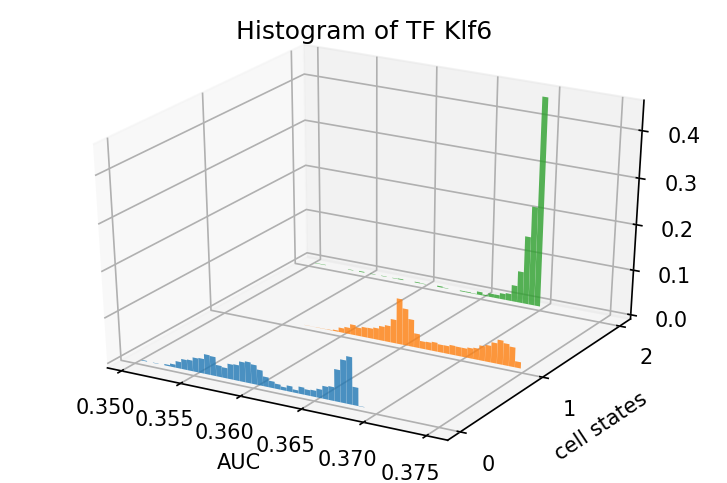

Max


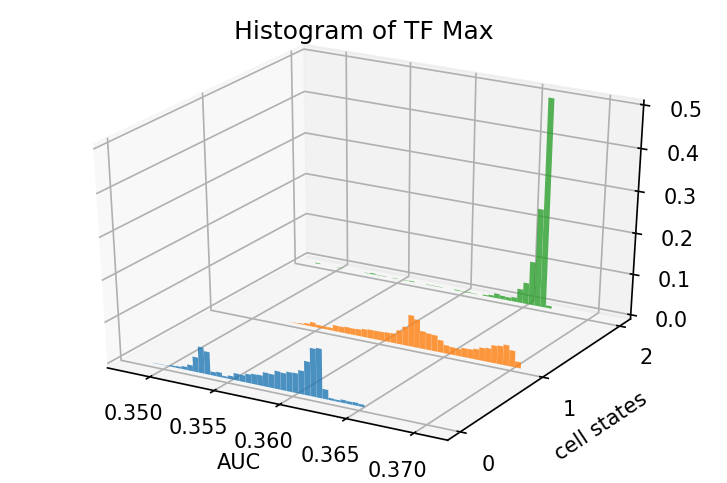

Nr4a3


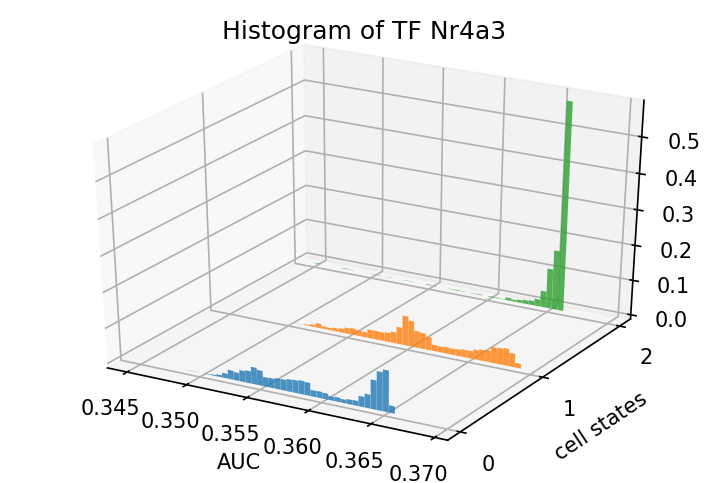

Cnot4


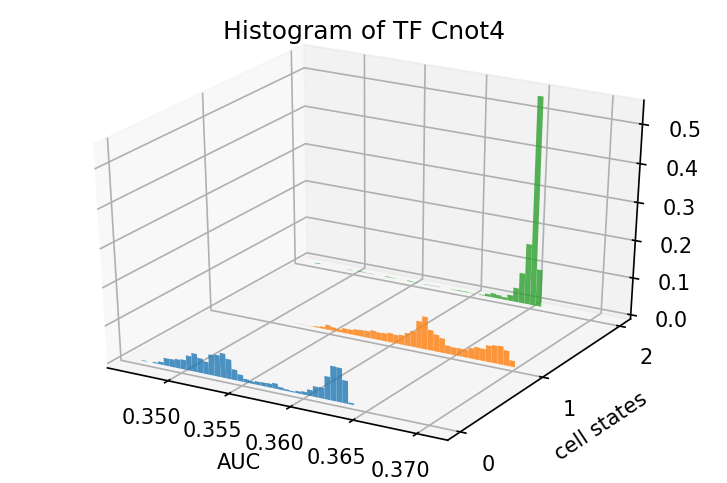

Jun


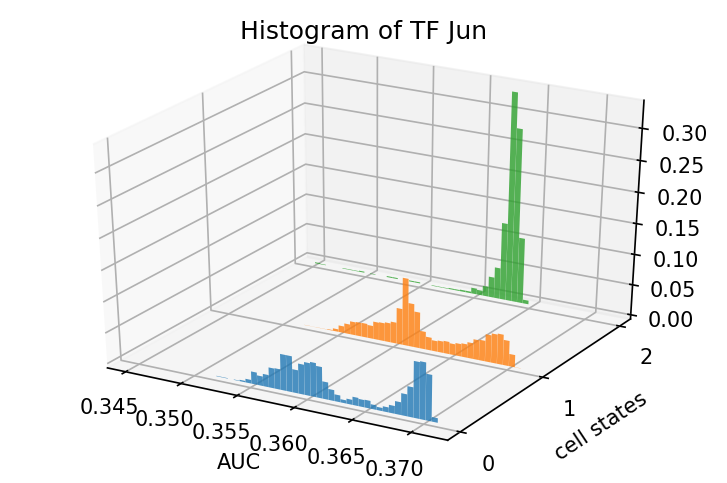

Zbtb44


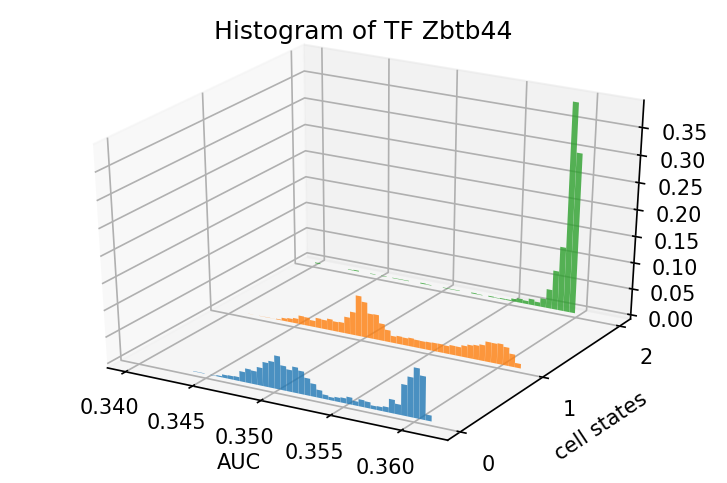

Mlxip


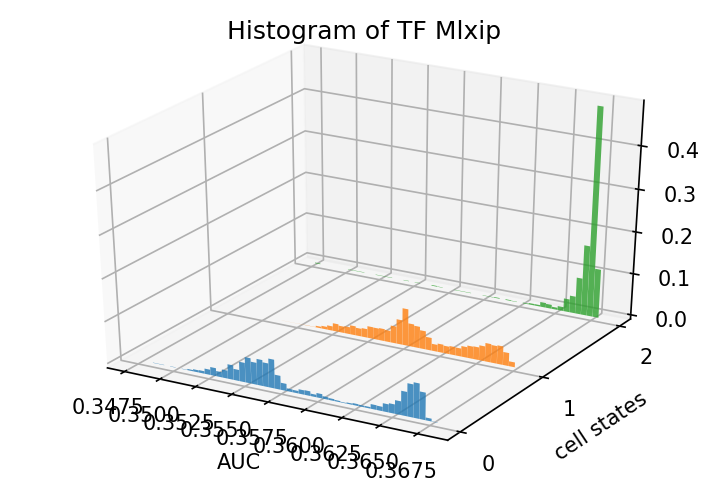

Creb3l2


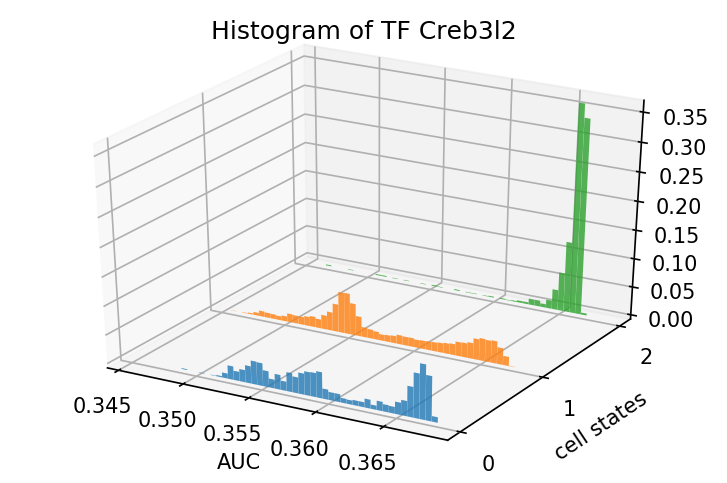

Znf521


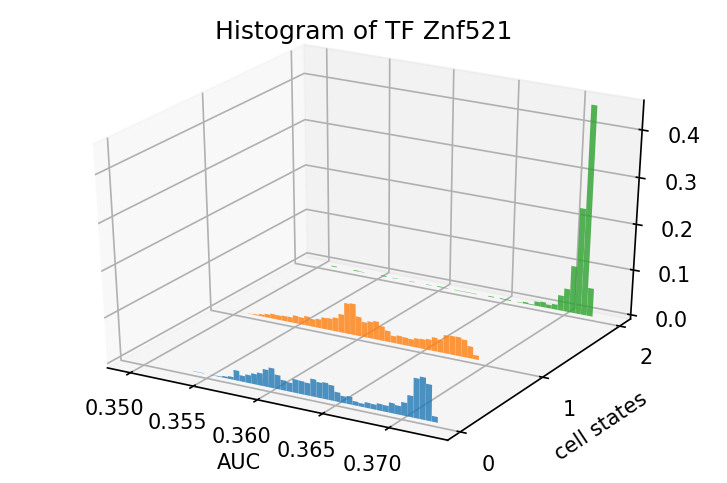

Etv6


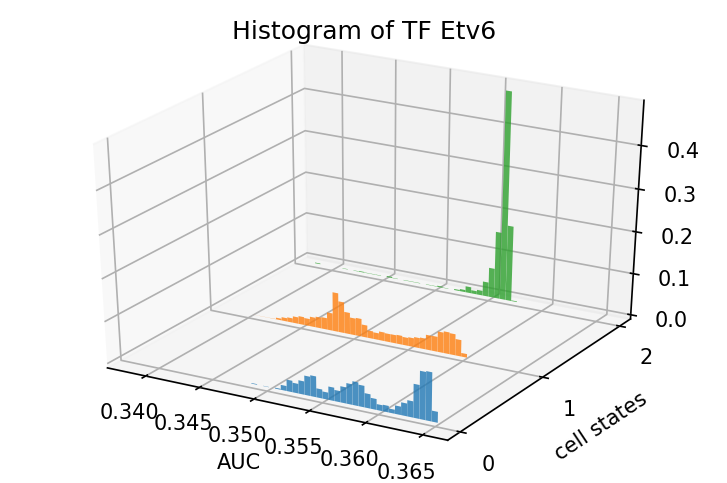

Fos


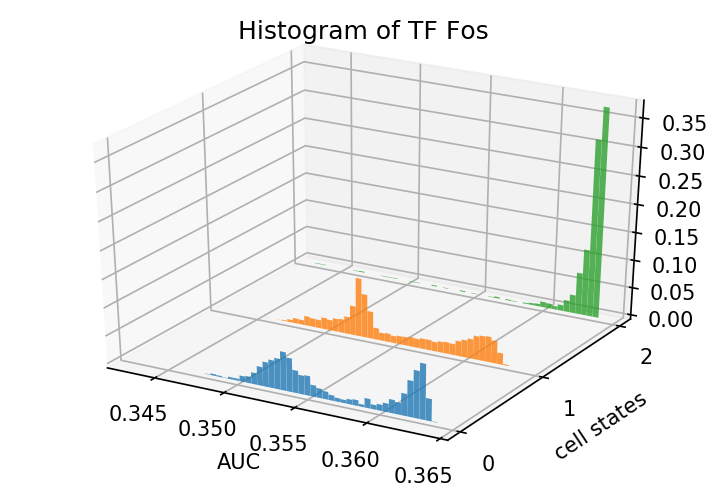

Tox4


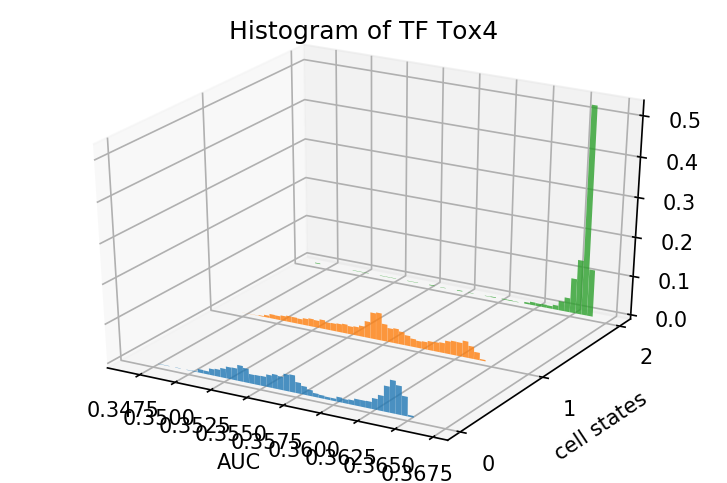

Tfdp2


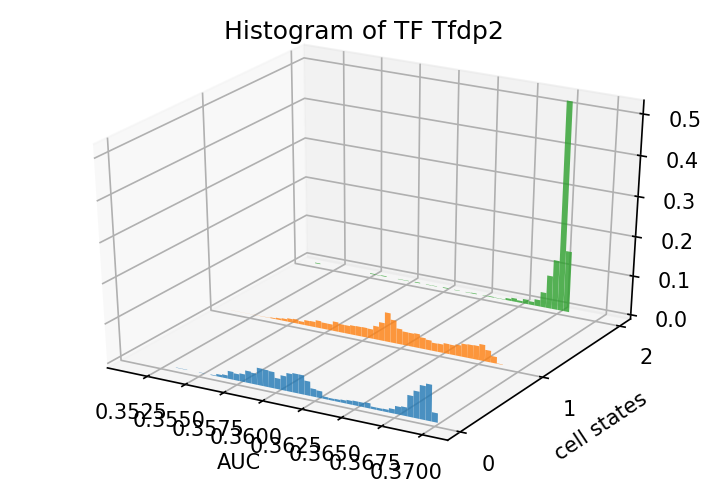

Lrrfip1


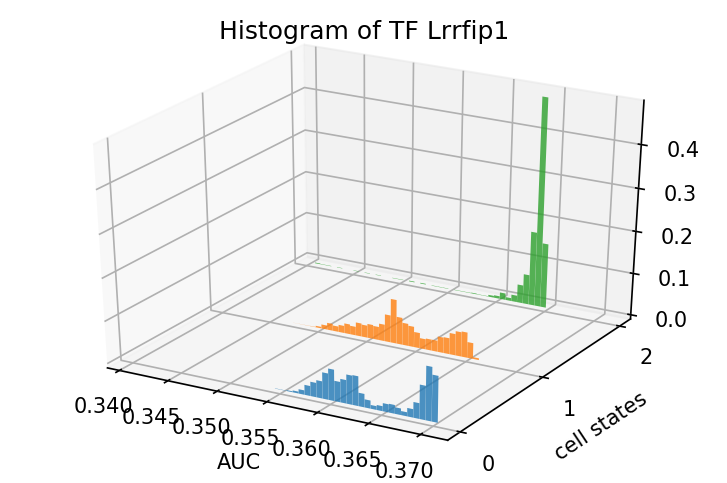

Lrrfip2


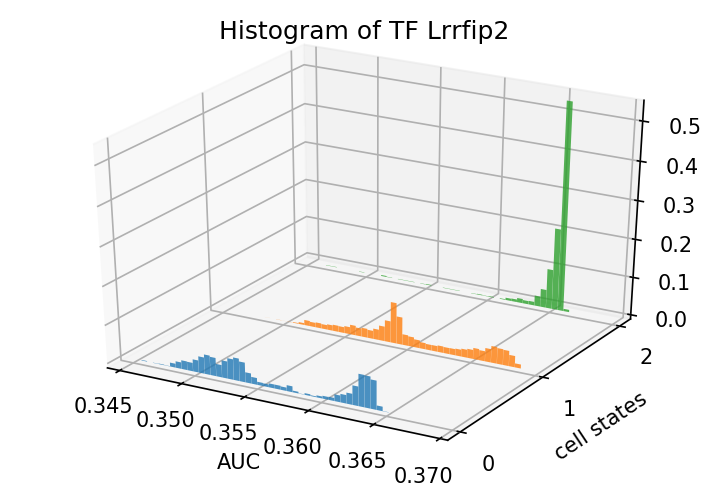

Nfkbid


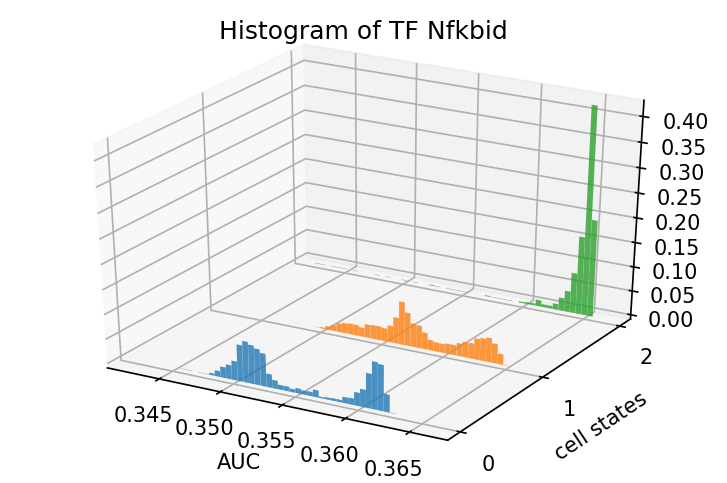

Atf3


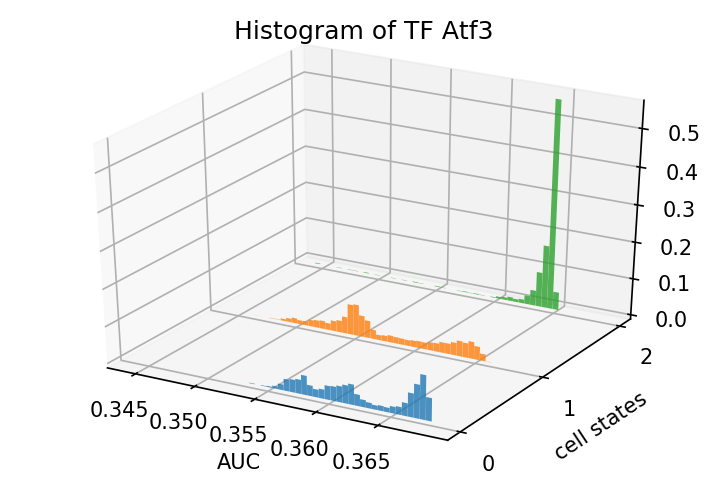

Bcl11a


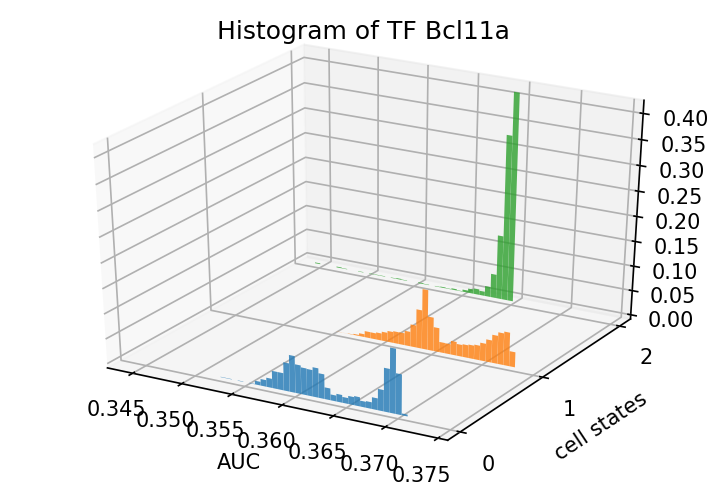

Znf302


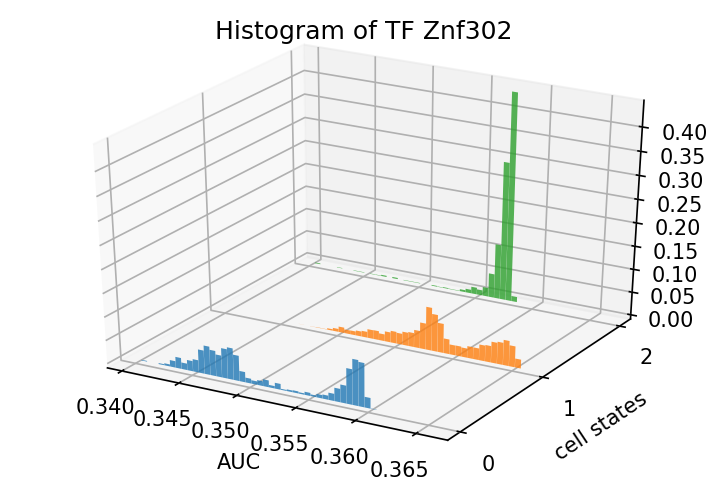

Rfxank


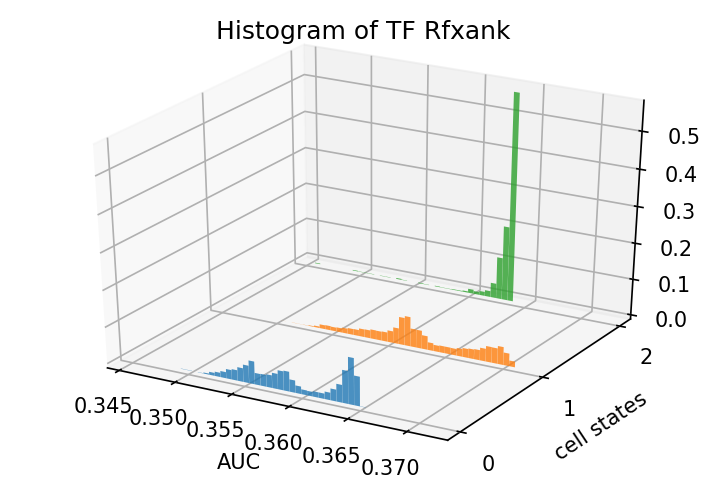

Ybx1


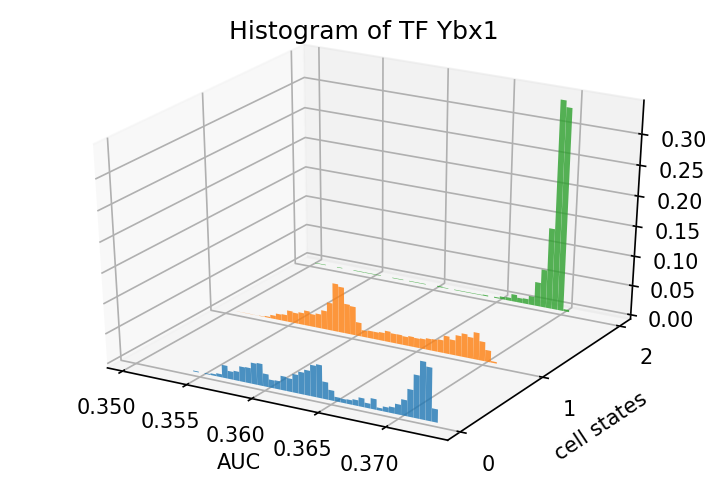

Id1


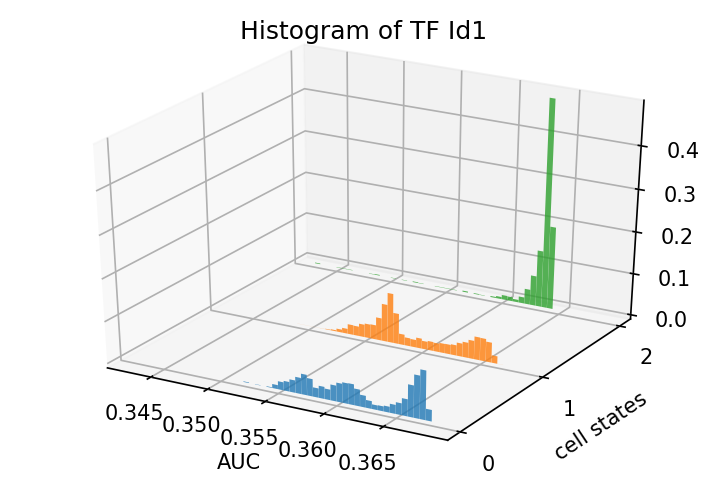

Smarce1


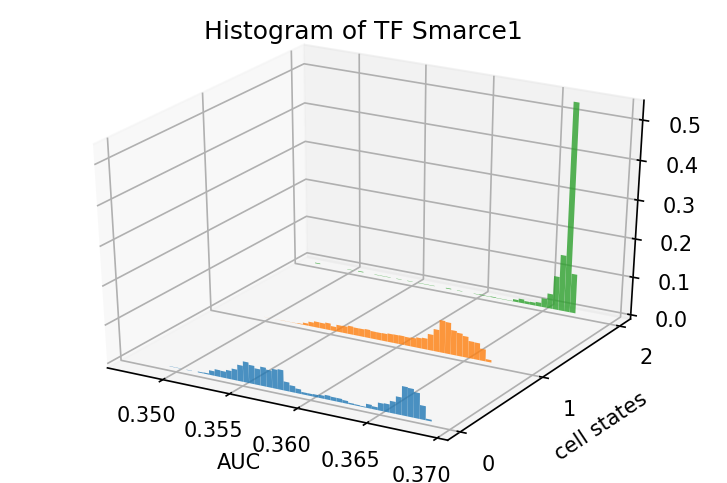

Sp100


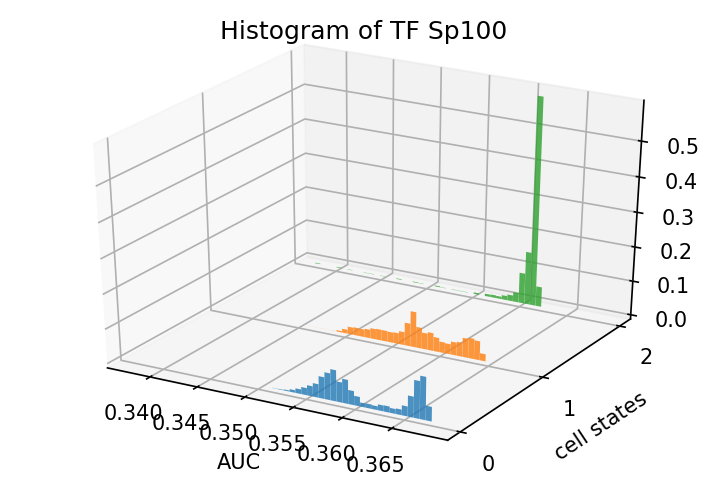

Zbed3


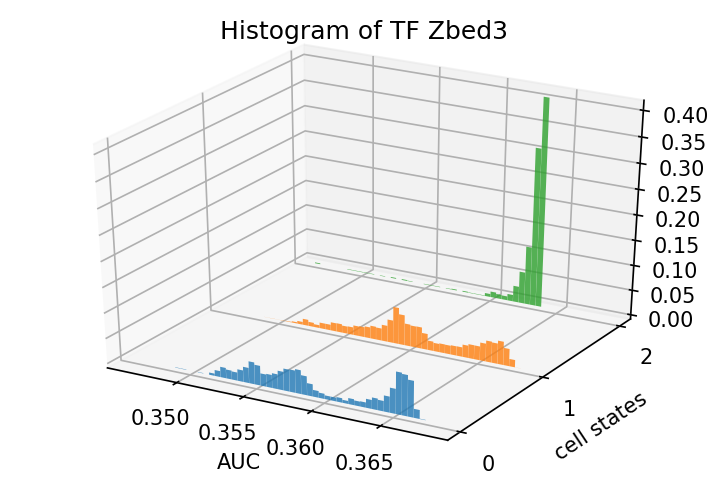

Tsc22d1


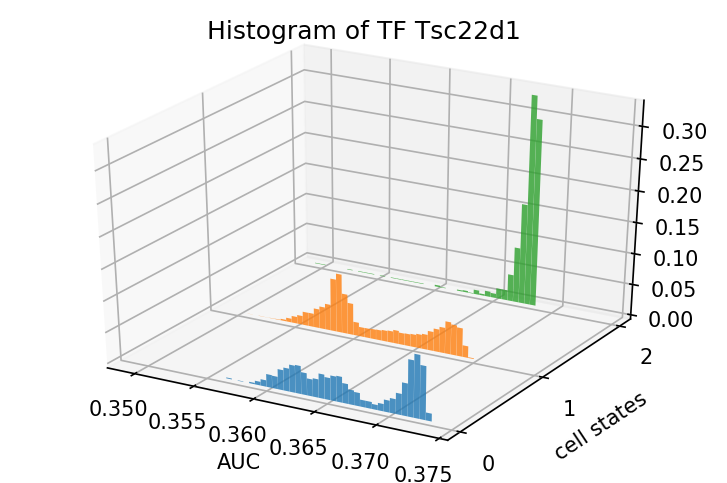

Zeb2


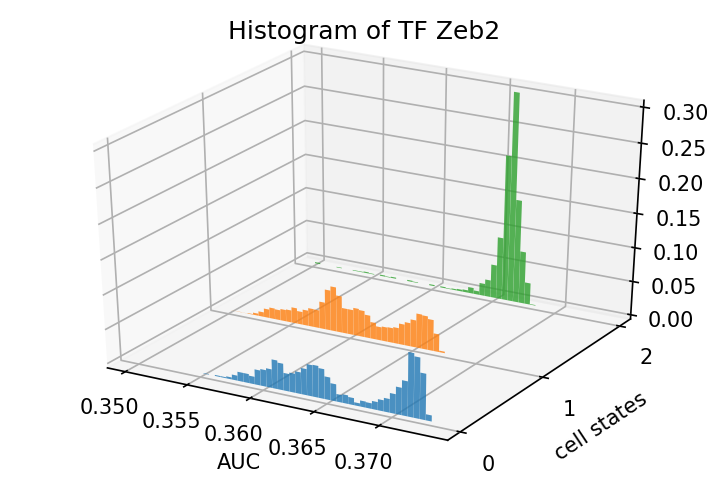

Znf22


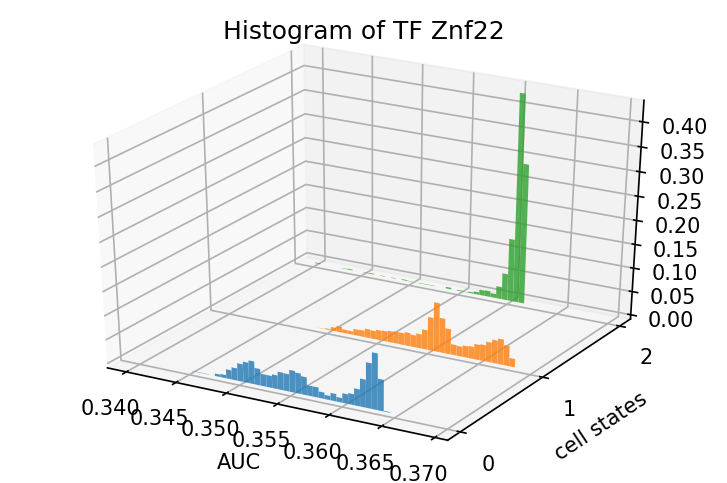

Znf562


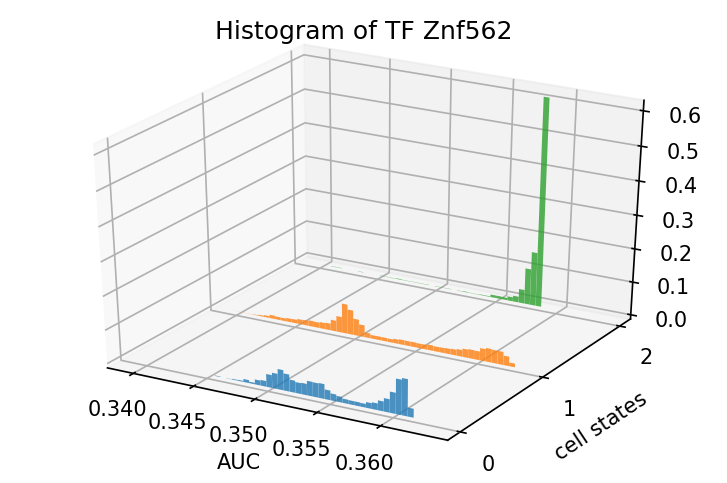

Znf90


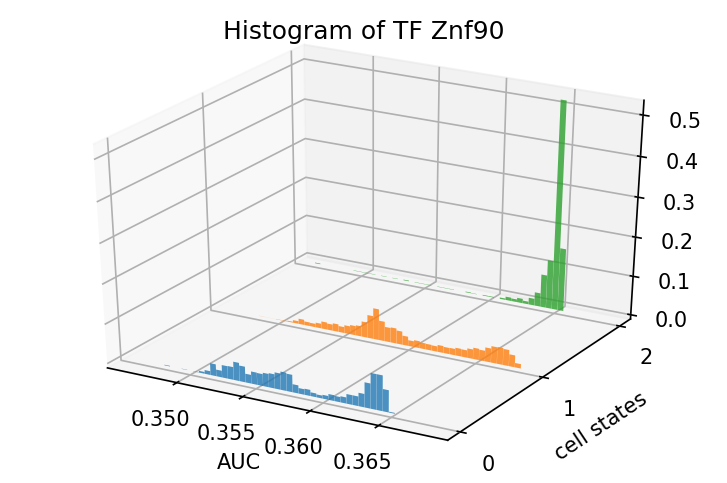

Klf4


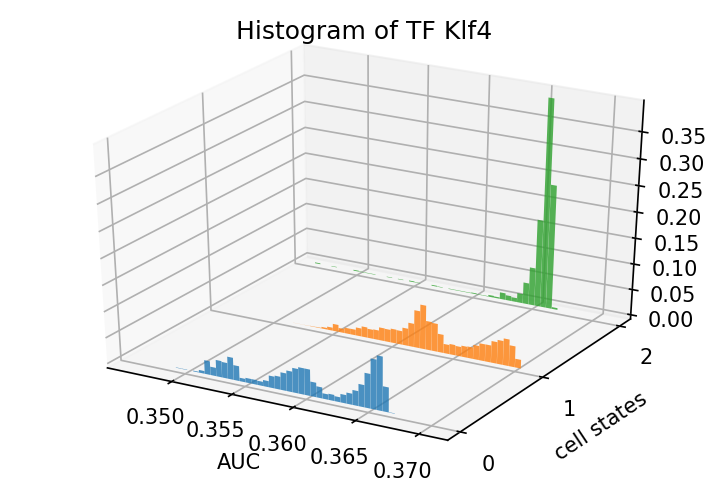

In [35]:
plot_histogram(TF_hist_dict_simic, last_variant_TF)

-------
# Histograms of all TFs

Arid1a


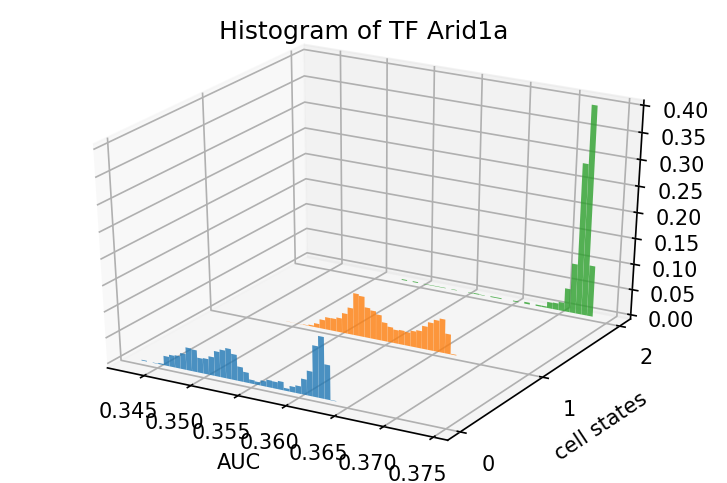

Sfpq


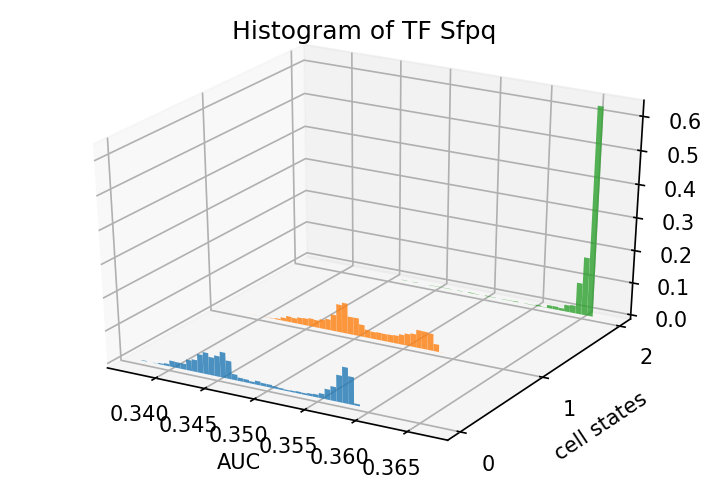

Ybx1


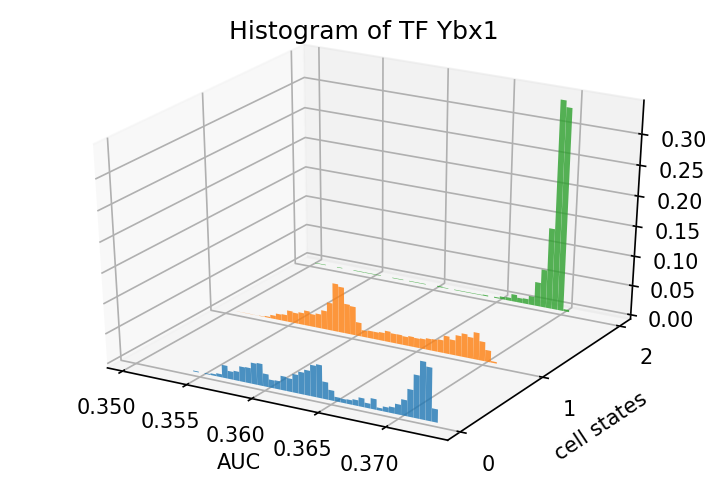

Jun


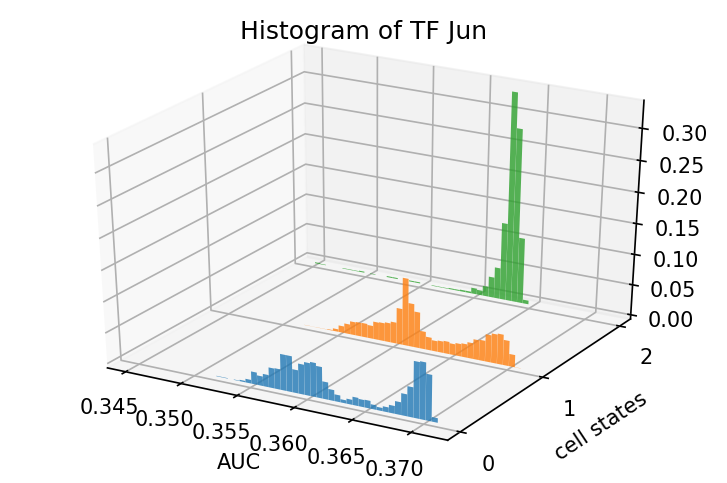

Mier1


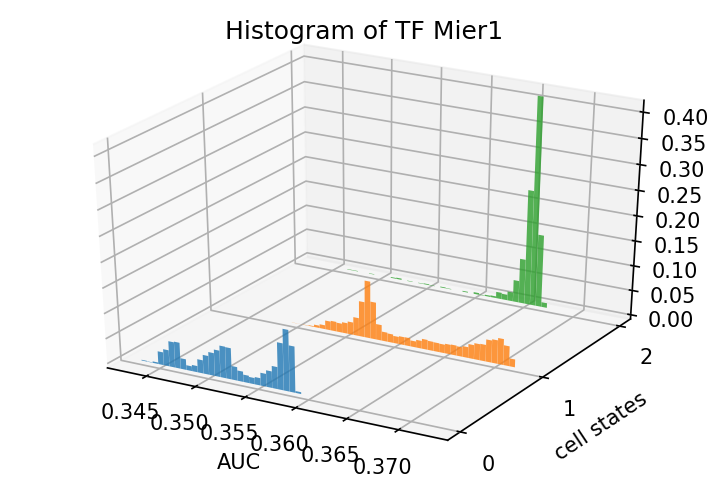

Phtf1


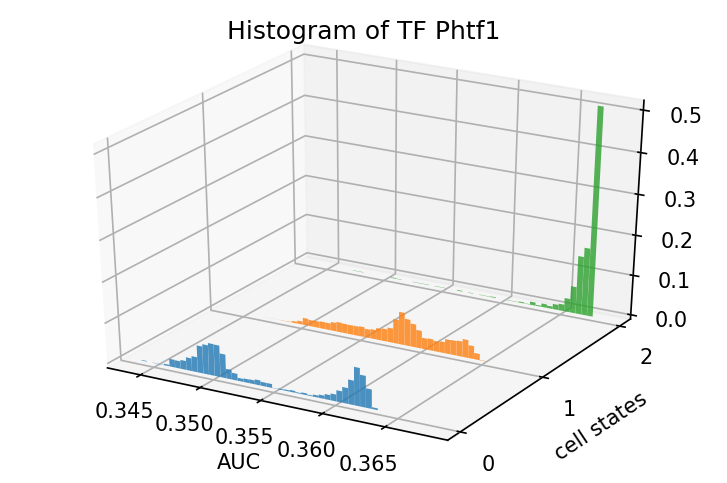

Pogz


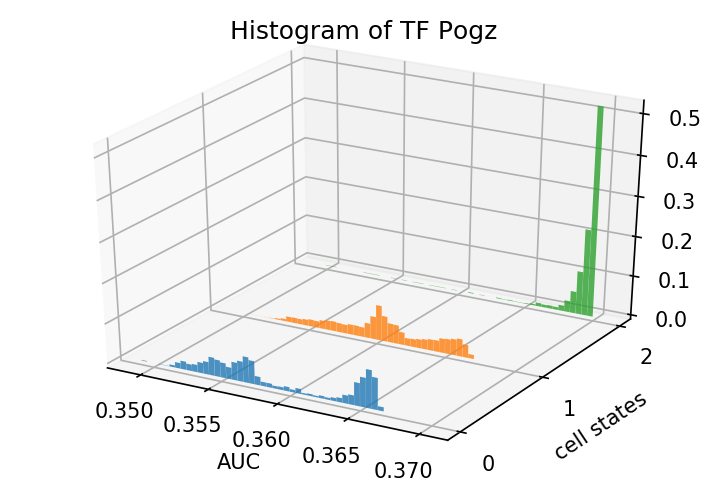

Creb3l4


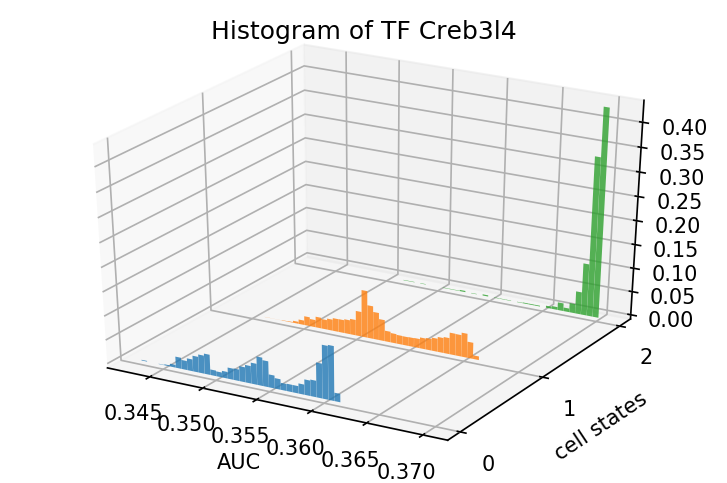

Pbx1


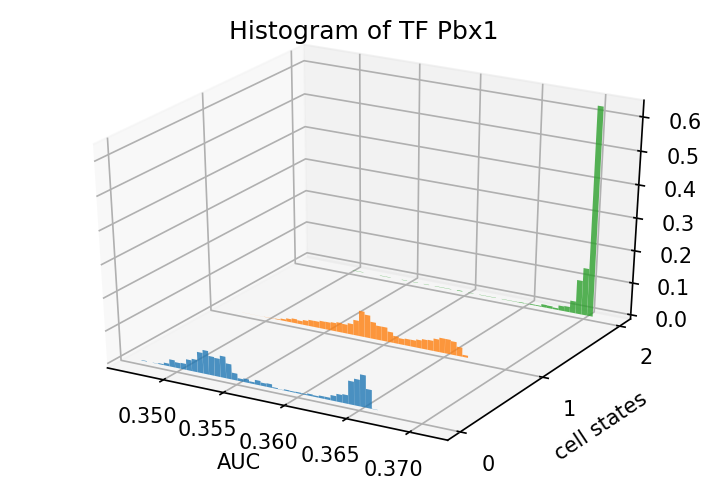

Kdm5b


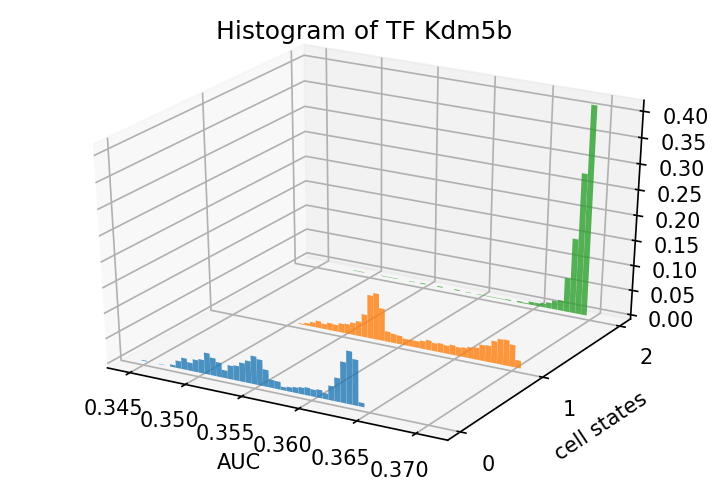

Atf3


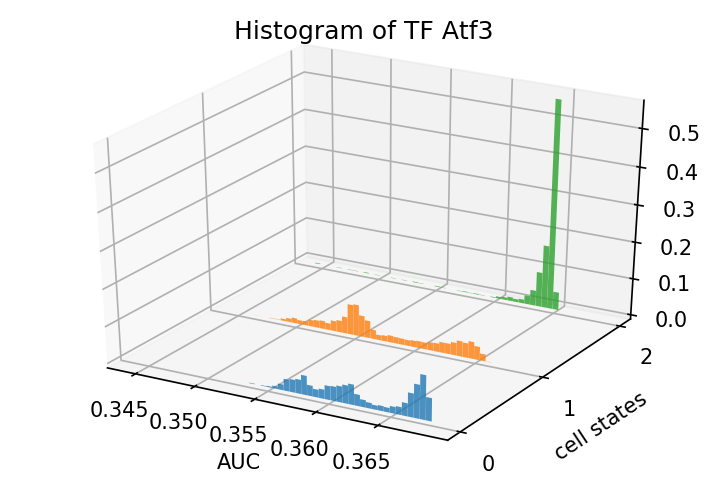

Arid4b


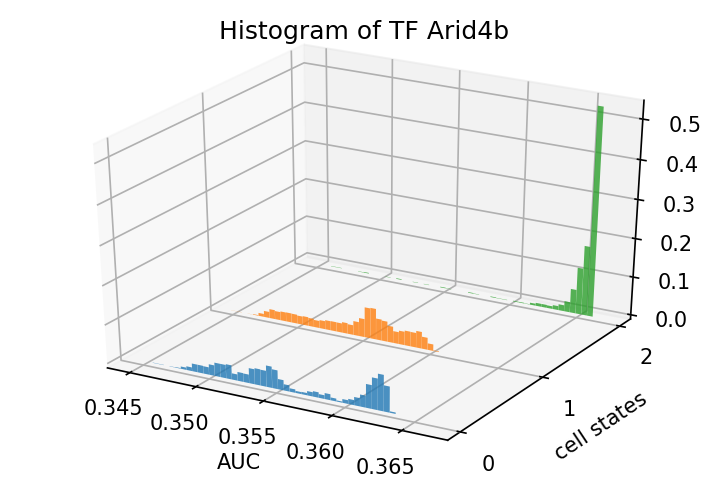

Dnmt3a


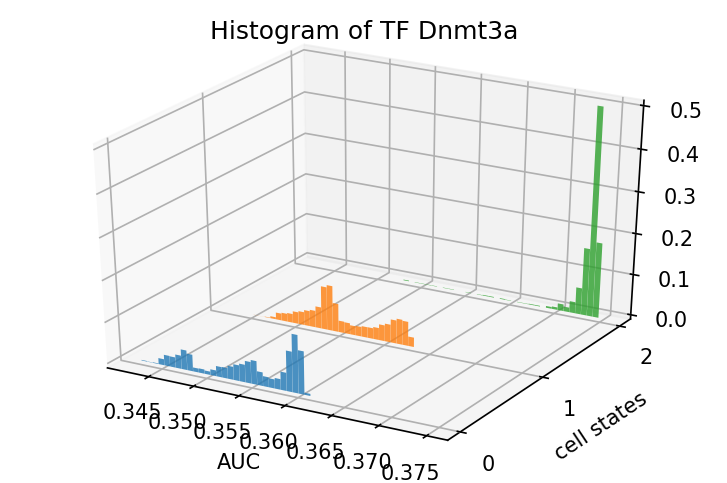

Bcl11a


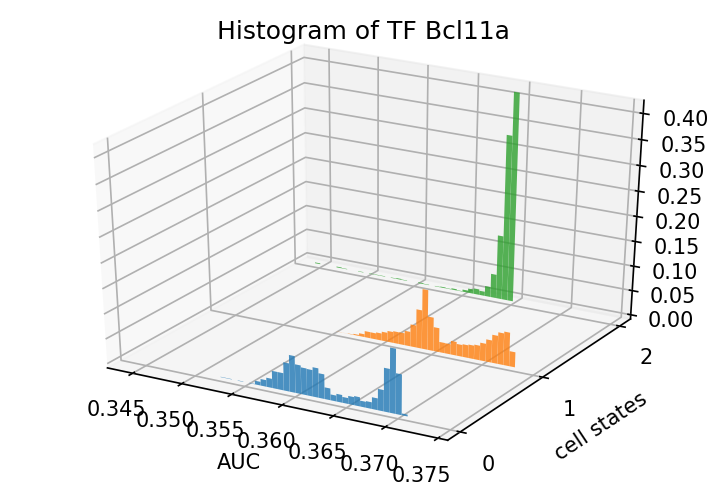

Rel


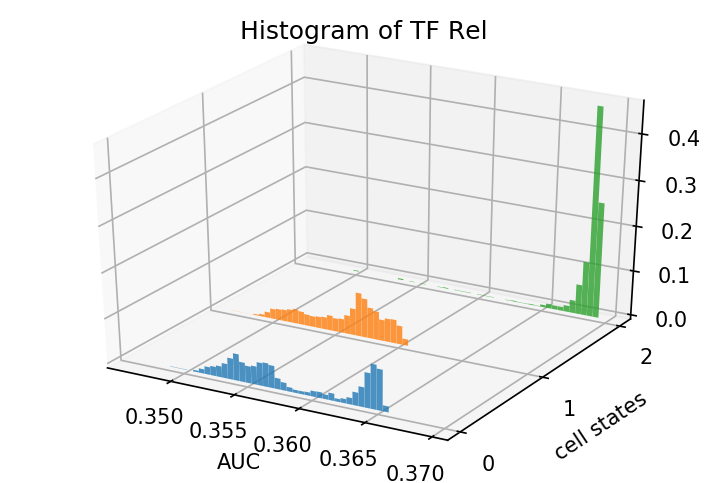

Zc3h8


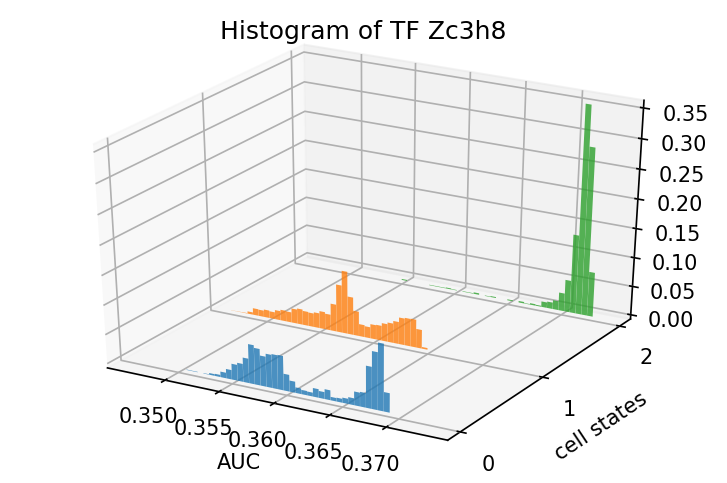

Zeb2


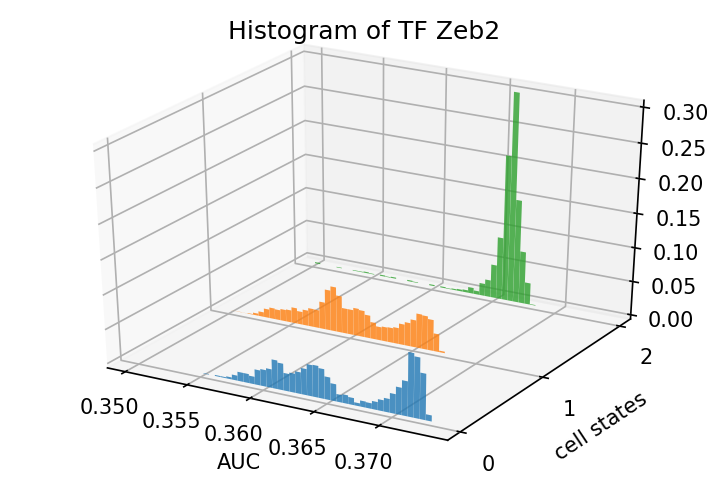

Nr4a2


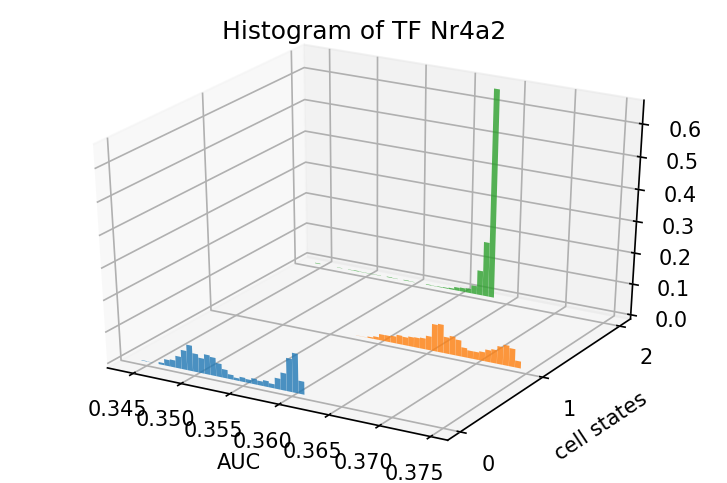

Sp100


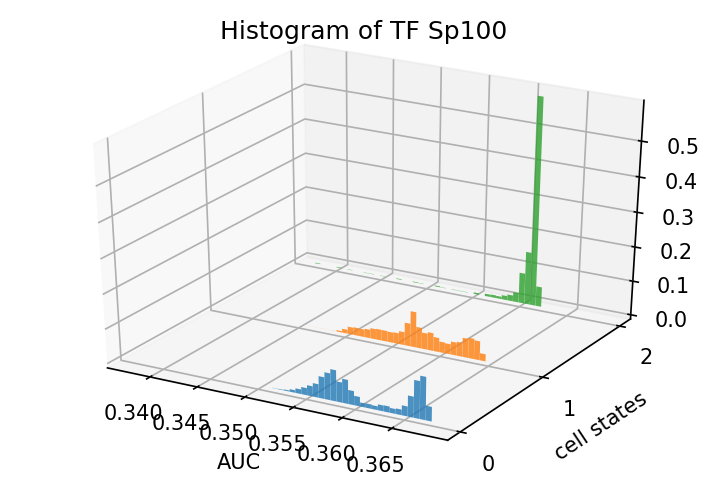

Lrrfip1


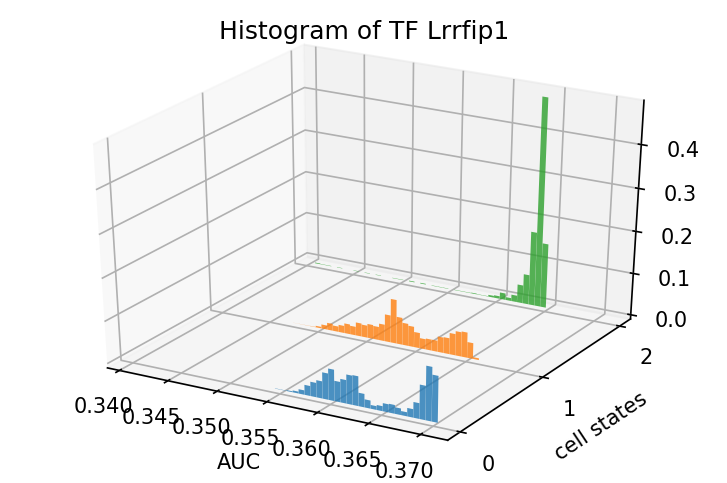

Satb1


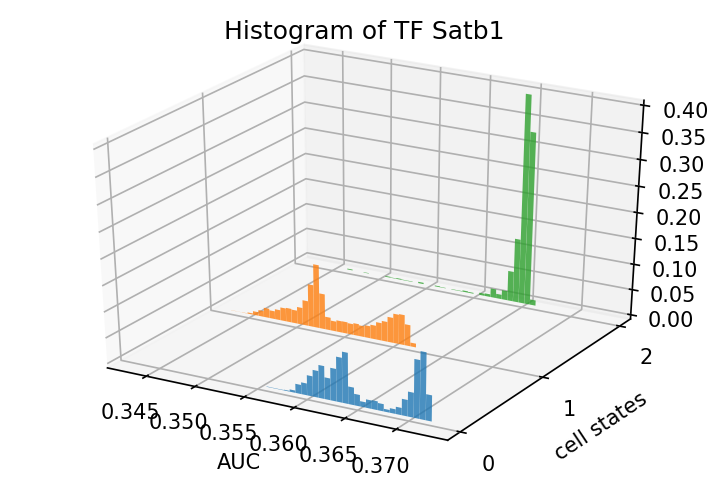

Lrrfip2


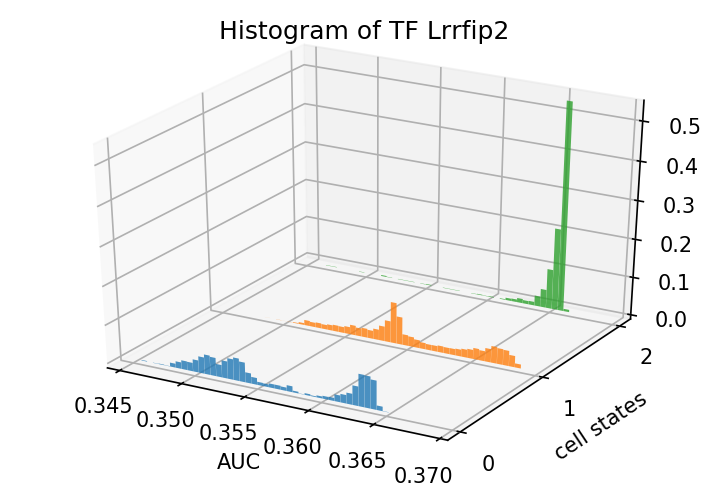

Csrnp1


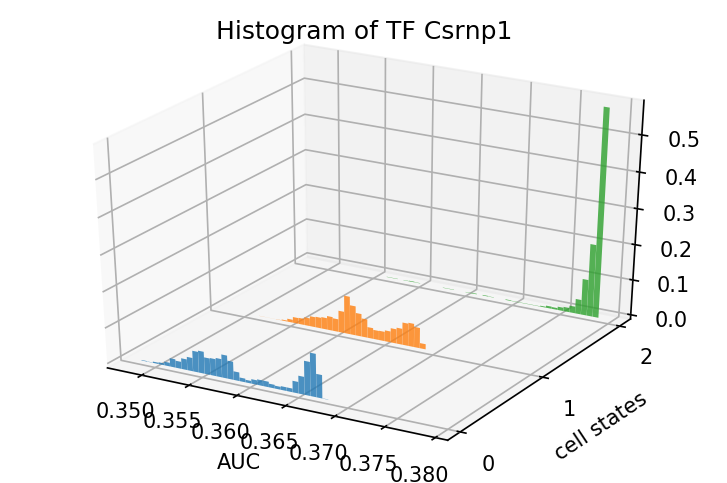

Smarcc1


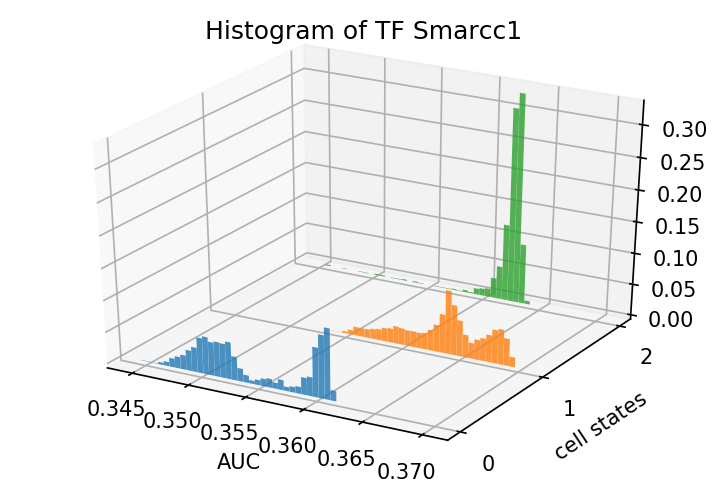

Foxp1


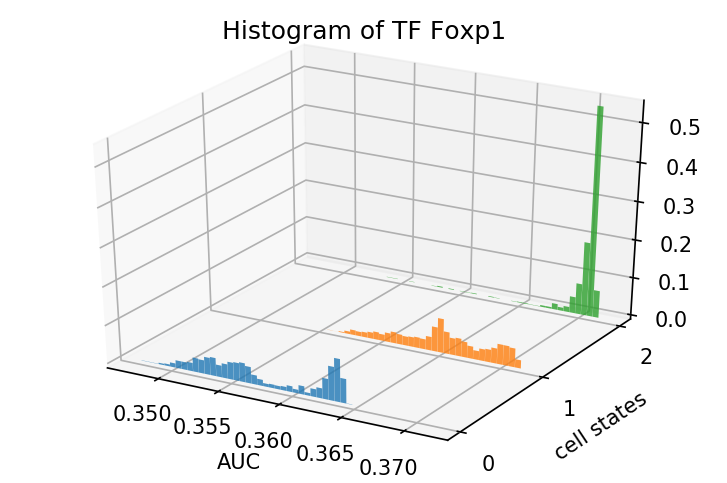

Bbx


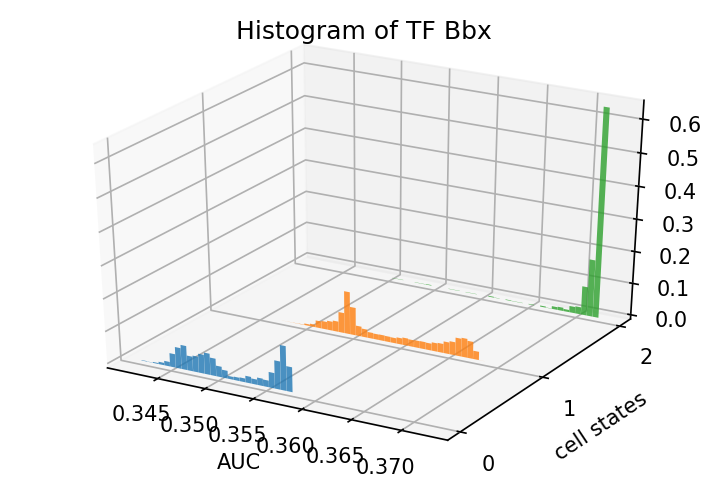

Klf15


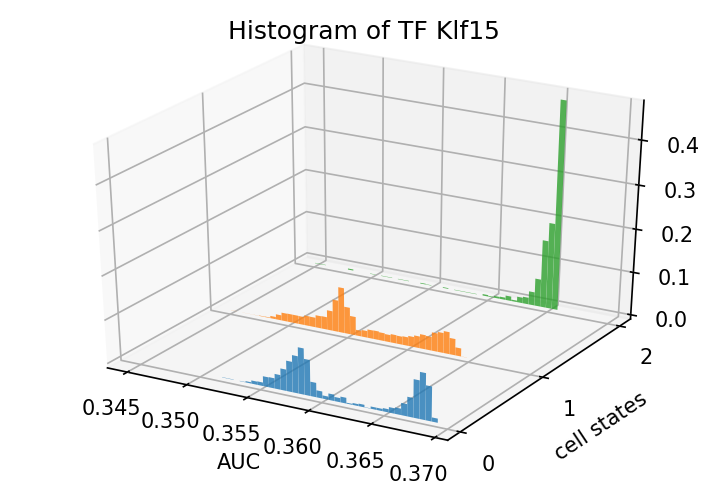

Tfdp2


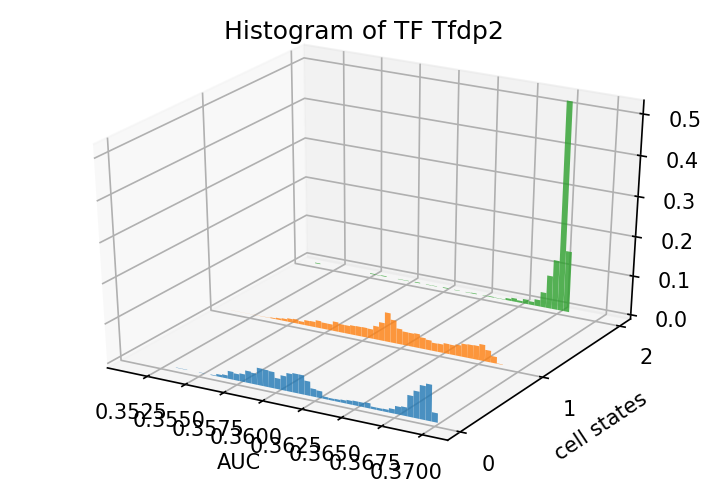

Mxd4


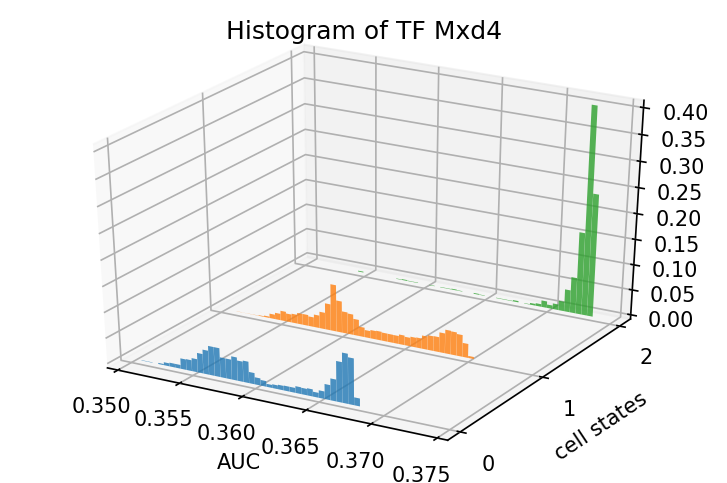

Rest


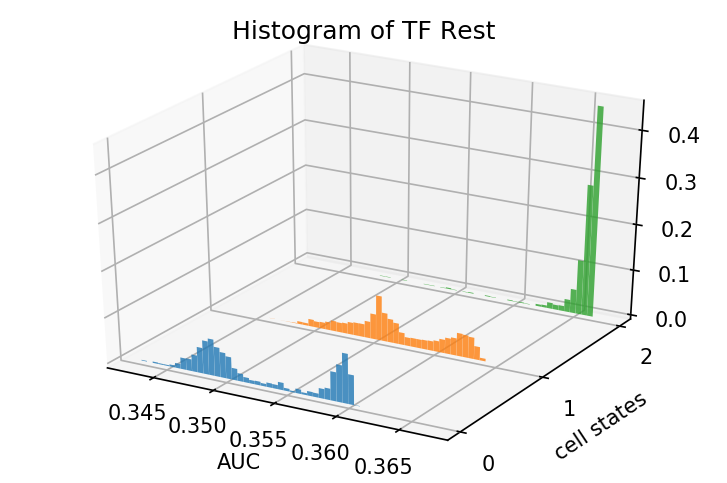

Zbed3


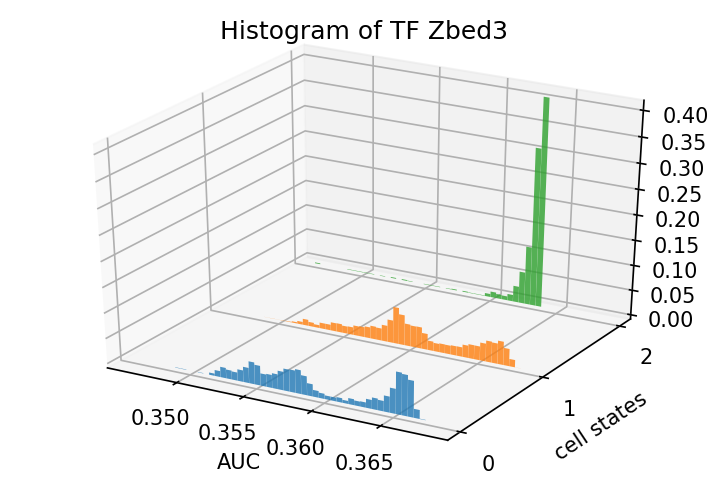

Mef2c


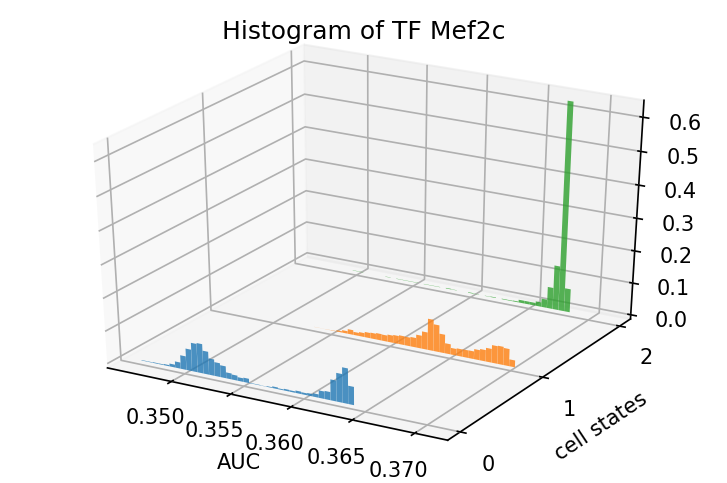

Irf1


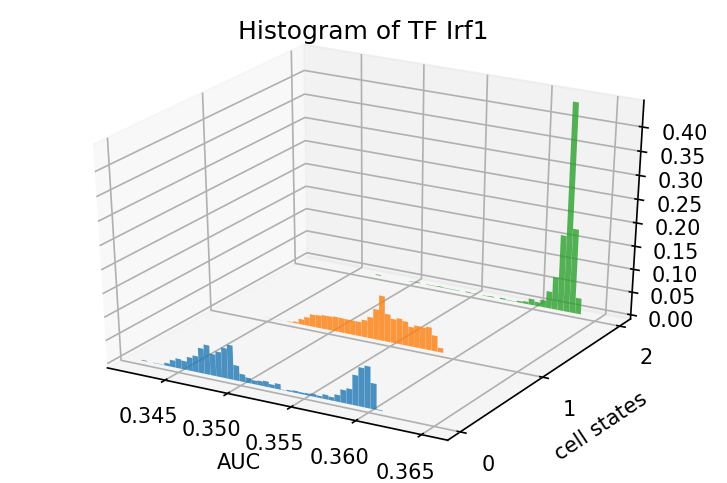

Jarid2


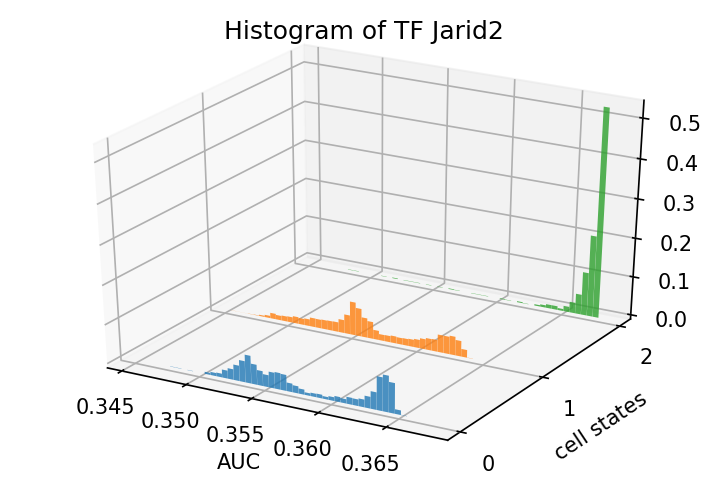

Sox4


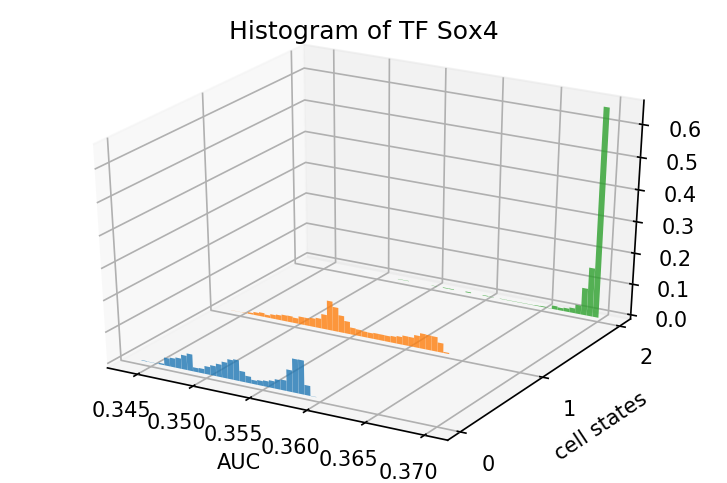

Atf6b


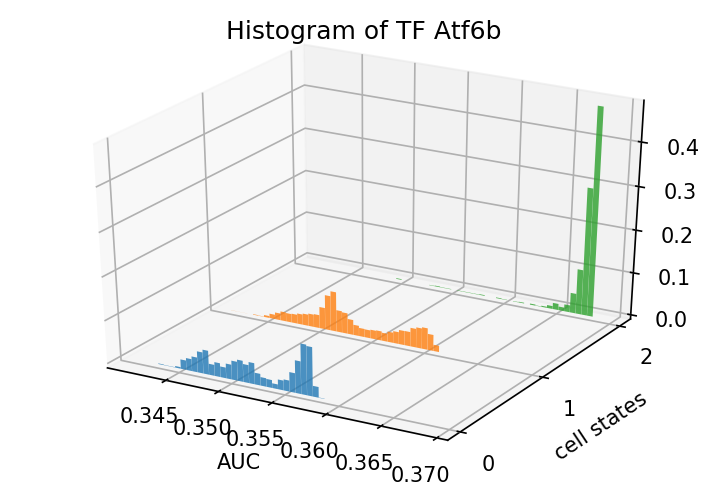

Hmga1


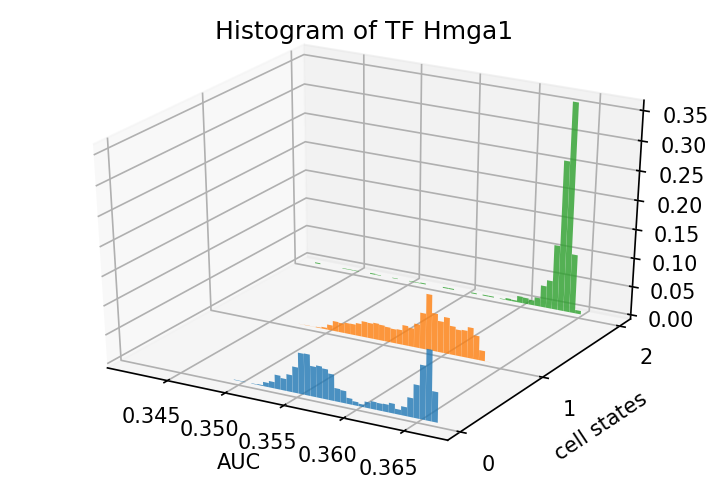

Cdc5l


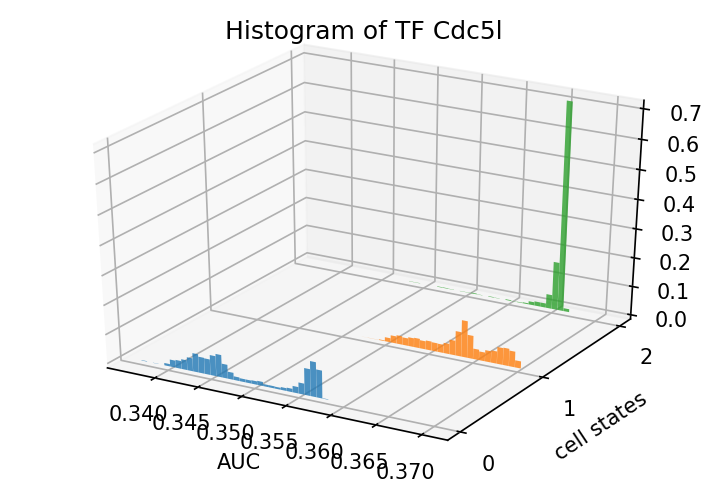

Znf292


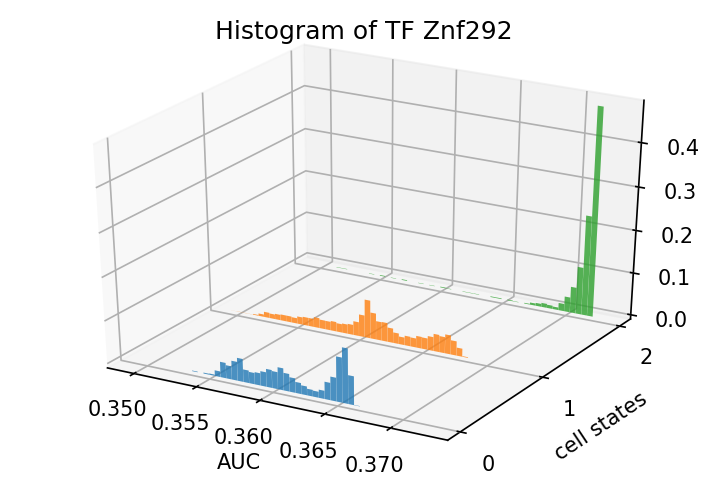

Zkscan1


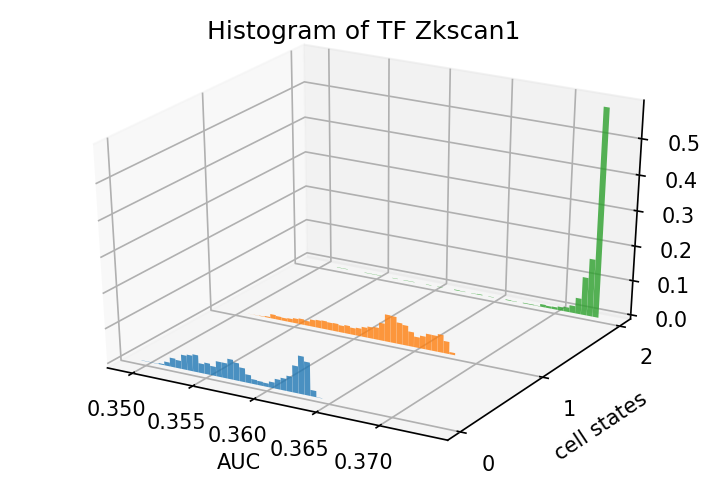

Tsc22d4


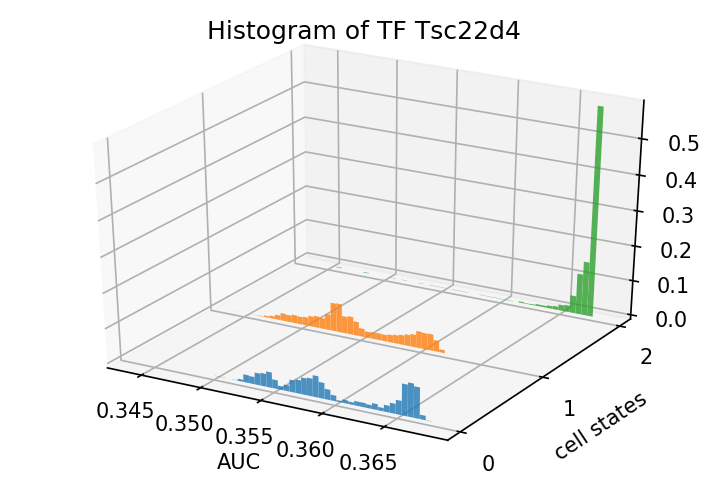

Cux1


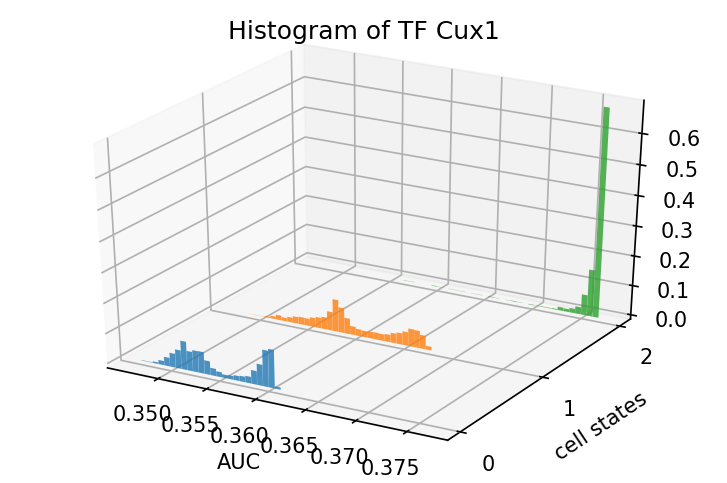

Dnajc2


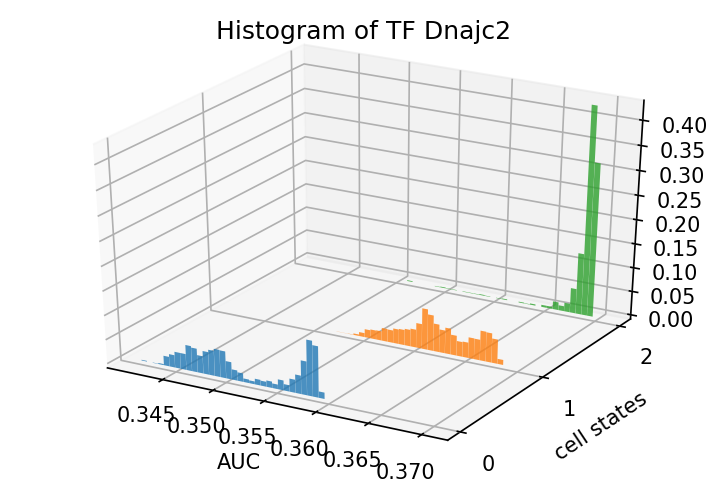

Irf5


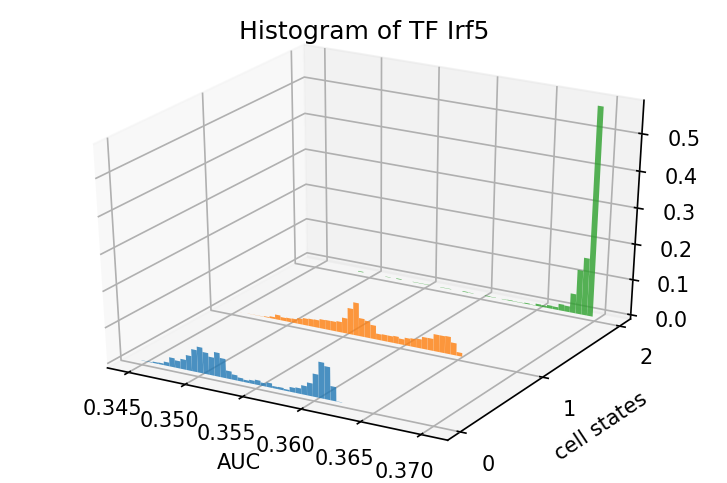

Cnot4


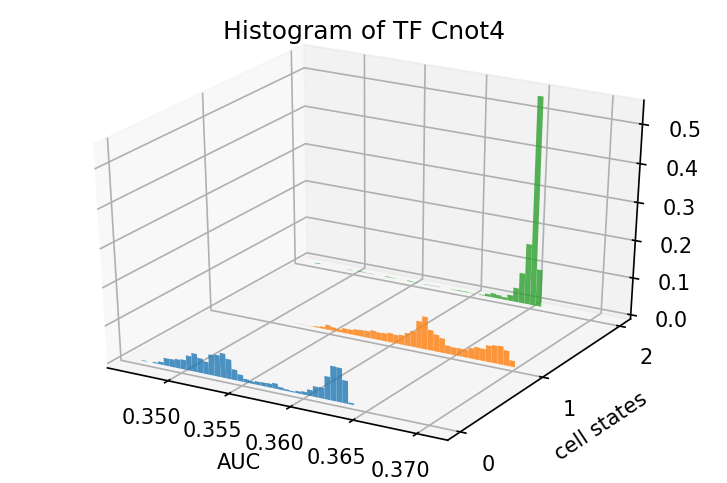

Creb3l2


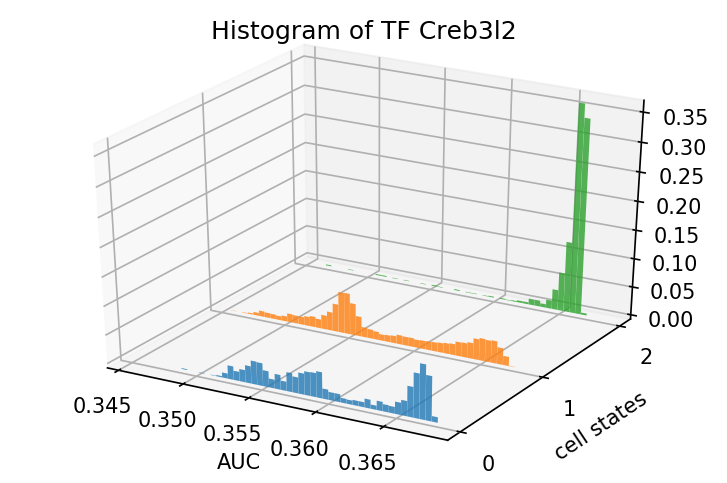

Nono


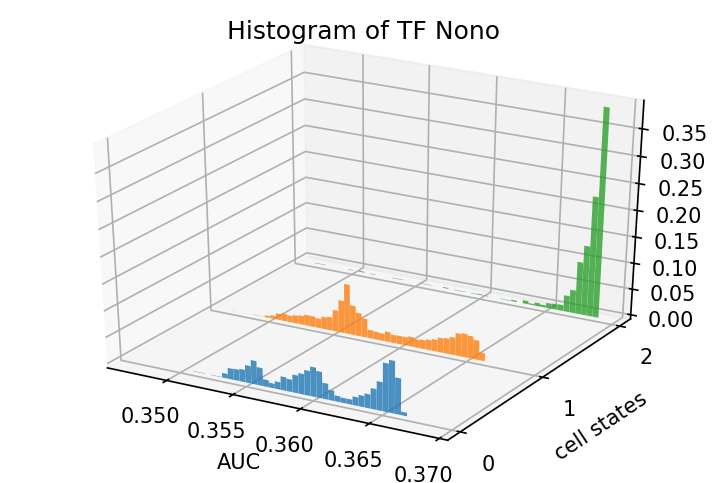

Atrx


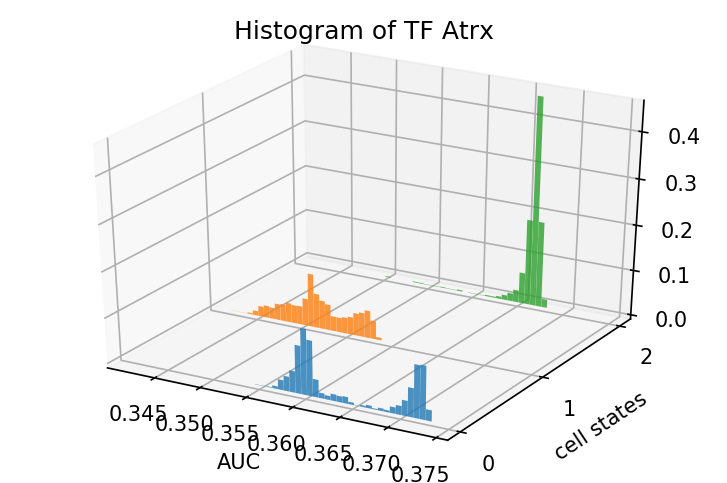

Tsc22d3


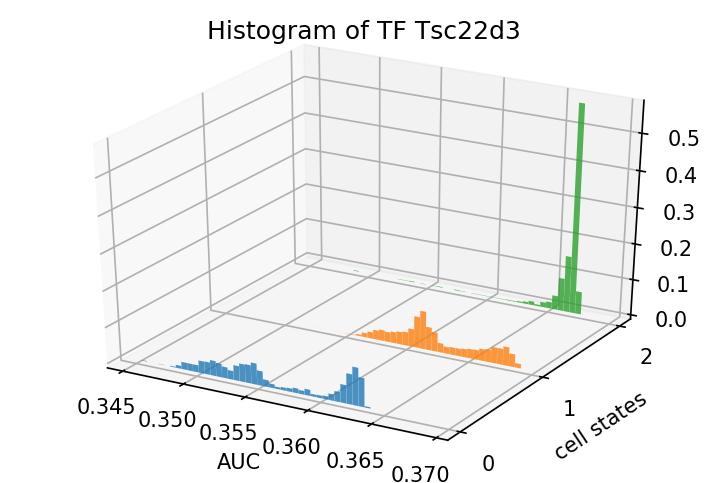

Egr3


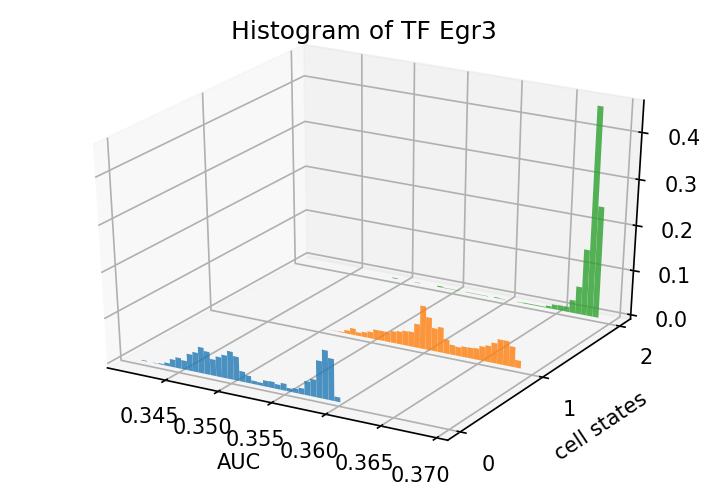

Klf10


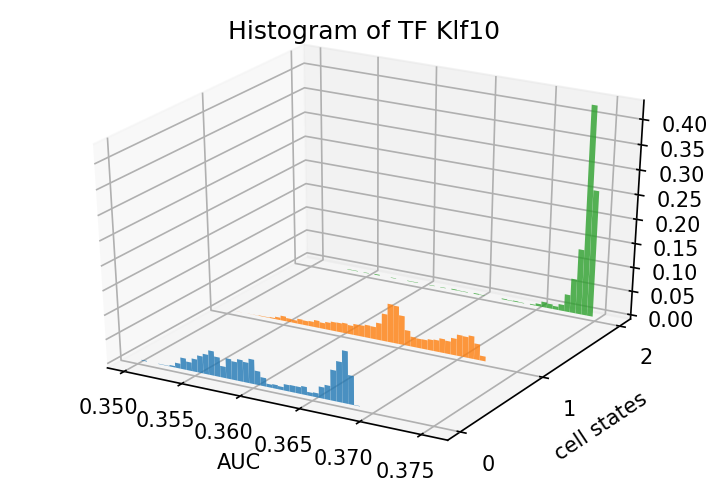

Nr4a3


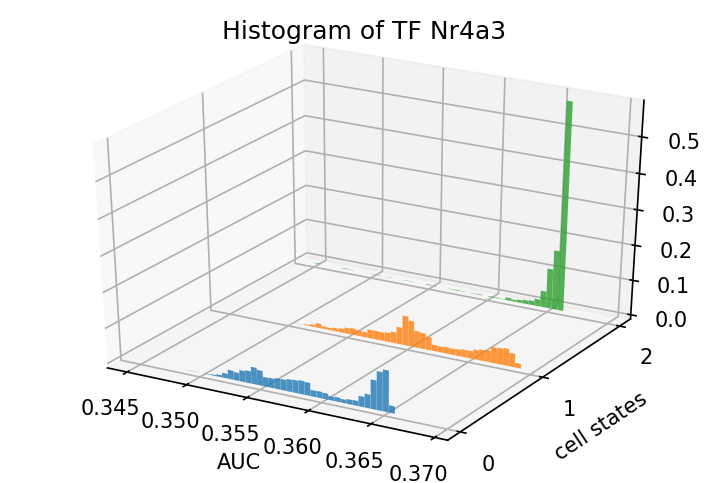

Klf4


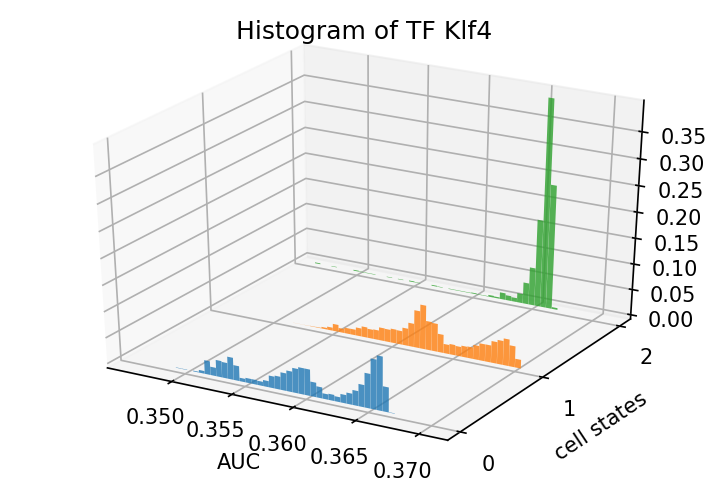

Kmt2a


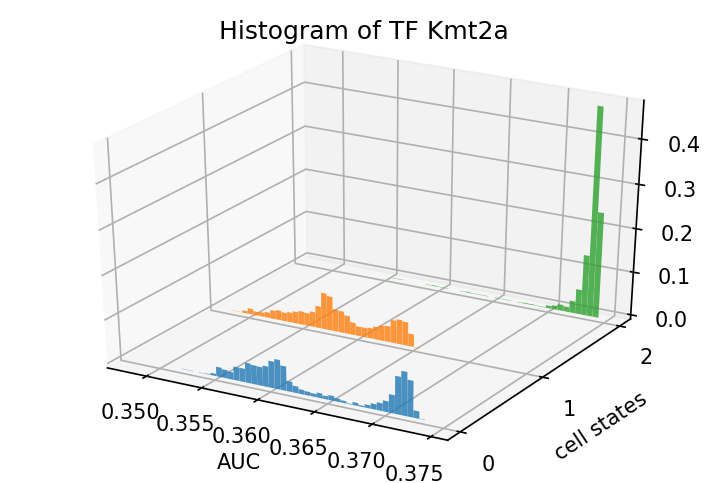

Zbtb44


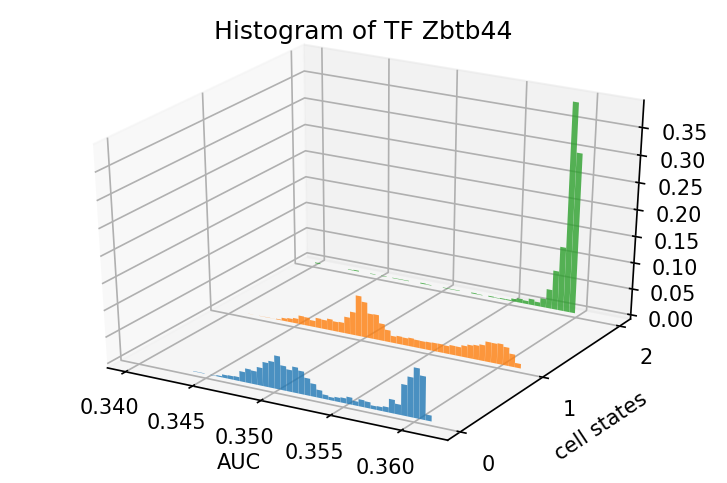

Klf6


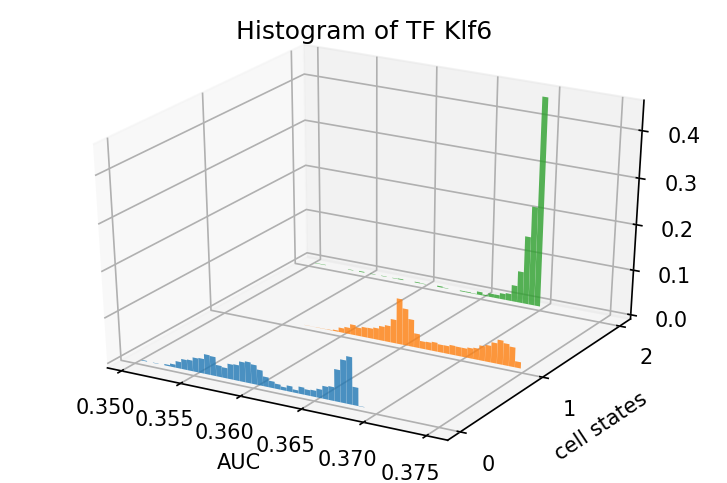

Znf33a


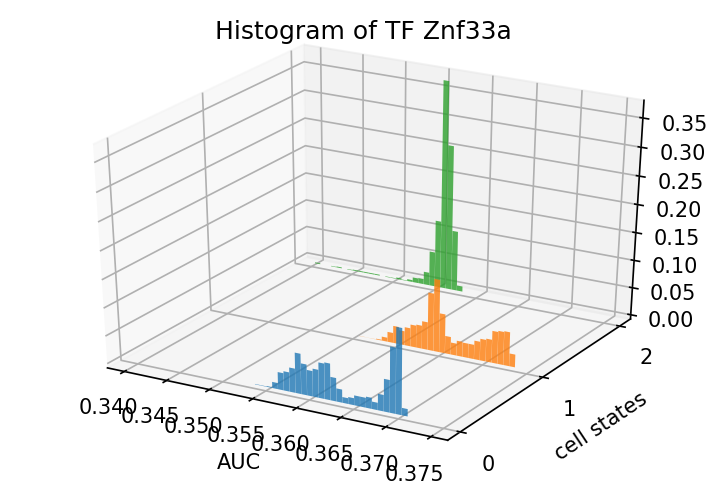

Znf22


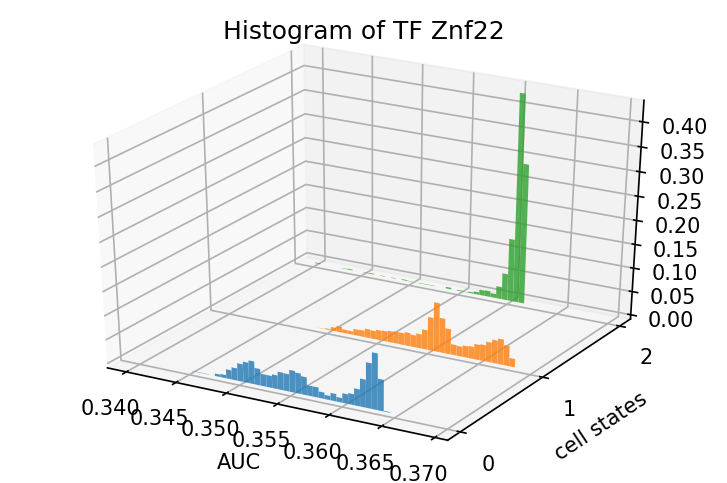

Tfam


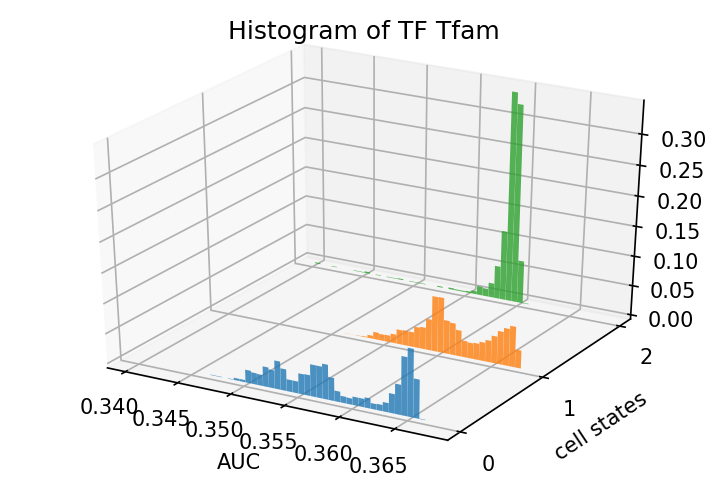

Arid5b


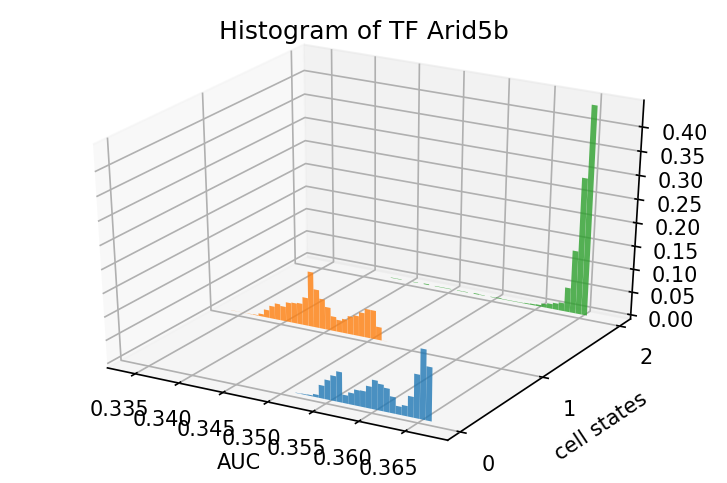

Kat6b


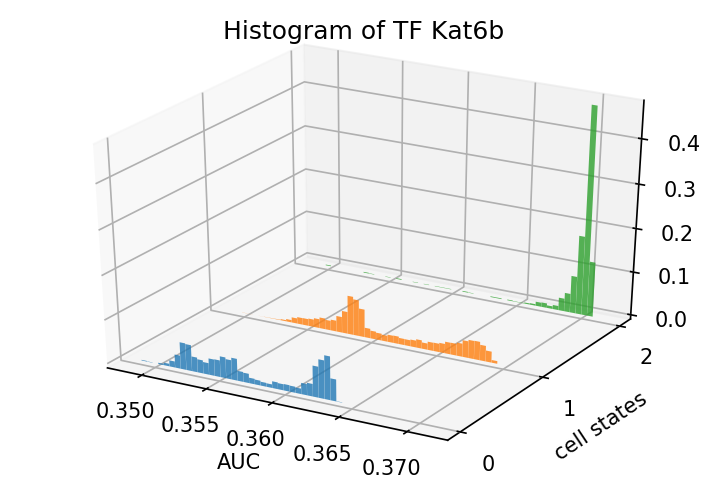

Hhex


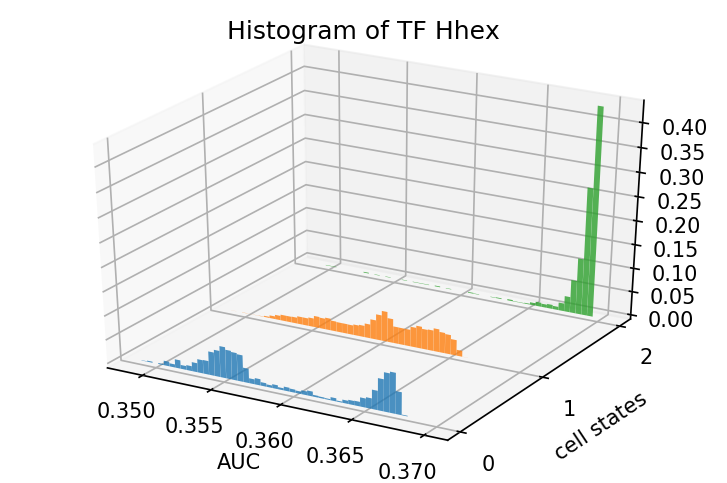

Etv6


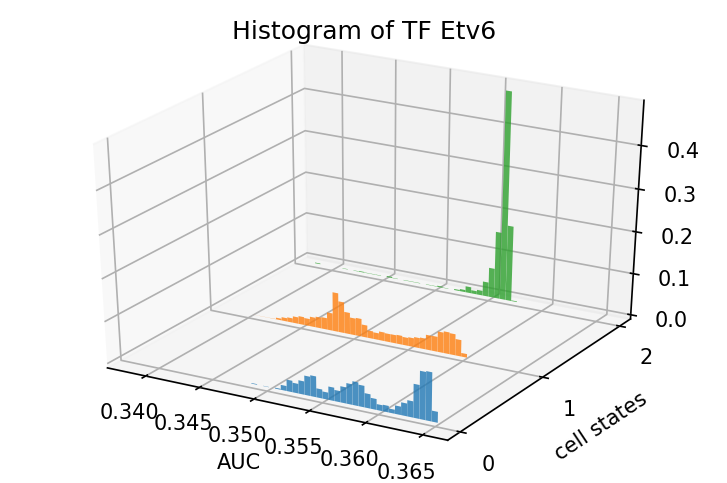

Atf1


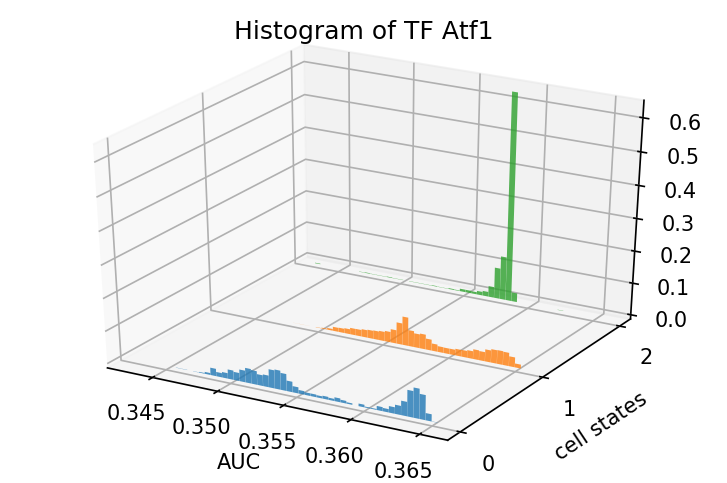

Nr4a1


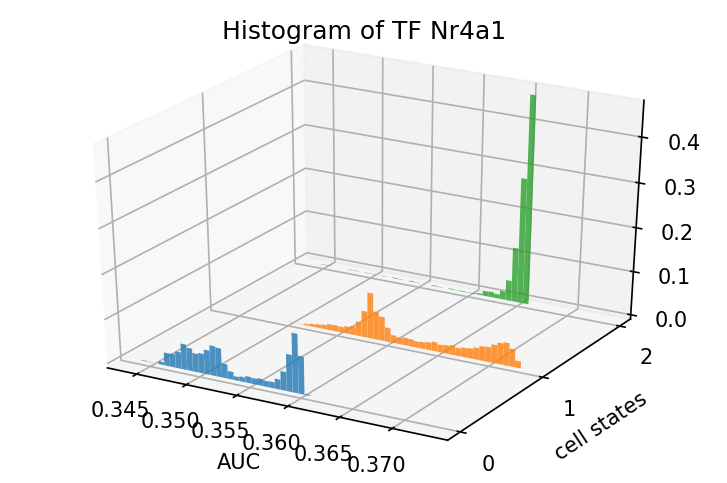

Nfe2


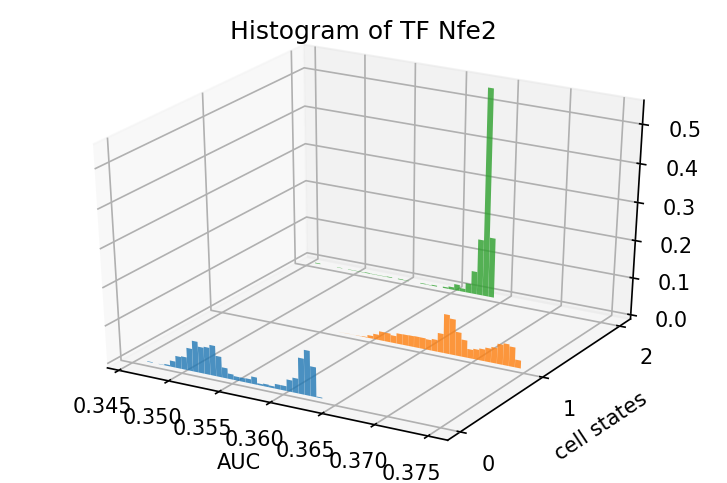

Mlxip


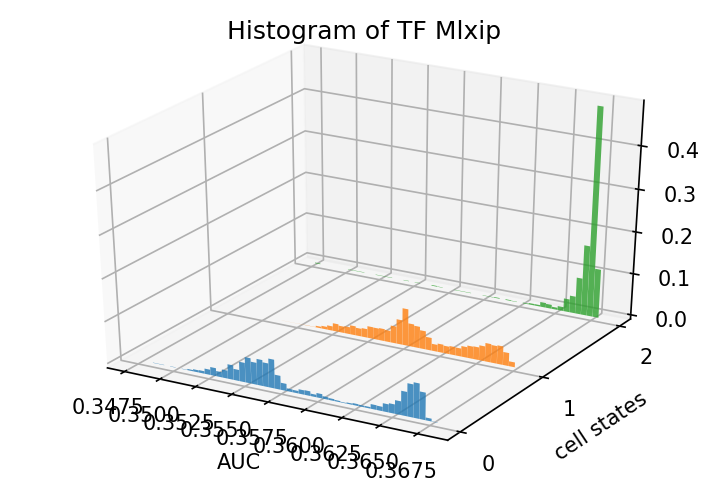

Elf1


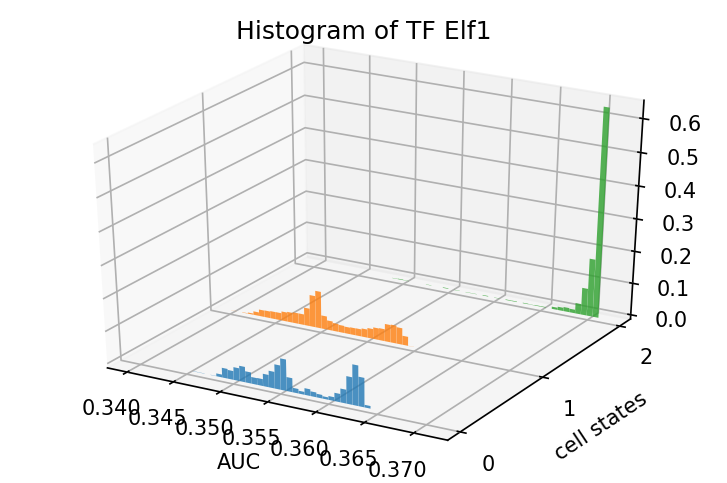

Tsc22d1


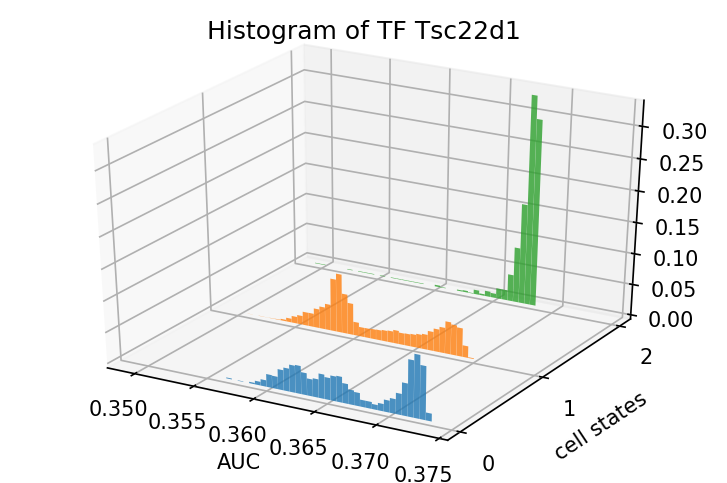

Tox4


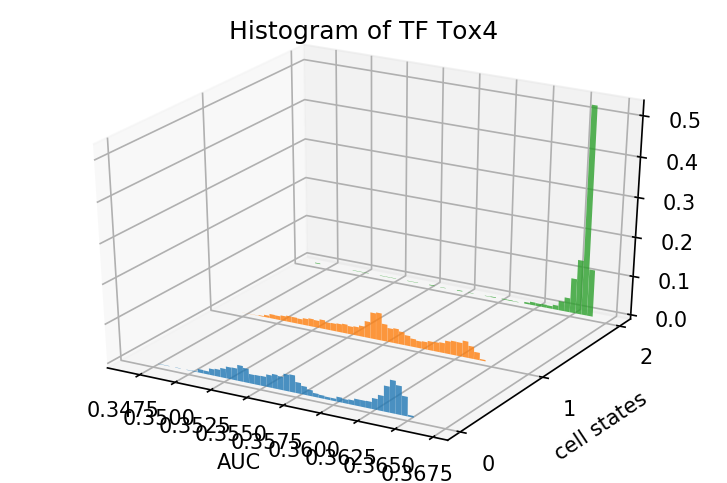

Max


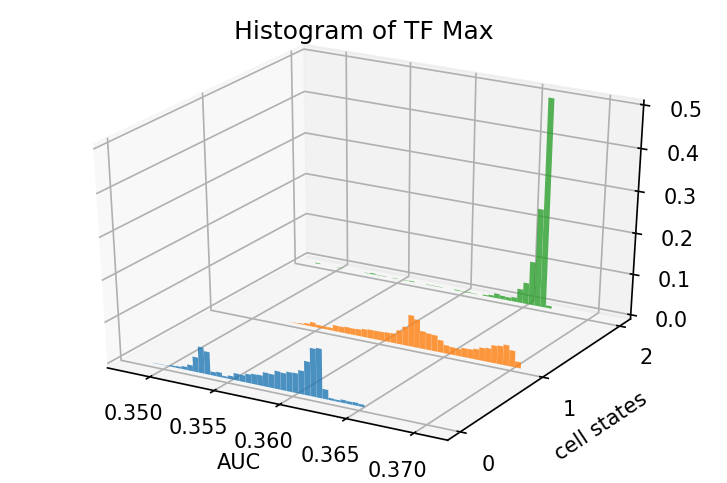

Fos


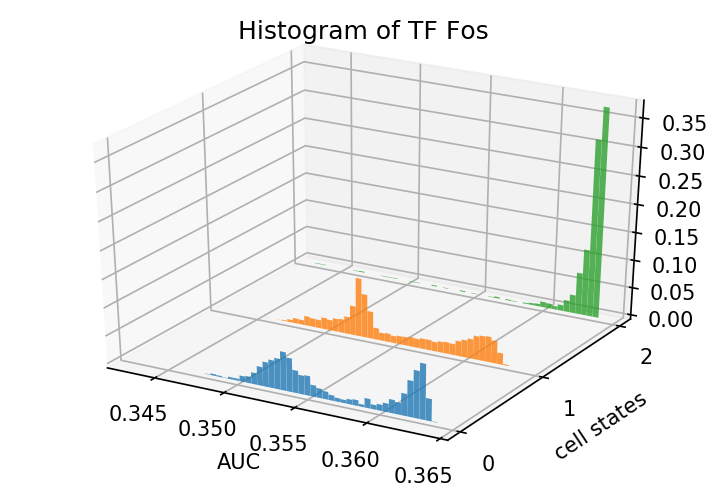

Foxn3


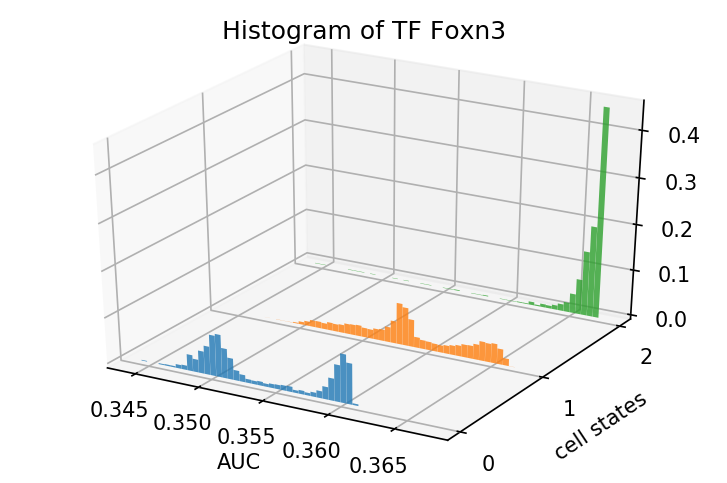

Yy1


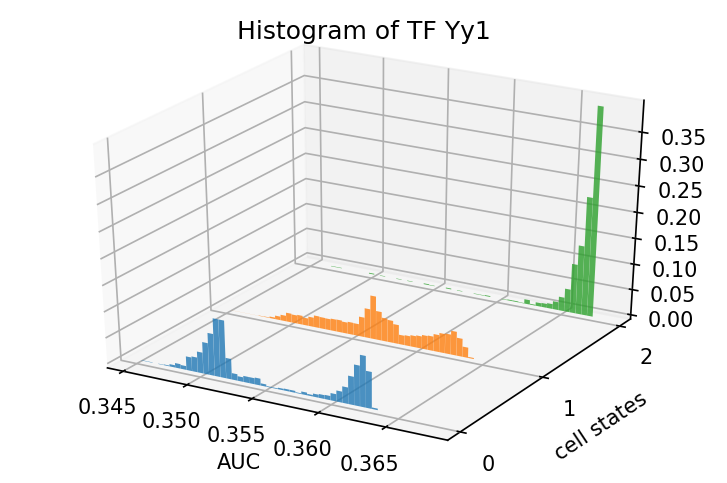

Tcf25


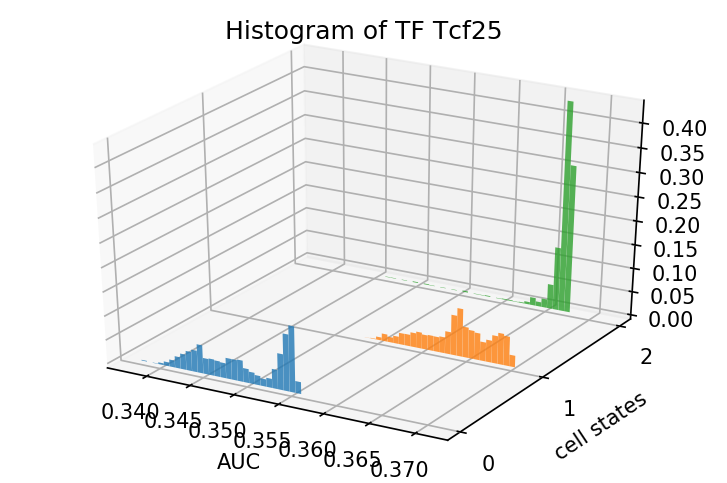

Ncor1


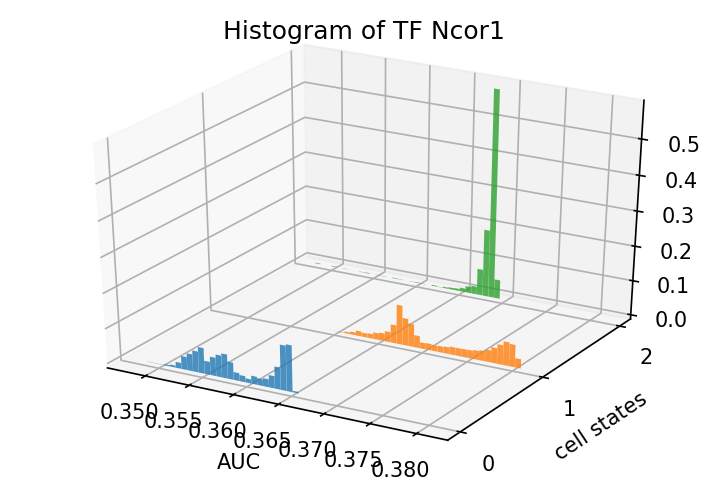

Smarce1


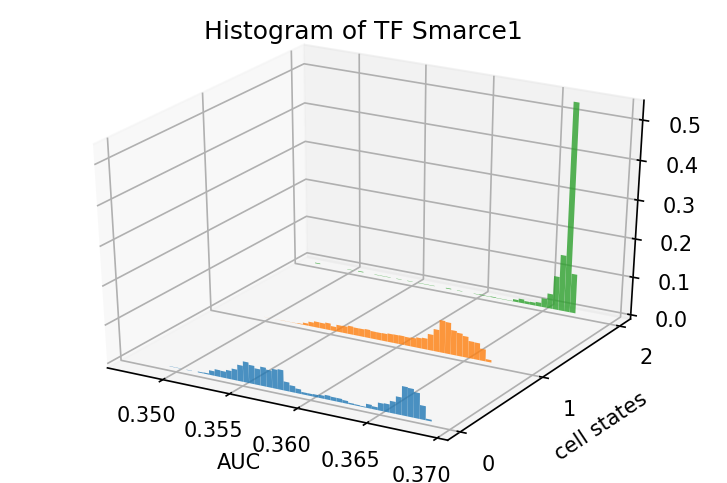

Stat3


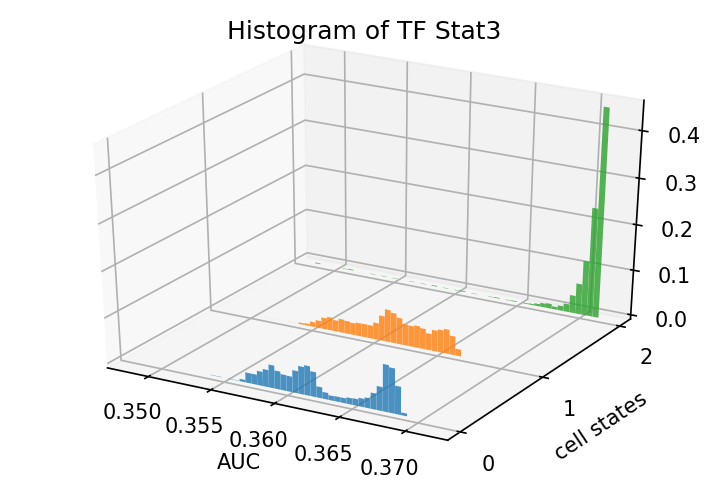

Hlf


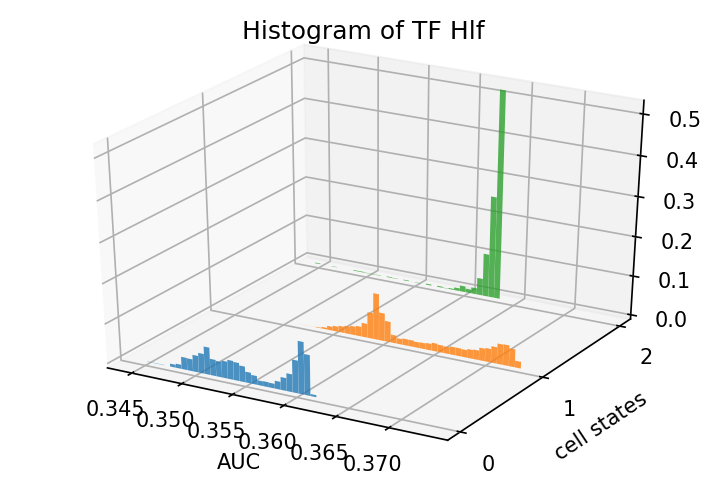

Znf521


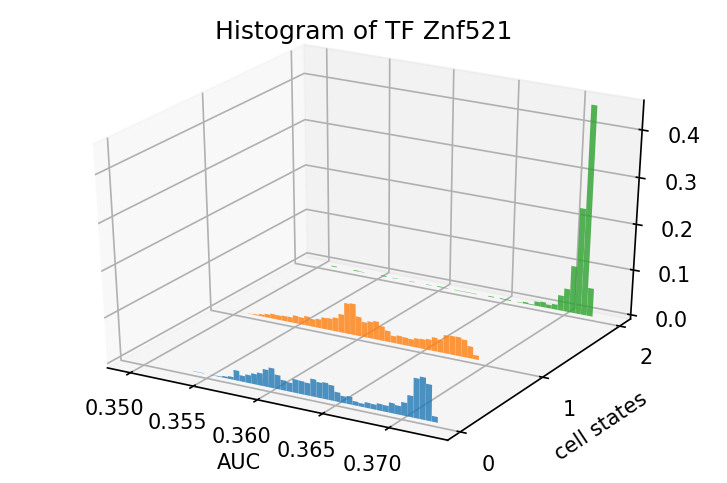

Id1


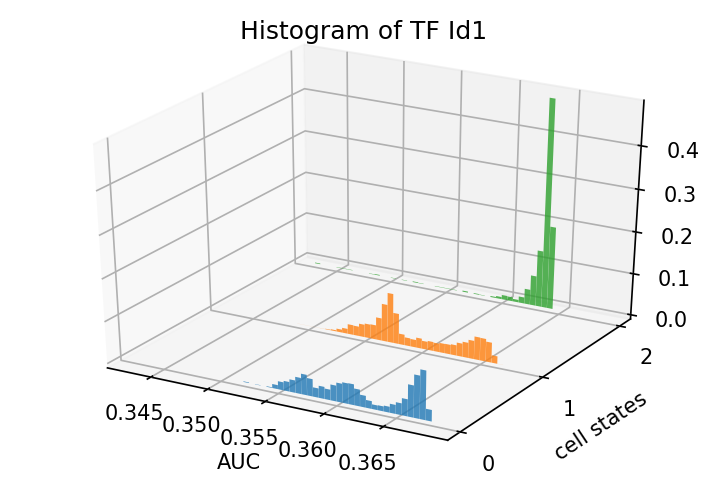

Tcf3


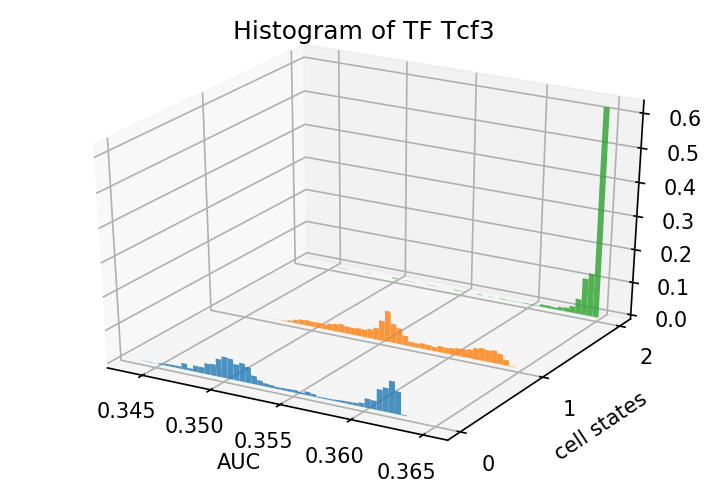

Hmg20b


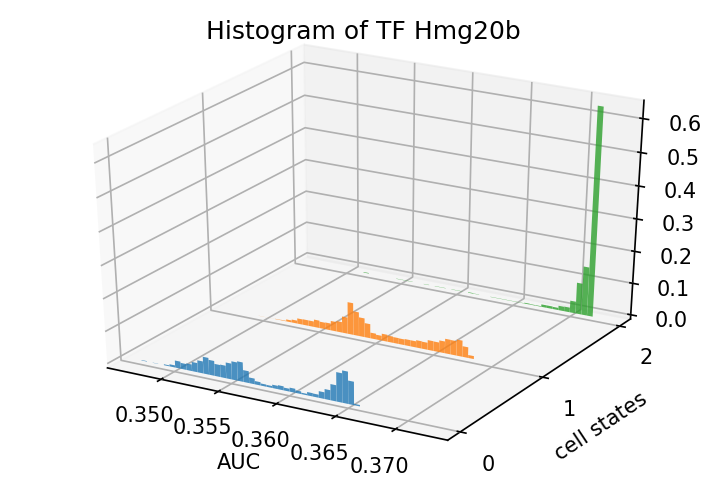

Znf562


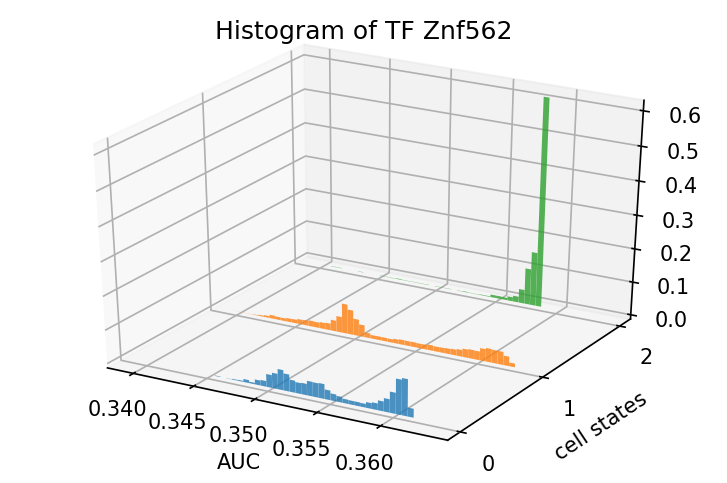

Dnmt1


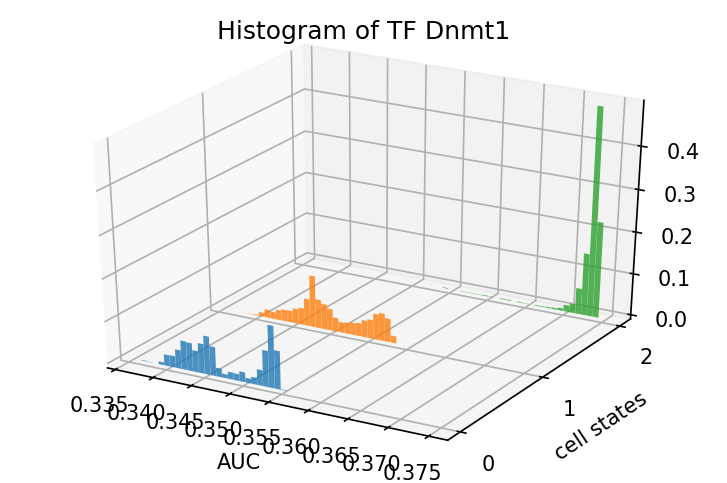

Junb


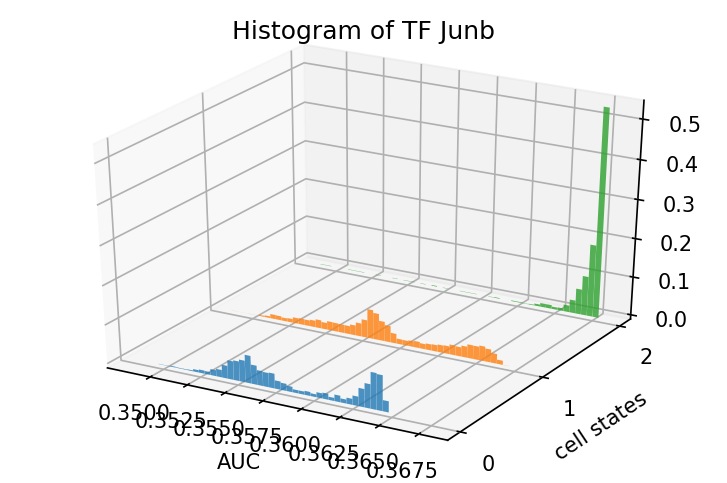

Klf2


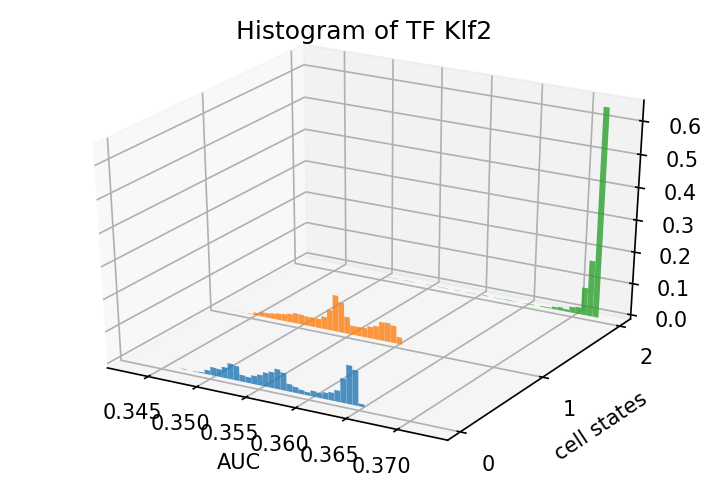

Jund


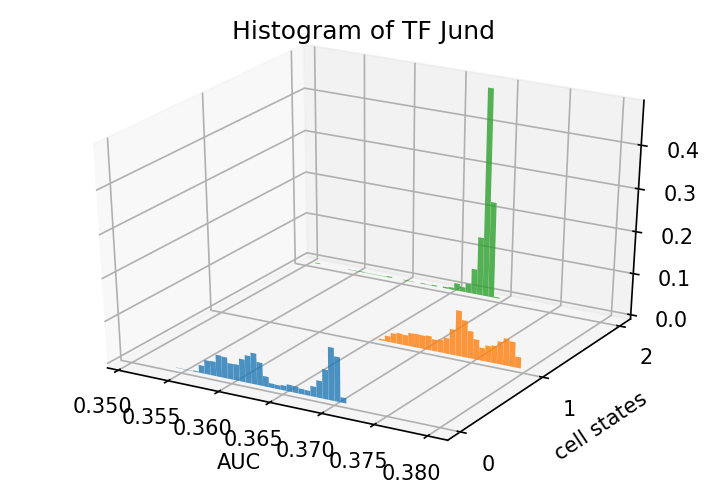

Rfxank


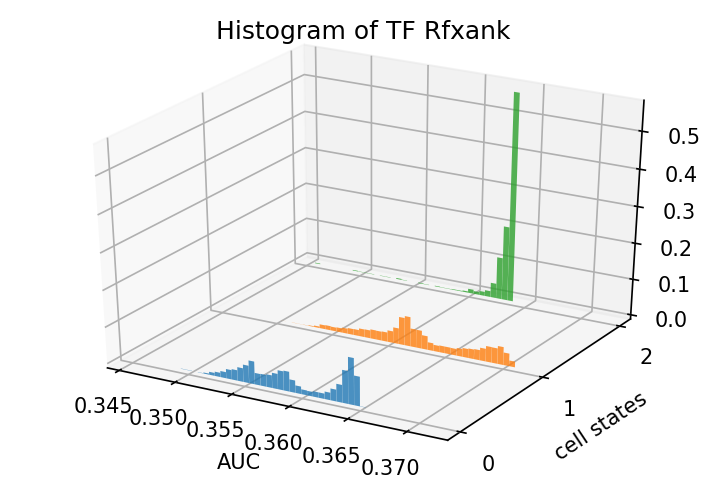

Znf90


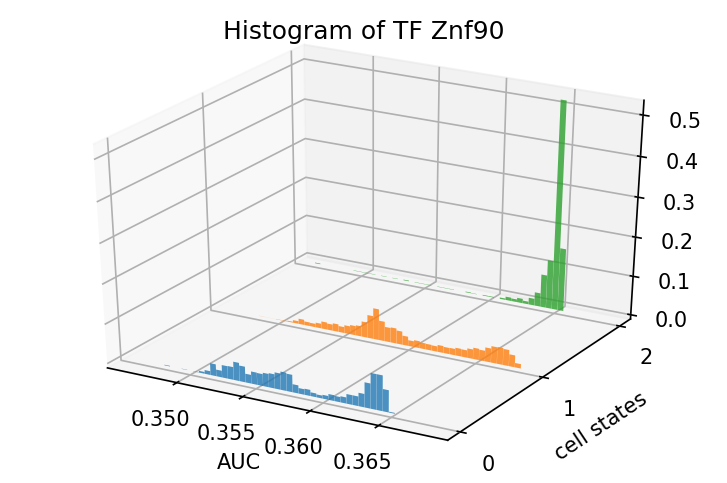

Znf431


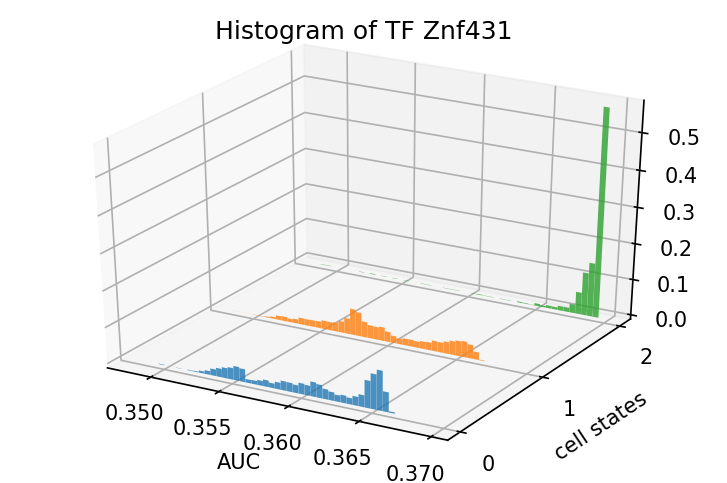

Znf302


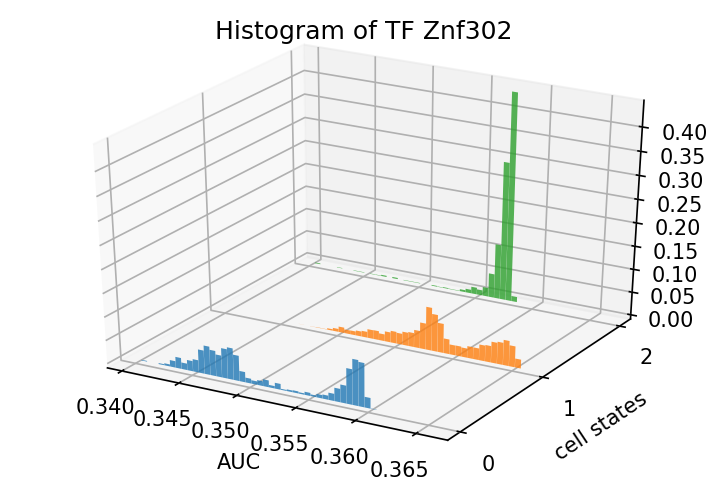

Nfkbid


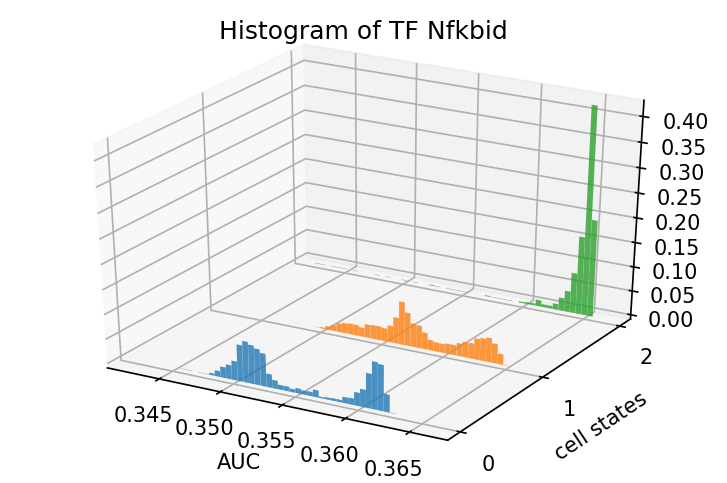

Fosb


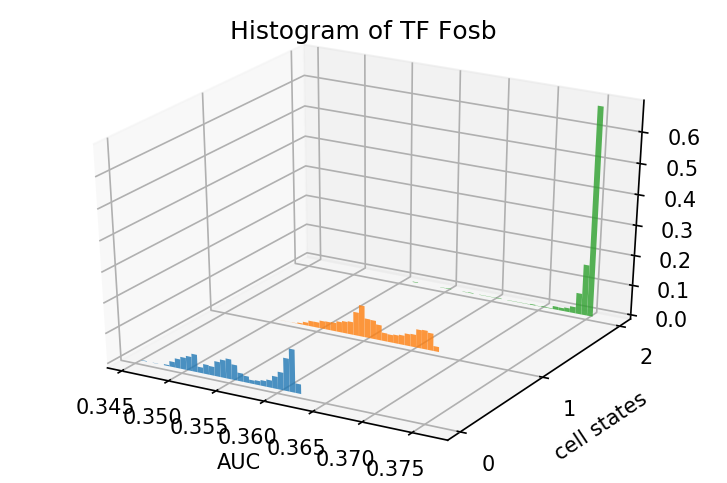

Znf581


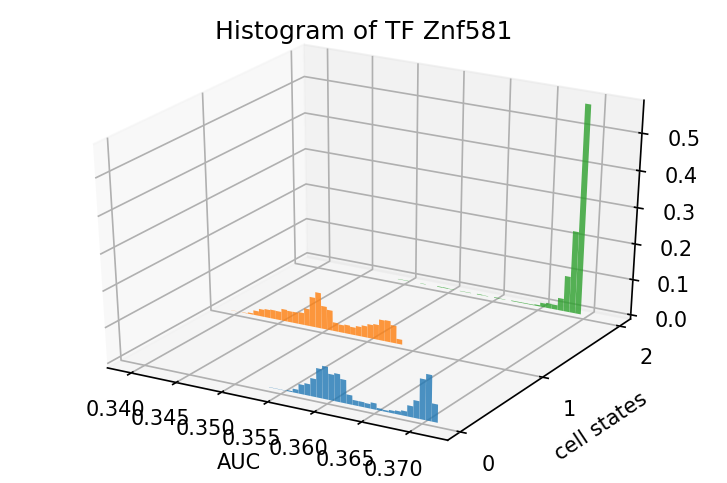

Znf814


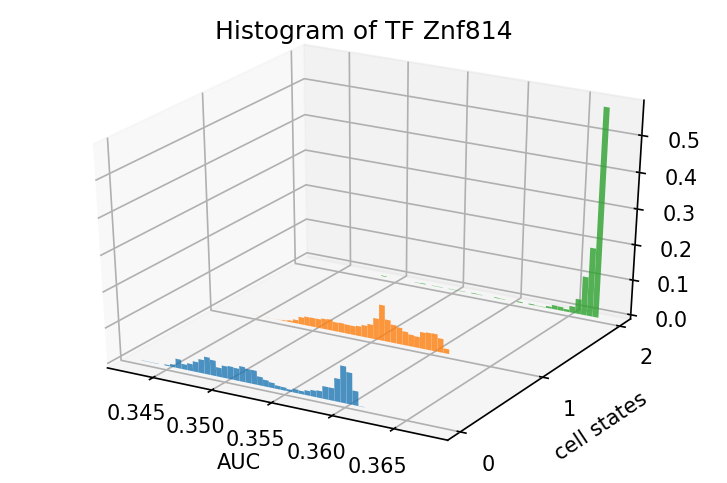

Xbp1


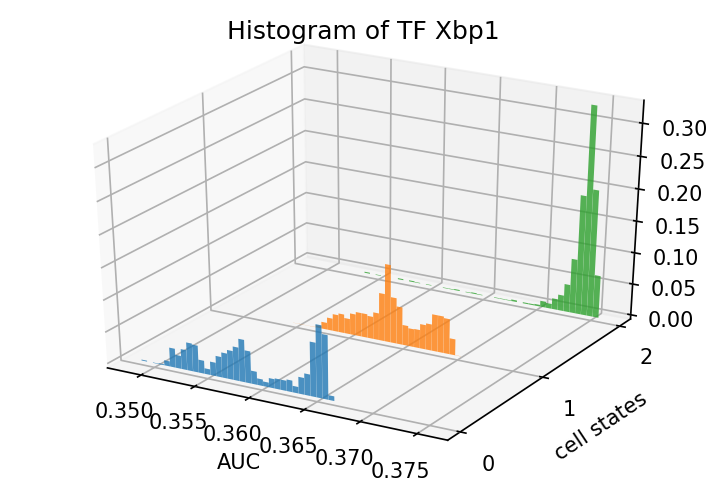

Atf4


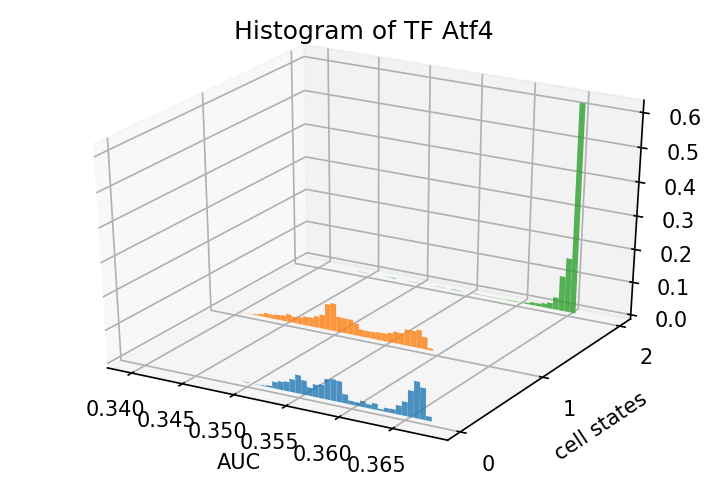

Phf5a


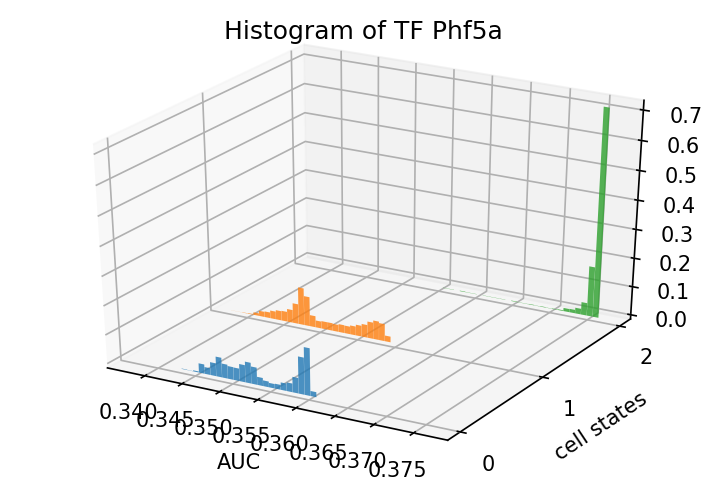

Runx1


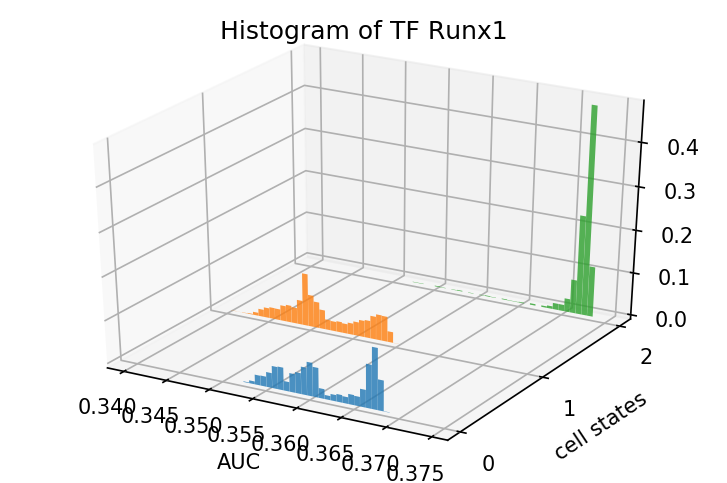

In [36]:
plot_histogram(TF_hist_dict_simic, AUC_dict[1].columns)

-----
# UMAP plot of imputed expression colorred in binarized AUC

In [37]:
import umap
%matplotlib inline

import pickle
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from functools import reduce
import numpy as np
import pandas as pd
import ipdb
import copy
import seaborn as sns

plt.rcParams['figure.dpi'] = 150

In [38]:
p2df = '/data/cima/hsc_DF_for_simic_100_2000_MAD.pickle'
# p2assign = '/data/jianhao/hepatocyte_update_dataset_101619/hepa_A249P_assign'

# assignment = []
# with open(p2assign, 'r') as f:
#     for line in f:
#         assignment.append(int(line))

df = pd.read_pickle(p2df)
# df = df.drop(columns = ['label'])
df

,PRDM16,HES2,ZBTB48,THAP3,RERE,CASZ1,PRDM2,ZBTB17,ZBTB40,ZNF436,...,TMEM106A,ACTN1,ACTR3,RPS6,RNPC3,TBCC,ITSN2,G6PD,NUDT22,AZU1
young_AAACGGGAGGACTGGT_193,0.039641,0.008891,0.039544,0.034047,0.049510,0.013580,0.040853,0.038933,0.016844,0.015725,...,0.045723,0.052693,0.102465,0.147814,0.039494,0.060932,0.064268,0.068093,0.057809,0.030696
young_AAAGCAATCTCCAACC_193,0.036926,0.008674,0.042193,0.040963,0.052448,0.013110,0.044673,0.044169,0.020737,0.014381,...,0.052070,0.064308,0.115012,0.157256,0.048519,0.069468,0.064354,0.073574,0.068858,0.037923
young_AACACGTAGGTGACCA_193,0.038818,0.009714,0.042902,0.039300,0.056894,0.017113,0.040805,0.041728,0.017629,0.017943,...,0.052329,0.068232,0.124474,0.155534,0.050464,0.068938,0.059345,0.076153,0.067321,0.047922
young_AACTCAGAGGGCTTGA_193,0.039023,0.010244,0.042341,0.038652,0.056440,0.017165,0.042073,0.041221,0.017797,0.017320,...,0.053889,0.066616,0.117604,0.154317,0.049215,0.067897,0.061168,0.075608,0.066192,0.044854
young_AACTCTTTCCAGGGCT_193,0.036410,0.009970,0.042181,0.041373,0.051926,0.014455,0.039432,0.041534,0.018510,0.015444,...,0.051182,0.061132,0.122416,0.156267,0.050002,0.068117,0.053862,0.076173,0.067875,0.042679
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
mds1_TTTGCGCGTGCAACTT_mds,0.024762,0.000256,0.034469,0.042875,0.045795,0.004929,0.027591,0.048286,0.018229,0.012158,...,0.049778,0.134657,0.135994,0.160784,0.080664,0.116196,0.117773,0.053039,0.065581,0.088116
mds1_TTTGCGCGTTCTGGTA_mds,0.025629,0.000279,0.035371,0.044117,0.047053,0.005082,0.028097,0.050180,0.018597,0.012017,...,0.051477,0.139827,0.139215,0.164119,0.081216,0.117051,0.118200,0.055136,0.068311,0.093602
mds1_TTTGTCAAGTGCCATT_mds,0.026624,0.000511,0.036619,0.045289,0.048573,0.005514,0.029526,0.052061,0.019382,0.011742,...,0.053133,0.142022,0.141461,0.167250,0.080587,0.116487,0.116728,0.057687,0.071263,0.096851
mds1_TTTGTCAAGTTGAGTA_mds,0.027997,0.000693,0.038271,0.047303,0.050760,0.005920,0.030549,0.055269,0.020433,0.011043,...,0.055667,0.148154,0.146012,0.172553,0.080571,0.117280,0.115965,0.061383,0.075646,0.104737


In [39]:
set(assign_list)

{0, 1, 2}

In [40]:
reducer = umap.UMAP()
embedding = reducer.fit_transform(df.values)
print(embedding.shape)

(9663, 2)


In [41]:
def umap_plot(embedding, assignment, title, n_states = None, cmap_name = 'Spectral'):
    if n_states == None:
        n_states = len(set(assignment))
    plt.figure(figsize = (4, 3))
    scatter = plt.scatter(embedding[:, 0], embedding[:, 1], c=assignment, 
                          cmap = plt.get_cmap(cmap_name), s = 5)
    plt.colorbar(boundaries=np.arange(n_states + 1) - 0.5).set_ticks(np.arange(n_states))
    plt.title(title)
    
    plt.grid(alpha = 0.5)
    plt.show()

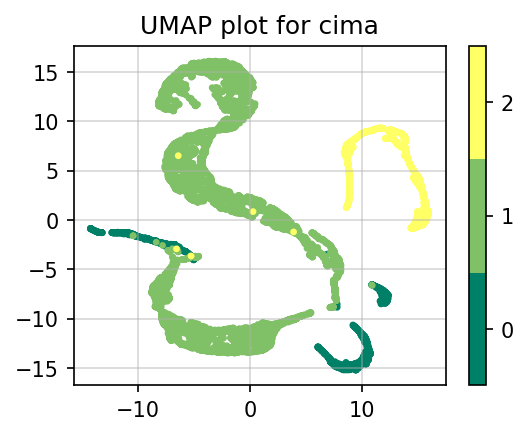

In [42]:
# n_states = len(set(assignment))
umap_plot(embedding, assign_list, 'UMAP plot for cima', cmap_name = 'summer')

# UMAP plots with RAW/Binarized AUC value for each cell


In [65]:
selected_gene = 'Znf33a'
# selected_gene = 'Nono'

In [66]:
def four_plots_together(embedding, df, assign_list, gene_name, cmap_name = 'summer'):
#     if n_states == None:
#         n_states = len(set(assignment))
    fig, axs = plt.subplots(2, 2, sharex = True, sharey = True, figsize = (6, 5))
    normalize = colors.Normalize(vmin = 0, vmax=1)
    
    # plot of true label.
    ax = axs[0, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=assign_list,
                          cmap = plt.get_cmap(cmap_name), 
                          s = 3, alpha = 0.6)
    n_states = len(set(assign_list))
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP of expression for {} states'.format(n_states)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False)
    
    # plot of normalized raw AUC value.
    ax = axs[0, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized)'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value.
    ax = axs[1, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar un-norm)'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of binarized AUC value.
    ax = axs[1, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['bin_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    n_states = 2
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP labeled by binarized AUC value \n of gene {}'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    plt.show()

Znf33a


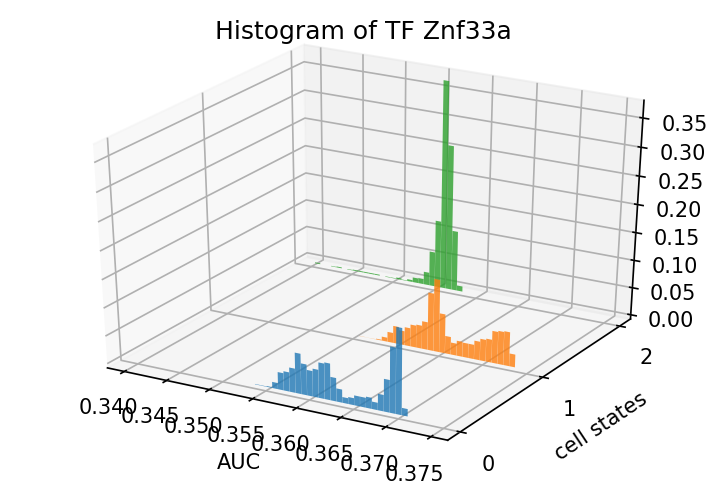

In [67]:
plot_histogram(TF_hist_dict_simic, [selected_gene])

In [68]:
with open(p2AUC_dict, 'rb') as f:
    AUC_dict_simic = pickle.load(f)
    AUC_dict_simic = separate_state(AUC_dict_simic)
AUC_dict_simic.keys()

dict_keys([0, 1, 2])

In [69]:
for idx in AUC_dict_simic.keys():
    print(idx)
    print(AUC_dict_simic[idx].shape)
    print('-' * 3) 

0
(1362, 100)
---
1
(7143, 100)
---
2
(1158, 100)
---


In [70]:
threshold = 0.4
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_simic.keys():
#     AUC_dict_simic[0].keys()
    binarized_label = (AUC_dict_simic[state][selected_gene.upper()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_simic[state][selected_gene.upper()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['raw_label'] = total_raw_label

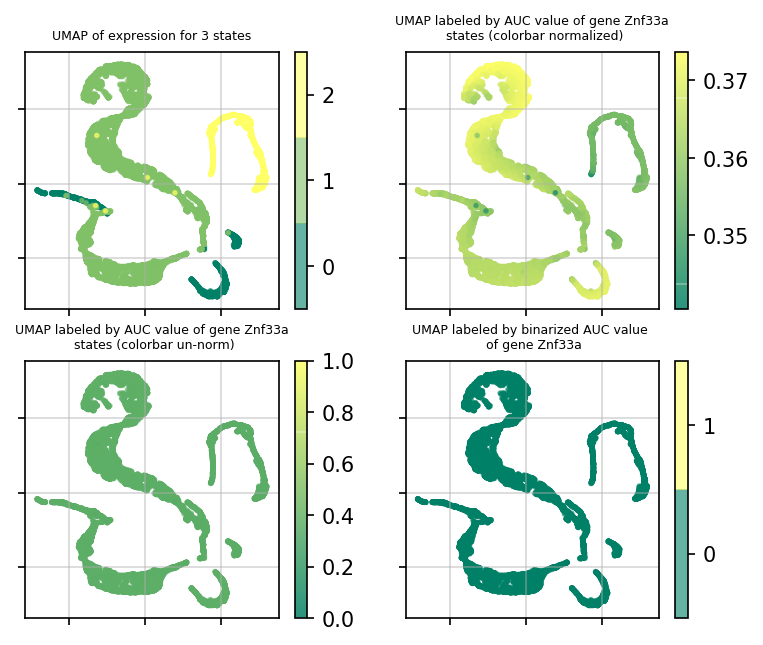

threshold =  0.4


In [71]:
four_plots_together(embedding, df, assign_list, selected_gene)
print('threshold = ', threshold)